# Road Network Extraction from High-Resolution Aerial Imagery  
**Group 3**  
Zain Abdullah Ahmad (27100215) • Hamid Ali Khan (27100156)

---

## Project Overview

**Objective:**  
Build a fully-automated deep-learning pipeline that turns raw aerial imagery into clean, topologically correct road graphs—ready for GPS navigation, urban planning, or GIS updates.

**Key Components:**  
1. **Segmentation**  
   - Stage 1 uses a state-of-the-art encoder–decoder network (Deep ResUNet → Deliverable 4 CBAM + Light-ASPP → Deliverable 5 Nested U-Net++ with Attention Gates) to produce a binary road mask at full spatial resolution.  
2. **Graph Extraction & Refinement**  
   - Stage 2 vectorizes the mask into centerlines and polylines, then applies the B-snake active-contour algorithm to yield smooth, topologically consistent road skeletons.

---

## Project Phases & Timeline (4 weeks)

| Week | Tasks                                                                                                 |
|:----:|:------------------------------------------------------------------------------------------------------|
| 1   | Dataset familiarization & **Massachusetts Roads** exploration • Preprocessing: 1500×1500 → 9 × 512×512 tiles |
| 2   | Baseline Deep ResUNet implementation • Qualitative review & metric baseline (IoU, F₁/F₂)                  |
| 3   | **Deliverable 4** prototype: add CBAM attention, Light-ASPP & combined BCE + Focal Dice + Boundary loss   |
| 4   | **Deliverable 5** final model: Nested U-Net++, Attention Gates, matched DS heads, Focal Tversky, dynamic Boundary schedule • Final evaluation & B-snake export |

---

## Dataset

We use the **Massachusetts Roads** public benchmark (MIT Lincoln Lab):  
- **Imagery:** 1500×1500 RGB orthophotos (∼1 m/pixel)  
- **Ground truth:** binary road masks  
- **Volume:** 1105 training / 13 test full images  

**Prototype subset:**  
- Tile each image into a 3×3 grid of 512×512 patches → ∼7240 tiles  
- Fix a 1000-tile train / 200-tile validation split for rapid ablation; full dataset retraining at the end

---

##  Baseline Model

**DeepResUNet** (ResNet encoder + U-Net decoder) with:  
- **Loss schedule:**  
  - Epochs 1–10: BCE + Dice + Boundary loss (edge warm-up)  
  - Epochs 11–end: BCE + Dice only  
- **Metrics:** IoU, Precision, Recall, F₁, F₂

This strong ResUNet reference establishes our starting point before adding attention, multi-scale context, and loss refinements.

---

## Deliverable 4 Prototype

We first bolstered DeepResUNet by integrating:  
- **CBAM attention modules** at each bottleneck to re-weight channel and spatial features, helping the network highlight road-relevant cues.  
- A **lightweight ASPP** block in the deepest layer to aggregate multi-dilation context—improving narrow and wide road detection alike.  
- A **combined loss** of Weighted BCE + Focal Dice + Boundary (warm-up) to handle class imbalance, sharpen edges, and focus on hard positives.

**Observations:**  
- Recall and boundary crispness increased—but at the cost of a surge in false positives and slightly distorted mask shapes.

---

## Deliverable 5 Final Model

To tame over-recall and recover finer details, we evolved the prototype into a **Nested U-Net++** with:  
- **Dense skip-paths** that fuse high-res encoder features at every depth, preserving detail across scales.  
- **Attention Gates** on each skip connection, so each decoder stage filters encoder features for relevance before fusion.  
- **Matched deep-supervision heads**, aligning auxiliary outputs to their corresponding feature channels for full gradient flow.  
- **Focal Tversky** (α=0.7, β=0.3) in place of Focal Dice, striking a better precision/recall balance.  
- A **dynamic boundary-loss schedule** (λ=1 epochs 1–10, then 0), letting us crisp up edges early but settle on coherent shapes later.  
- **CosineAnnealingLR** for smooth learning-rate decay and more stable convergence.

This final design delivers crisp yet accurate road masks—no longer flooded by over-recall—while maintaining strong IoU and balanced F₁/F₂ performance.



### Mount Drive & Unpack Dataset

We mount Google Drive to access the compressed Massachusetts Roads dataset and extract it into a local folder.


In [1]:
from google.colab import drive
import zipfile, os

drive.mount('/content/drive')
zip_path = '/content/drive/MyDrive/archive.zip'
extract_path = '/content/ma_road_dataset'
if not os.path.exists(extract_path):
    with zipfile.ZipFile(zip_path, 'r') as zip_ref:
        zip_ref.extractall(extract_path)
print(f"Dataset extracted to: {extract_path}")


Mounted at /content/drive
Dataset extracted to: /content/ma_road_dataset


### Load Metadata & Pair Images with Masks

We begin by importing the key libraries for data manipulation and image I/O, then read in the dataset’s CSV files (label mappings and image metadata) to support downstream analysis and any class-specific weighting. Next, we verify that the expected folder structure (`train`, `train_labels`, `val`, `val_labels`, etc.) is intact in the extracted TIFF directory.

We define a concise helper function, `get_image_mask_pairs`, that scans an image directory and matches each `.tiff` file with its corresponding mask (by filename), ensuring only valid pairs are collected. Finally, we assemble and report the total number of training + validation image–mask pairs, establishing our raw dataset size for the preprocessing pipeline.  


In [2]:
import pandas as pd
import numpy as np
import cv2
import os
from pathlib import Path
from PIL import Image

# Optional: Read CSVs for reference
label_class_dict = pd.read_csv(Path(extract_path)/'label_class_dict.csv')
metadata           = pd.read_csv(Path(extract_path)/'metadata.csv')

# Define base TIFF folder and subdirectories
base_tiff = Path(extract_path)/'tiff'
subdirs = ['train','train_labels','val','val_labels','test','test_labels']
for sd in subdirs:
    assert (base_tiff/sd).exists(), f"Missing subdir: {sd}"

# Helper to gather (image, mask) pairs

def get_image_mask_pairs(img_dir, mask_dir, img_ext='.tiff', mask_ext='.tif'):
    pairs = []
    for fn in sorted(os.listdir(img_dir)):
        if fn.lower().endswith(img_ext):
            img_p = img_dir/fn
            mask_p = mask_dir/fn.replace(img_ext, mask_ext)
            if mask_p.exists():
                pairs.append((img_p, mask_p))
    return pairs

train_pairs = get_image_mask_pairs(base_tiff/'train', base_tiff/'train_labels')
val_pairs   = get_image_mask_pairs(base_tiff/'val',   base_tiff/'val_labels')
train_val_pairs = train_pairs + val_pairs
print(f"Raw train+val pairs: {len(train_pairs)} + {len(val_pairs)} = {len(train_val_pairs)}")

Raw train+val pairs: 1108 + 14 = 1122


### Filter Out Samples with Excessive White Areas

To ensure we train on clear, informative imagery and avoid corrupted or overexposed samples (e.g., clouds, glare, sensor artifacts), we apply a simple white-patch filter:

1. **White-Patch Detection:**  
   - Convert each image to RGB and flag pixels where all channels exceed a high intensity threshold (`>=240`).  
   - Compute the **white-patch ratio** as the fraction of such bright pixels.

2. **Overlap Check:**  
   - Load the corresponding mask and check if any road pixels coincide with these white patches.  
   - If both the white-patch ratio exceeds our small tolerance (`TH = 0.01`) and there is overlap with the mask, we mark the pair as unreliable.

3. **Filtering & Summary:**  
   - Retain only the “good” pairs for downstream processing, storing them in `filtered_pairs`.  
   - Print counts of total vs. kept vs. filtered samples to track data reduction.

4. **Visualization:**  
   - Plot a histogram of all white-patch ratios to inspect the overall noise distribution.  
   - Display the top 10 worst offenders (highest ratios) side by side with their masks to qualitatively verify our filtering criterion.

This filtering step improves the quality of our training set, helping the model focus on valid road features without being distracted by spurious bright regions.


Total pairs: 1122, Kept: 742, Filtered-out: 380


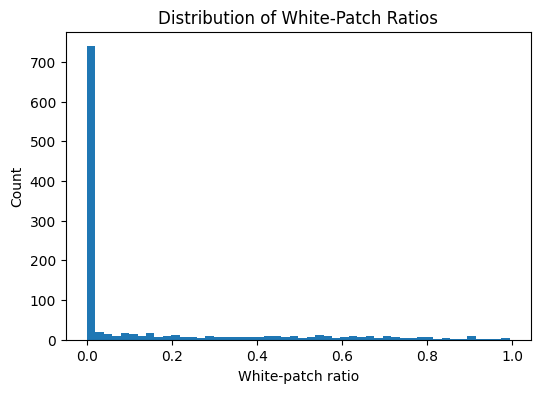

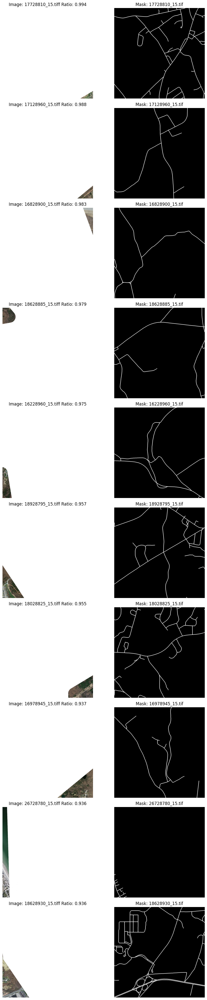

In [3]:
import matplotlib.pyplot as plt
import numpy as np
from pathlib import Path
from PIL import Image

# fuunction to compute white-patch mask and ratio
def white_mask_and_ratio(img_path, thresh=240):
    img = np.array(Image.open(img_path).convert('RGB'))
    white_mask = np.all(img >= thresh, axis=-1)
    ratio = white_mask.mean()
    return white_mask, ratio, img

# Threshold and containers
TH = 0.01  # white-patch ratio threshold
good_pairs = []
out_list = []  # will store tuples (img_path, mask_path, ratio)
all_ratios = []

# Filter: poor samples have ratio > TH AND mask overlaps white area
for img_p, mask_p in train_val_pairs:
    w_mask, r, _ = white_mask_and_ratio(img_p)
    mask_arr = np.array(Image.open(mask_p).convert('L')) > 127
    overlap = np.logical_and(w_mask, mask_arr).any()
    if r > TH and overlap:
        out_list.append((img_p, mask_p, r))
    else:
        good_pairs.append((img_p, mask_p))
    all_ratios.append(r)

# Summary
total = len(train_val_pairs)
print(f"Total pairs: {total}, Kept: {len(good_pairs)}, Filtered-out: {len(out_list)}")

# Set filtered_pairs for downstream cells
filtered_pairs = good_pairs

# Plot histogram of all white-patch ratios
plt.figure(figsize=(6,4))
plt.hist(all_ratios, bins=50)
plt.xlabel('White-patch ratio')
plt.ylabel('Count')
plt.title('Distribution of White-Patch Ratios')
plt.show()

# Select top 10 worst by highest ratio.
out_list_sorted = sorted(out_list, key=lambda x: x[2], reverse=True)
top_out = out_list_sorted[:10]

# Visualize the top 10 worst filtered-out images alongside their masks
n = len(top_out)
fig, axes = plt.subplots(n, 2, figsize=(10, 4*n))
if n == 1:
    axes = np.expand_dims(axes, 0)
for idx, (img_p, mask_p, r) in enumerate(top_out):
    #Satellite image
    img_disp = np.array(Image.open(img_p).convert('RGB'))
    axes[idx, 0].imshow(img_disp)
    axes[idx, 0].set_title(f'Image: {Path(img_p).name} Ratio: {r:.3f}')
    axes[idx, 0].axis('off')
    #Corresponding mask
    mask_disp = np.array(Image.open(mask_p).convert('L'))
    axes[idx, 1].imshow(mask_disp, cmap='gray')
    axes[idx, 1].set_title(f'Mask: {Path(mask_p).name}')
    axes[idx, 1].axis('off')
plt.tight_layout()
plt.show()

### Tiling Images and Masks into 512×512 Patches

To efficiently train on high-resolution aerial images within GPU memory constraints and increase the effective dataset size, we split each 1536×1536 image (and its corresponding mask) into a fixed 3×3 grid of 512×512 patches:

1. **Directory Setup**  
   Create separate folders for the training/validation tiles (`trainval_fixed`) and test tiles (`test_fixed`), each containing subfolders for `images` and `masks`.

2. **Tiling Function**  
   - Resize every original image and mask to a uniform 1536×1536 resolution.  
   - Slide a 512×512 window in a 3×3 grid (top–left to bottom–right), extracting both the RGB patch and its binary mask.  
   - Save each tile pair with a deterministic filename (`<original_stem>_ij.png`) so that downstream splits and loaders remain reproducible.

3. **Benefits**  
   - **Memory & Batch Sizes:** Smaller patches fit more easily on GPU, allowing larger batch sizes.  
   - **Data Augmentation:** Each tile can be independently augmented at runtime, reducing overfitting.  
   - **Training Efficiency:** More “samples” per epoch improves stochastic gradient estimation and speeds up convergence.

*After running this cell, you will see `9×` more training/validation and test samples on disk, ready for loader construction.*  


In [4]:
from pathlib import Path

# Output directories
out_root = Path('/content/preprocessed_tiles')
for split in ['trainval_fixed','test_fixed']:
    for kind in ['images','masks']:
        (out_root/split/kind).mkdir(parents=True, exist_ok=True)

FIXED = 1536
TILE  = 512

def tile_image_mask(img_arr, mask_arr, prefix, split='trainval_fixed'):
    tiles = []
    # 3×3 fixed grid
    for i in range(3):
        for j in range(3):
            x0, y0 = i*TILE, j*TILE
            tile_img  = img_arr[x0:x0+TILE, y0:y0+TILE]
            tile_mask = mask_arr[x0:x0+TILE, y0:y0+TILE]
            tiles.append((tile_img, tile_mask, f"{prefix}_{i}{j}"))
    # Save tiles
    for tile_img, tile_mask, name in tiles:
        cv2.imwrite(str(out_root/split/'images'/f"{name}.png"), cv2.cvtColor(tile_img, cv2.COLOR_RGB2BGR))
        cv2.imwrite(str(out_root/split/'masks'/f"{name}.png"), tile_mask)

# Process train+val
for img_p, mask_p in filtered_pairs:
    base = Path(img_p).stem
    img  = np.array(Image.open(img_p).convert('RGB').resize((FIXED, FIXED)))
    msk  = np.array(Image.open(mask_p).convert('L').resize((FIXED, FIXED)))
    tile_image_mask(img, msk, base, split='trainval_fixed')

# Process test
test_pairs = get_image_mask_pairs(base_tiff/'test', base_tiff/'test_labels')
for img_p, mask_p in test_pairs:
    base = Path(img_p).stem
    img  = np.array(Image.open(img_p).convert('RGB').resize((FIXED, FIXED)))
    msk  = np.array(Image.open(mask_p).convert('L').resize((FIXED, FIXED)))
    tile_image_mask(img, msk, base, split='test_fixed')

print("Tiling complete.")

Tiling complete.


### Verifying Tiling: Original vs. 512×512 Patches

In this step, we visually confirm that our tiling procedure correctly preserves both image content and mask alignment:

1. **Original Sample Display**  
   - We pick the first “good” image–mask pair and resize them back to the fixed 1536×1536 grid.  
   - Side-by-side visualization helps us ensure that the resizing step has not introduced distortions.

2. **Tiled Patch Visualization**  
   - We load the 3×3 grid of 512×512 tiles generated for this same sample.  
   - Arrange the 9 image patches and their corresponding masks in a 3-row, 6-column layout: each row shows an image tile next to its mask.  
   - This sanity check verifies that each patch retains correct spatial correspondence between the RGB imagery and binary mask, and that no artifacts were introduced during cropping or saving.

By inspecting this mosaic, we gain confidence that our preprocessing pipeline accurately partitions the high-resolution data into model-ready subimages.  


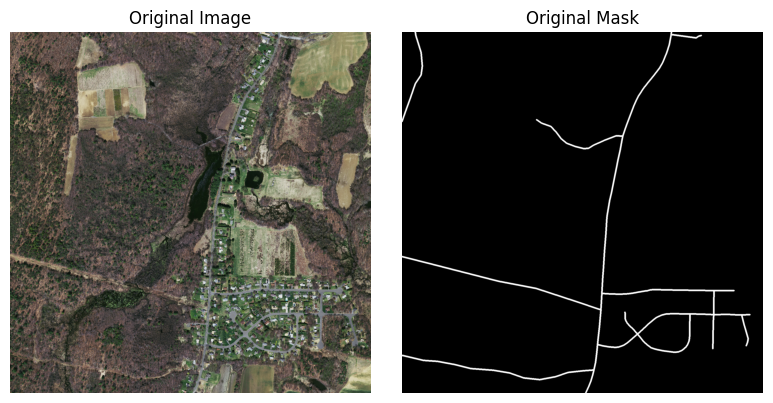

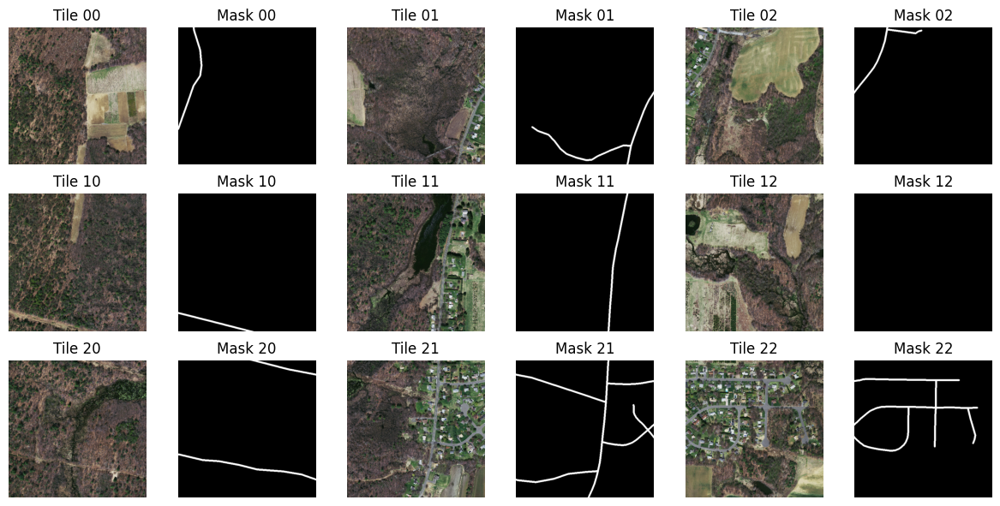

In [5]:
import matplotlib.pyplot as plt
import numpy as np
from pathlib import Path
from PIL import Image

# Select first good sample
sample_img_p, sample_mask_p = filtered_pairs[0]
prefix = Path(sample_img_p).stem

# Load and resize original image and its mask
target_size = (FIXED, FIXED)
orig_img = np.array(Image.open(sample_img_p).convert('RGB').resize(target_size))
orig_mask = np.array(Image.open(sample_mask_p).convert('L').resize(target_size))

# Display original image and mask side by side
plt.figure(figsize=(8,4))
plt.subplot(1,2,1)
plt.imshow(orig_img)
plt.title('Original Image')
plt.axis('off')
plt.subplot(1,2,2)
plt.imshow(orig_mask, cmap='gray')
plt.title('Original Mask')
plt.axis('off')
plt.tight_layout()
plt.show()

# load tiled images and masks
img_tiles_dir  = out_root/'trainval_fixed'/'images'
mask_tiles_dir = out_root/'trainval_fixed'/'masks'
tiles = []
for i in range(3):
    for j in range(3):
        tile_name = f"{prefix}_{i}{j}.png"
        tile_img  = np.array(Image.open(img_tiles_dir/tile_name))
        tile_mask = np.array(Image.open(mask_tiles_dir/tile_name).convert('L'))
        tiles.append((tile_img, tile_mask, f"{i}{j}"))

# Plot 3×3 grid of tiles and masks side by side in 3 rows, 6 columns
fig, axes = plt.subplots(3, 6, figsize=(12, 6))
for idx, (t_img, t_mask, name) in enumerate(tiles):
    r, c = divmod(idx, 3)
    # image
    axes[r, 2*c].imshow(t_img)
    axes[r, 2*c].set_title(f'Tile {name}')
    axes[r, 2*c].axis('off')
    # mask
    axes[r, 2*c+1].imshow(t_mask, cmap='gray')
    axes[r, 2*c+1].set_title(f'Mask {name}')
    axes[r, 2*c+1].axis('off')
plt.tight_layout()
plt.show()

### Creating Train/Validation Splits from Tiled Dataset

In this cell, we prepare our tiled images and masks for model training by:

1. **Gathering File Paths**  
   - Use `glob` to collect and sort all 512×512 image tiles under `trainval_fixed/images`.  
   - Derive the corresponding mask paths by a simple string replacement, ensuring each image–mask pair remains aligned.

2. **Randomized, Reproducible Split**  
   - Employ `sklearn.model_selection.train_test_split` to partition the full set of tiles into a training set (85%) and a validation set (15%).  
   - A fixed `random_state=42` ensures that our splits are deterministic, facilitating consistent results across experiments.

3. **Sanity Check**  
   - Print the number of tiles in each split to verify that the intended proportions (≈85/15) are achieved before proceeding to data loading and augmentation.

This split strategy balances ample training data with a held-out validation subset, enabling reliable monitoring of model generalization during development.


In [6]:
from glob import glob
all_imgs  = sorted(glob(str(out_root/'trainval_fixed/images/*.png')))
all_masks = [p.replace('images','masks') for p in all_imgs]
from sklearn.model_selection import train_test_split
train_imgs, val_imgs, train_msks, val_msks = train_test_split(
    all_imgs, all_masks, test_size=0.15, random_state=42
)
print(f"Tiles: Train = {len(train_imgs)}, Val = {len(val_imgs)}")

Tiles: Train = 5676, Val = 1002


### Data Augmentation & DataLoader Construction

In this cell, we configure our data pipeline to efficiently feed augmented image–mask pairs into the model:

1. **Augmentation Pipelines**  
   - **Training Transform (`train_tf`)**  
     - Random flips (horizontal & vertical) and rotations (90° or 270°) to expose the model to varied orientations.  
     - Brightness/contrast jittering to improve robustness under different lighting.  
     - Standard ImageNet normalization followed by conversion to PyTorch tensors.  
   - **Validation Transform (`val_tf`)**  
     - Only normalization and tensor conversion, ensuring that validation performance reflects model generalization rather than augmentation artifacts.

2. **Custom Dataset Class (`RoadDataset`)**  
   - Lazily loads an RGB image and its corresponding binary mask.  
   - Applies the specified `transform` to produce a normalized, batched tensor pair.  
   - Masks are thresholded at 0.5 to produce a float32 tensor suitable for loss computation.

3. **DataLoader Instantiation**  
   - Batch size set to 4 to balance GPU memory use and statistical stability.  
   - Shuffling enabled in training loader for random sampling, disabled in validation for repeatability.  
   - `num_workers=2` leverages background threads for data I/O and on-the-fly augmentation.

By encapsulating augmentation and batching logic here, the subsequent training loop can remain concise and focused purely on model optimization.


In [7]:
import torch
from torch.utils.data import Dataset, DataLoader
import albumentations as A
from albumentations.pytorch import ToTensorV2

train_tf = A.Compose([
    A.HorizontalFlip(p=0.5),
    A.VerticalFlip(p=0.5),
    A.OneOf([A.Rotate(90), A.Rotate(270)], p=1.0),
    A.RandomBrightnessContrast(brightness_limit=0.5,p=0.5),
    A.Normalize(mean=(0.485,0.456,0.406),std=(0.229,0.224,0.225)),
    ToTensorV2()
])
val_tf = A.Compose([
    A.Normalize(mean=(0.485,0.456,0.406),std=(0.229,0.224,0.225)),
    ToTensorV2()
])

class RoadDataset(Dataset):
    def __init__(self, imgs, msks, transform=None):
        self.imgs  = imgs
        self.msks  = msks
        self.tf    = transform
    def __len__(self): return len(self.imgs)
    def __getitem__(self, idx):
        img = np.array(Image.open(self.imgs[idx]).convert('RGB'))
        msk = (np.array(Image.open(self.msks[idx]).convert('L')) > 127).astype('float32')
        if self.tf:
            aug = self.tf(image=img, mask=msk)
            return aug['image'], aug['mask']
        return torch.tensor(img).permute(2,0,1)/255.0, torch.tensor(msk)

batch_size = 4
train_loader = DataLoader(RoadDataset(train_imgs, train_msks, train_tf), batch_size=batch_size, shuffle=True, num_workers=2)
val_loader   = DataLoader(RoadDataset(val_imgs,   val_msks,   val_tf),   batch_size=batch_size, shuffle=False, num_workers=2)
print("DataLoaders ready.")

DataLoaders ready.


### Fixed Subset Sampling for Rapid Prototyping

To accelerate experimentation and reduce turnaround time, we create small, reproducible subsets of our full training/validation splits:

1. **Deterministic Sampling**  
   - We fix the random seed (`random.seed(42)`) so that the same images are chosen on each run, ensuring comparability across experiments.  
2. **Subset Sizes**  
   - Up to **1,000** training tiles and **200** validation tiles are selected (or fewer if not enough data).  
3. **Mask Alignment**  
   - For each sampled image path, we look up the corresponding mask in the original lists to preserve correct image–mask pairing.  
4. **Dedicated DataLoaders**  
   - We reuse the same augmentation (`train_tf`) and normalization (`val_tf`) pipelines, along with the original batch size, to construct two new `DataLoader` instances (`subset_train_loader` and `subset_val_loader`).  
   - Shuffling remains enabled for the training subset loader to maintain randomness, while the validation loader stays deterministic.

By operating on this smaller “fast track” subset, we can iterate quickly on architectural tweaks and loss formulations before scaling back up to the full dataset for final evaluation.


In [8]:
# SUBSET FOR FAST PROTOTYPING
import random
# fix seed for reproducibility
random.seed(42)

# select a fixed subset: 1000 train, 200 val (or fewer if not enough)
subset_train = random.sample(train_imgs, min(1000, len(train_imgs)))
subset_val   = random.sample(val_imgs,   min(200,  len(val_imgs)))

# corresponding mask lists
subset_train_msks = [train_msks[train_imgs.index(p)] for p in subset_train]
subset_val_msks   = [val_msks[val_imgs.index(p)]     for p in subset_val]

# create subset DataLoaders
subset_batch_size = batch_size  # same as original
subset_train_loader = DataLoader(
    RoadDataset(subset_train, subset_train_msks, train_tf),
    batch_size=subset_batch_size, shuffle=True, num_workers=2
)
subset_val_loader   = DataLoader(
    RoadDataset(subset_val,   subset_val_msks,   val_tf),
    batch_size=subset_batch_size, shuffle=False, num_workers=2
)

print(f"Subset DataLoaders ready: {len(subset_train)} train tiles: {len(subset_val)} val tiles")

Subset DataLoaders ready: 1000 train tiles: 200 val tiles


### Visualizing Sample Batches with Inverse Normalization

To verify our preprocessing and augmentation pipeline, we display a few raw image–mask pairs from the training `DataLoader`:

1. **Inverse Normalization (`denorm`)**  
   - Since inputs have been normalized to ImageNet statistics, we apply a simple inverse transform to bring pixel values back into the `[0,1]` range for display.  
2. **Batch Inspection**  
   - We plot up to 4 samples from a single training batch.  
   - The top row shows the RGB inputs after de-normalization, and the bottom row shows their corresponding binary masks.  
3. **Purpose**  
   - Quick visual sanity check that augmentations (flips, rotations, brightness adjustments) and mask thresholds are correctly applied and aligned.  


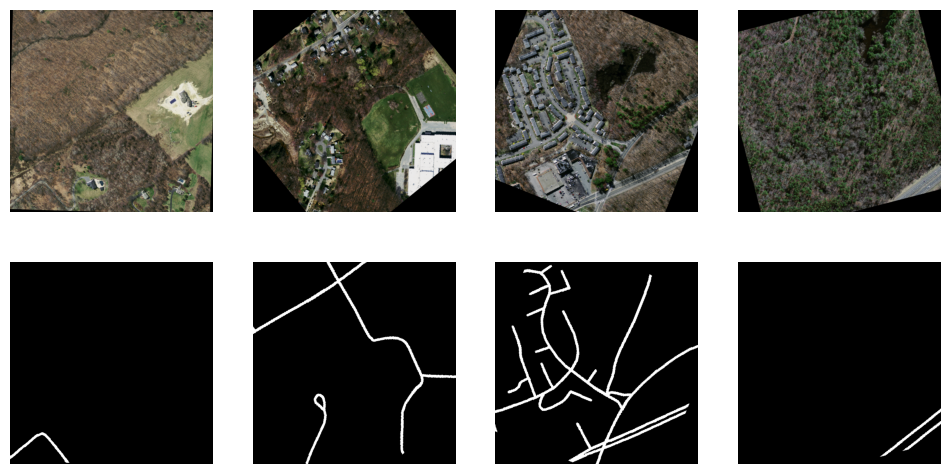

In [9]:
import matplotlib.pyplot as plt

def denorm(x):
    mean = torch.tensor([0.485,0.456,0.406]).view(3,1,1)
    std  = torch.tensor([0.229,0.224,0.225]).view(3,1,1)
    return (x*std + mean).clamp(0,1)

for images, masks in train_loader:
    plt.figure(figsize=(12,6))
    for i in range(min(4, images.size(0))):
        plt.subplot(2,4,i+1)
        plt.imshow(denorm(images[i]).permute(1,2,0).cpu())
        plt.axis('off')
        plt.subplot(2,4,4+i+1)
        plt.imshow(masks[i].cpu(), cmap='gray')
        plt.axis('off')
    plt.show()
    break

### Visualizing Random Tile Samples with Mask Overlay

This cell displays a small set of raw image tiles alongside their segmentation masks to validate spatial alignment and mask quality before training:

- **Random Sampling**  
  We select four random (image, mask) pairs from the training set to capture a variety of scenes and road patterns.  
- **Side-by-Side Comparison**  
  - **Left Column:** The original RGB tile at full resolution.  
  - **Right Column:** The same tile with its binary mask overlaid in a semi-transparent colormap, highlighting the road regions on top of the imagery.  
- **Purpose and Rationale**  
  - **Alignment Check:** Confirm that masks correctly align with roads and that no preprocessing steps (cropping, resizing, thresholding) introduced spatial distortions.  
  - **Quality Assurance:** Visually inspect different lighting conditions, backgrounds, and mask coverage to ensure robustness of the dataset before model training.  


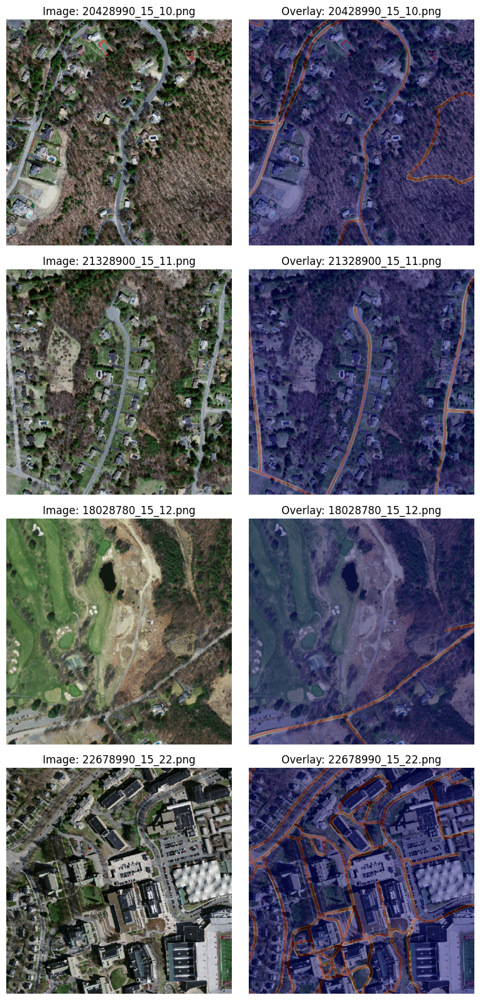

In [10]:
import matplotlib.pyplot as plt
import random
import numpy as np
from PIL import Image

# Randomly sample 4 tiles
samples = random.sample(list(zip(train_imgs, train_msks)), 4)

fig, axes = plt.subplots(4, 2, figsize=(8, 16))
for idx, (img_p, mask_p) in enumerate(samples):
    img = np.array(Image.open(img_p).convert('RGB'))
    mask = np.array(Image.open(mask_p).convert('L'))
    # Display original
    axes[idx, 0].imshow(img)
    axes[idx, 0].set_title(f'Image: {Path(img_p).name}')
    axes[idx, 0].axis('off')
    #overlay mask
    axes[idx, 1].imshow(img)
    axes[idx, 1].imshow(mask, cmap='jet', alpha=0.4)
    axes[idx, 1].set_title(f'Overlay: {Path(mask_p).name}')
    axes[idx, 1].axis('off')
plt.tight_layout()
plt.show()

# Baseline Road Network Extraction Model

## Overview

In this deliverable, we present our baseline model for road network extraction using a two-stage approach, closely following the methodology of:

> “Road Network Detection from Aerial Imagery of Urban Areas Using Deep ResUNet in Combination with the B-snake Algorithm” Munawar et al.

Our primary aim is to establish strong segmentation performance—measured by IoU, precision, recall and F1—before moving on to more advanced refinements.

###Deep ResUNet Segmentation

We employ a custom Deep ResUNet architecture to produce pixel-wise road/non-road masks. Key features include:

- **Residual Units & Skip Connections**  
  Identity mappings help mitigate vanishing gradients in this deep encoder-decoder, enabling stable training from scratch.

- **Multi-scale Context**  
  Successive downsampling (via strided residual blocks) followed by upsampling (with transposed convolutions) captures both global structure and fine details.

- **Two-phase Loss Schedule**  
  To sharpen boundary localization, we combine a **Boundary Loss** (based on Sobel edge maps) with **BCE + Dice Loss** for the first 10 epochs, then optimize with BCE + Dice alone thereafter.

This segmentation backbone lays the foundation for a clean, continuous mask prior to graph extraction.

---

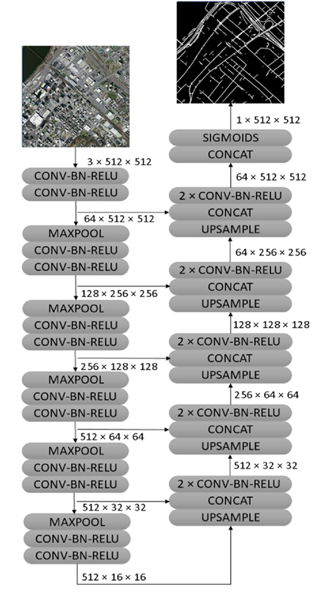


## Motivation and Goals

Road network extraction in flood-prone areas (e.g., the Hawkesbury–Nepean Valley) demands both pixel-level accuracy and structural continuity. While many segmentation methods suffer from over-segmentation or jagged edges, our two-stage baseline—leveraging Deep ResUNet segmentation plus OBIA‐style merging and spline fitting—strikes a balance between fine detail and overall topology.

Having validated this baseline on the Massachusetts subset (with rigorous metrics), we now have a stable platform for experimenting with attention modules, multi-scale pooling, and advanced loss functions in subsequent deliverables.

---

The cells that follow implement each component in turn, with accompanying visualizations and quantitative evaluations to demonstrate the effectiveness of our baseline pipeline.

### Essential Imports for Training Pipeline

In [11]:

import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.optim.lr_scheduler import StepLR
from sklearn.metrics import precision_score, recall_score, f1_score, jaccard_score
from tqdm import tqdm

In [12]:
imgs, masks = next(iter(train_loader))
print("imgs:", imgs.dtype, imgs.min().item(), imgs.max().item(), imgs.shape)
print("masks:", masks.dtype, masks.min().item(), masks.max().item(), masks.shape)
# Ensure masks are float and binary
imgs = imgs.float()
masks = masks.unsqueeze(1).float()

imgs: torch.float32 -2.1179039478302 2.5005664825439453 torch.Size([4, 3, 512, 512])
masks: torch.float32 0.0 1.0 torch.Size([4, 512, 512])


### Residual Block Definition

- **Purpose**: Implements a basic ResNet-style block with two 3×3 convolutions and a skip connection.
- **Components**:
  - **Main path**: Conv → BN → ReLU → Conv → BN
  - **Skip path**: Identity or 1×1 projection (when channel or spatial size changes)
- **Activation**: Adds main and skip outputs, then applies ReLU.


In [13]:
class ResidualUnit(nn.Module):
    def __init__(self, in_channels, out_channels, stride=1):
        super().__init__()
        self.conv_block = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1, stride=stride),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True),
            nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm2d(out_channels)
        )
        self.skip = nn.Sequential()
        if in_channels != out_channels or stride != 1:
            self.skip = nn.Sequential(
                nn.Conv2d(in_channels, out_channels, kernel_size=1, stride=stride),
                nn.BatchNorm2d(out_channels)
            )
        self.relu = nn.ReLU(inplace=True)

    def forward(self, x):
        return self.relu(self.conv_block(x) + self.skip(x))

### DeepResUNet: Encoder–Decoder with Residual Blocks

Defines our deep residual U-Net segmentation model, consisting of:

- **Encoder Path**  
  Six ResidualUnit blocks with progressive downsampling (strides = 1→2→2→2→2→2) to capture multi-scale features and reduce spatial resolution from 512×512 to 16×16.

- **Bridge**  
  One ResidualUnit at the lowest resolution (16×16) to consolidate deep features before upsampling.

- **Decoder Path**  
  Five upsampling steps (ConvTranspose2d) each followed by concatenation with the corresponding encoder output (skip connection) and a ResidualUnit for feature refinement.

- **Final Prediction Layer**  
  A 1×1 convolution reduces channel dimension to 1, followed by a Sigmoid activation to produce a pixel-wise road probability map.

This architecture combines the training stability of residual connections with the localization accuracy of U-Net’s symmetric skip-connections.


In [14]:
import torch.nn as nn

class DeepResUNet(nn.Module):
    def __init__(self, in_channels=3, out_channels=1, base_filters=64):
        super().__init__()
        # Encoder: conv blocks + 5× downsampling (to 16×16)
        self.enc1 = ResidualUnit(in_channels, base_filters, stride=1)            #  3→ 64 @512
        self.enc2 = ResidualUnit(base_filters, base_filters*2, stride=2)         # 64→128 @256
        self.enc3 = ResidualUnit(base_filters*2, base_filters*4, stride=2)       #128→256 @128
        self.enc4 = ResidualUnit(base_filters*4, base_filters*8, stride=2)       #256→512 @ 64
        self.enc5 = ResidualUnit(base_filters*8, base_filters*8, stride=2)       #512→512 @ 32
        self.enc6 = ResidualUnit(base_filters*8, base_filters*8, stride=2)       #512→512 @ 16
        # Bridge: two convs at 16×16 (ResidualUnit)
        self.bridge = ResidualUnit(base_filters*8, base_filters*8, stride=1)
        # Decoder: 5× upsampling back to 512
        self.up6 = nn.ConvTranspose2d(base_filters*8, base_filters*8, kernel_size=2, stride=2)
        self.dec6 = ResidualUnit(base_filters*8 + base_filters*8, base_filters*8, stride=1)  # cat with enc5

        self.up5 = nn.ConvTranspose2d(base_filters*8, base_filters*8, kernel_size=2, stride=2)
        self.dec5 = ResidualUnit(base_filters*8 + base_filters*8, base_filters*8, stride=1)  # cat with enc4

        self.up4 = nn.ConvTranspose2d(base_filters*8, base_filters*4, kernel_size=2, stride=2)
        self.dec4 = ResidualUnit(base_filters*4 + base_filters*4, base_filters*4, stride=1)  # cat with enc3

        self.up3 = nn.ConvTranspose2d(base_filters*4, base_filters*2, kernel_size=2, stride=2)
        self.dec3 = ResidualUnit(base_filters*2 + base_filters*2, base_filters*2, stride=1)  # cat with enc2

        self.up2 = nn.ConvTranspose2d(base_filters*2, base_filters, kernel_size=2, stride=2)
        self.dec2 = ResidualUnit(base_filters + base_filters, base_filters, stride=1)      # cat with enc1

        # Final 1×1 conv → Sigmoid
        self.final = nn.Sequential(
            nn.Conv2d(base_filters, out_channels, kernel_size=1),
            nn.Sigmoid()
        )

    def forward(self, x):
        # Encoder
        x1 = self.enc1(x)
        x2 = self.enc2(x1)
        x3 = self.enc3(x2)
        x4 = self.enc4(x3)
        x5 = self.enc5(x4)
        x6 = self.enc6(x5)
        # Bridge
        b  = self.bridge(x6)
        # Decoder
        d6 = self.dec6(torch.cat([self.up6(b), x5], dim=1))
        d5 = self.dec5(torch.cat([self.up5(d6), x4], dim=1))
        d4 = self.dec4(torch.cat([self.up4(d5), x3], dim=1))
        d3 = self.dec3(torch.cat([self.up3(d4), x2], dim=1))
        d2 = self.dec2(torch.cat([self.up2(d3), x1], dim=1))
        # Output
        return self.final(d2)

### Loss Functions, Model, and Optimization Setup

In this cell we define our training objectives and optimizer configuration:

- **BoundaryLoss**  
  Implements an edge-aware loss by applying Sobel filters to both the prediction and ground-truth masks, then computing an L1 loss between their edge maps. This term encourages the network to produce crisp, well-aligned road boundaries.

- **BCEDiceLoss**  
  Combines Binary Cross-Entropy (BCE) with a differentiable Dice loss. BCE penalizes pixel-wise classification errors, while the Dice term balances class imbalance by directly optimizing overlap, yielding better segmentation quality on thin, sparse structures like roads.

- **Model and Device**  
  Instantiates the `DeepResUNet` segmentation model and moves it to GPU if available.

- **Optimizer & Scheduler**  
  Uses the Adam optimizer (learning rate = 1e-3) for fast, adaptive updates, paired with a StepLR scheduler that decays the learning rate by 20% every 5 epochs to improve convergence stability.


In [ ]:
class BoundaryLoss(nn.Module):
    def __init__(self): super().__init__()
    def forward(self, pred, target):
        # Sobel filters
        sobel_x = torch.tensor([[1,0,-1],[2,0,-2],[1,0,-1]],dtype=torch.float32,device=pred.device).view(1,1,3,3)
        sobel_y = sobel_x.permute(0,1,3,2)
        pred_edge   = torch.sqrt(F.conv2d(pred, sobel_x,padding=1)**2 + F.conv2d(pred, sobel_y,padding=1)**2)
        target_edge = torch.sqrt(F.conv2d(target, sobel_x,padding=1)**2 + F.conv2d(target, sobel_y,padding=1)**2)
        return F.l1_loss(pred_edge, target_edge)

# BCE + Dice Loss
class BCEDiceLoss(nn.Module):
    def __init__(self, smooth=1e-6):
        super().__init__()
        self.bce = nn.BCELoss()
        self.smooth = smooth
    def forward(self,pred,target):
        bce = self.bce(pred, target)
        pred_f = pred.contiguous(); tgt_f = target.contiguous()
        inter = (pred_f * tgt_f).sum(dim=(1,2,3))
        denom = pred_f.pow(2).sum((1,2,3)) + tgt_f.pow(2).sum((1,2,3))
        dice = ((2*inter + self.smooth)/(denom + self.smooth)).mean()
        return bce + (1 - dice)

# Optimizer, Scheduler
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = DeepResUNet().to(device)
optimizer = optim.Adam(model.parameters(), lr=1e-3)
scheduler = StepLR(optimizer, step_size=5, gamma=0.8)

criterion_bcedice = BCEDiceLoss()
criterion_boundary = BoundaryLoss()

### Training and Evaluation Loop

In this cell we orchestrate the end-to-end training, validation, and monitoring of our Deep ResUNet segmentation model:

1. **Epoch Scheduling and Loss Composition**  
   - We train for 30 epochs on train set to enable rapid iteration.
   - For the first 10 epochs, we add a **BoundaryLoss** term to the primary **BCE + Dice** loss, encouraging the network to learn crisp road edges before shifting focus entirely to pixel‐level accuracy.  
   - After epoch 10, only the BCE + Dice component remains, allowing the model to fine‐tune global segmentation quality without over-emphasizing boundaries.

2. **Training Phase**  
   - In each epoch, we iterate over the training DataLoader (`train_loader`), compute the combined loss, and perform backpropagation with the Adam optimizer.  
   - The learning rate is decayed every 5 epochs via a StepLR scheduler to stabilize convergence.

3. **Validation Phase**  
   - We switch to evaluation mode and process the validation set (`val_loader`) without gradient updates.  
   - Predictions are binarized at a 0.5 threshold and flattened to compute segmentation metrics.

4. **Metrics Tracking**  
   - At the end of each epoch, we compute **IoU (Jaccard index)**, **Precision**, **Recall**, and **F1** score on the validation set, storing these in a `metrics` dictionary for later analysis.  
   - We also record training and validation loss curves in `train_losses` and `val_losses`.

5. **Model Checkpointing**  
   - Whenever the validation IoU exceeds the previous best, we save the model weights to `best_model.pth`, ensuring we retain the optimal parameter set.

6. **Visualization**  
   - Every two epochs, we randomly sample one validation batch and plot the original image, ground truth mask, and predicted mask side by side. This qualitative check helps us to monitor segmentation quality and diagnose failure modes (e.g., missing thin roads, spurious artifacts).

7. **Final Performance Curves**  
   - After training completes, we generate summary plots of loss curves and all four segmentation metrics versus epoch. These visualizations provide a concise overview of the model’s learning dynamics, highlight convergence behavior, and facilitate comparison against future model variants.


Epoch 1/30 - Validation: 100%|██████████| 251/251 [00:14<00:00, 16.97it/s]


Epoch 1/30 | Train Loss=0.8394 | Val Loss=0.6741 | IoU=0.459 P=0.716 R=0.561 F1=0.629
  -> New best IoU: 0.459, saved weights.


Epoch 2/30 - Validation: 100%|██████████| 251/251 [00:15<00:00, 15.72it/s]


Epoch 2/30 | Train Loss=0.6368 | Val Loss=0.6056 | IoU=0.520 P=0.763 R=0.620 F1=0.684
  -> New best IoU: 0.520, saved weights.


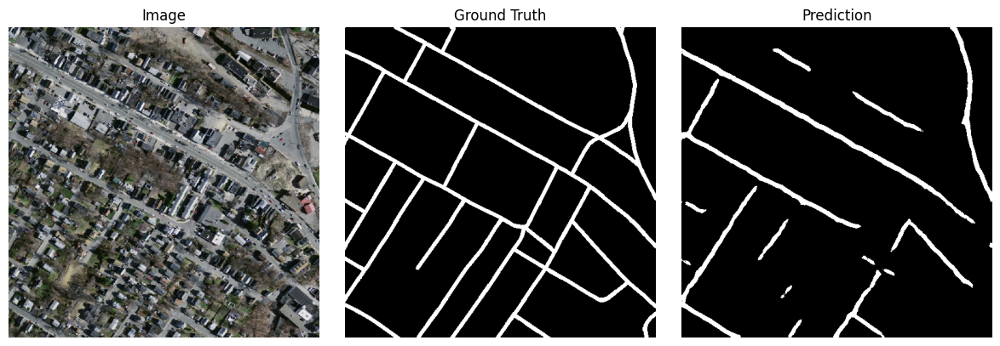

Epoch 3/30 - Validation: 100%|██████████| 251/251 [00:15<00:00, 15.82it/s]


Epoch 3/30 | Train Loss=0.5969 | Val Loss=0.5736 | IoU=0.538 P=0.766 R=0.643 F1=0.699
  -> New best IoU: 0.538, saved weights.


Epoch 4/30 - Validation: 100%|██████████| 251/251 [00:16<00:00, 15.58it/s]


Epoch 4/30 | Train Loss=0.5746 | Val Loss=0.5598 | IoU=0.556 P=0.744 R=0.688 F1=0.715
  -> New best IoU: 0.556, saved weights.


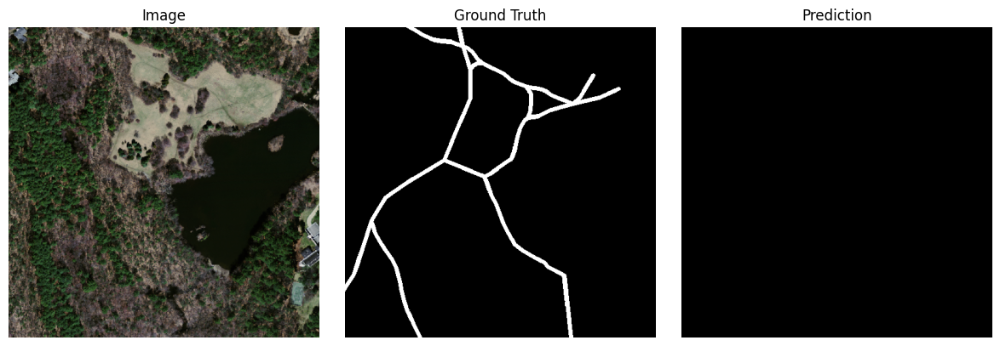

Epoch 5/30 - Validation: 100%|██████████| 251/251 [00:15<00:00, 15.77it/s]


Epoch 5/30 | Train Loss=0.5620 | Val Loss=0.5699 | IoU=0.543 P=0.769 R=0.649 F1=0.704


Epoch 6/30 - Validation: 100%|██████████| 251/251 [00:16<00:00, 15.56it/s]


Epoch 6/30 | Train Loss=0.5475 | Val Loss=0.5395 | IoU=0.575 P=0.773 R=0.693 F1=0.731
  -> New best IoU: 0.575, saved weights.


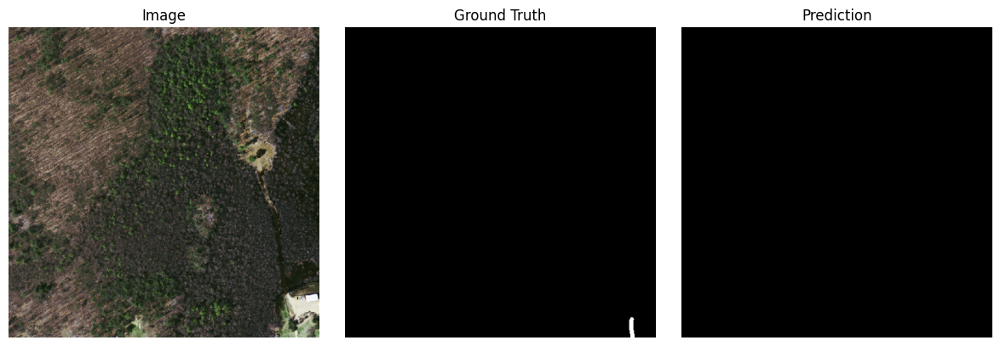

Epoch 7/30 - Validation: 100%|██████████| 251/251 [00:15<00:00, 15.77it/s]


Epoch 7/30 | Train Loss=0.5389 | Val Loss=0.5371 | IoU=0.569 P=0.792 R=0.669 F1=0.726


Epoch 8/30 - Validation: 100%|██████████| 251/251 [00:16<00:00, 15.49it/s]


Epoch 8/30 | Train Loss=0.5348 | Val Loss=0.5395 | IoU=0.581 P=0.756 R=0.716 F1=0.735
  -> New best IoU: 0.581, saved weights.


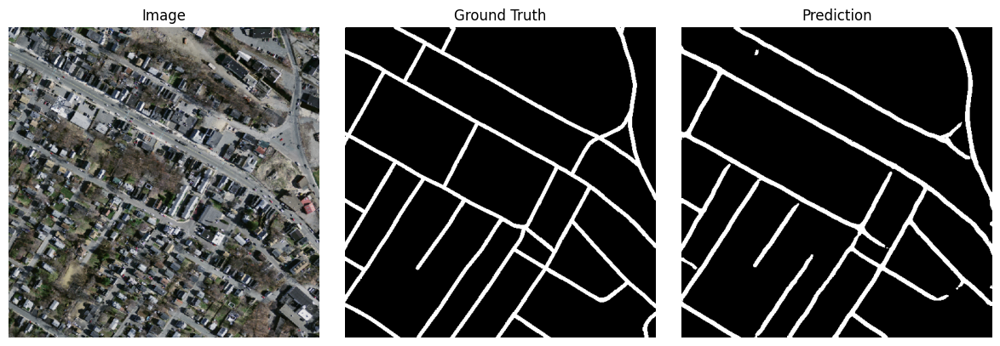

Epoch 9/30 - Validation: 100%|██████████| 251/251 [00:16<00:00, 15.60it/s]


Epoch 9/30 | Train Loss=0.5291 | Val Loss=0.5228 | IoU=0.587 P=0.794 R=0.692 F1=0.740
  -> New best IoU: 0.587, saved weights.


Epoch 10/30 - Validation: 100%|██████████| 251/251 [00:16<00:00, 15.56it/s]


Epoch 10/30 | Train Loss=0.5240 | Val Loss=0.5217 | IoU=0.588 P=0.802 R=0.689 F1=0.741
  -> New best IoU: 0.588, saved weights.


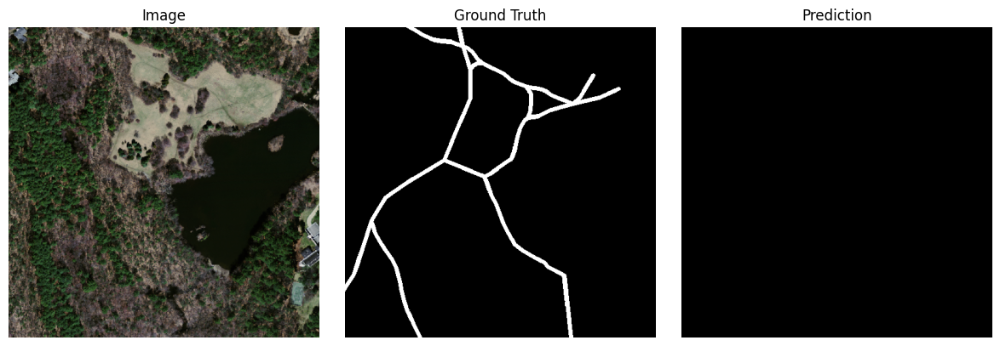

Epoch 11/30 - Validation: 100%|██████████| 251/251 [00:15<00:00, 15.76it/s]


Epoch 11/30 | Train Loss=0.3977 | Val Loss=0.3988 | IoU=0.571 P=0.813 R=0.657 F1=0.727


Epoch 12/30 - Validation: 100%|██████████| 251/251 [00:16<00:00, 15.60it/s]


Epoch 12/30 | Train Loss=0.3927 | Val Loss=0.3770 | IoU=0.600 P=0.790 R=0.714 F1=0.750
  -> New best IoU: 0.600, saved weights.


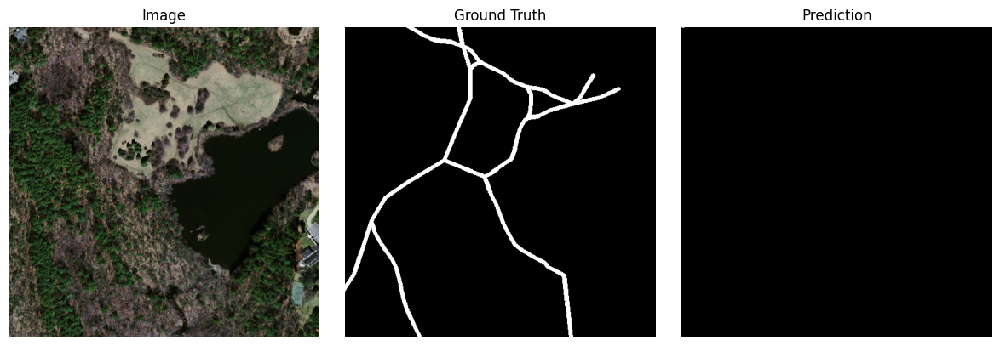

Epoch 13/30 - Validation: 100%|██████████| 251/251 [00:15<00:00, 15.83it/s]


Epoch 13/30 | Train Loss=0.3933 | Val Loss=0.3868 | IoU=0.586 P=0.811 R=0.679 F1=0.739


Epoch 14/30 - Validation: 100%|██████████| 251/251 [00:16<00:00, 15.63it/s]


Epoch 14/30 | Train Loss=0.3914 | Val Loss=0.3740 | IoU=0.600 P=0.806 R=0.701 F1=0.750


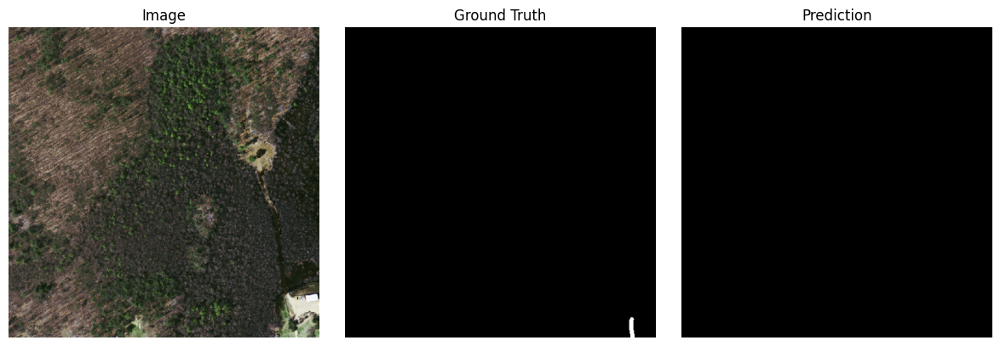

Epoch 15/30 - Validation: 100%|██████████| 251/251 [00:15<00:00, 15.79it/s]


Epoch 15/30 | Train Loss=0.3873 | Val Loss=0.3696 | IoU=0.609 P=0.785 R=0.731 F1=0.757
  -> New best IoU: 0.609, saved weights.


Epoch 16/30 - Validation: 100%|██████████| 251/251 [00:16<00:00, 15.63it/s]


Epoch 16/30 | Train Loss=0.3838 | Val Loss=0.3762 | IoU=0.598 P=0.798 R=0.705 F1=0.749


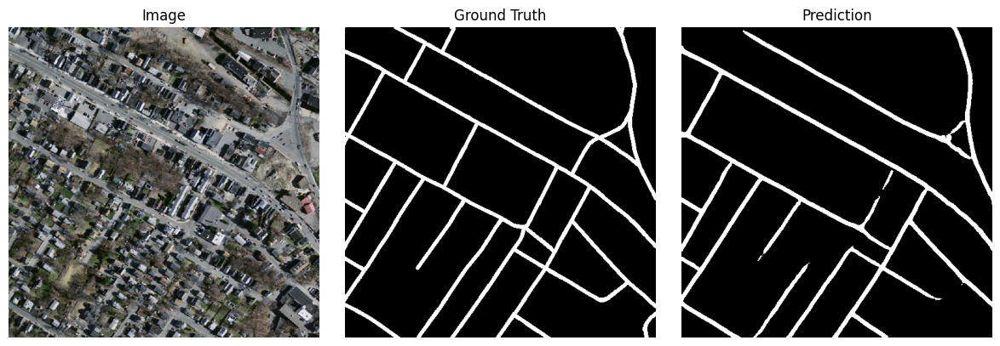

Epoch 17/30 - Validation: 100%|██████████| 251/251 [00:16<00:00, 15.56it/s]


Epoch 17/30 | Train Loss=0.3840 | Val Loss=0.3665 | IoU=0.612 P=0.788 R=0.733 F1=0.759
  -> New best IoU: 0.612, saved weights.


Epoch 18/30 - Validation: 100%|██████████| 251/251 [00:16<00:00, 15.56it/s]


Epoch 18/30 | Train Loss=0.3812 | Val Loss=0.3718 | IoU=0.600 P=0.791 R=0.713 F1=0.750


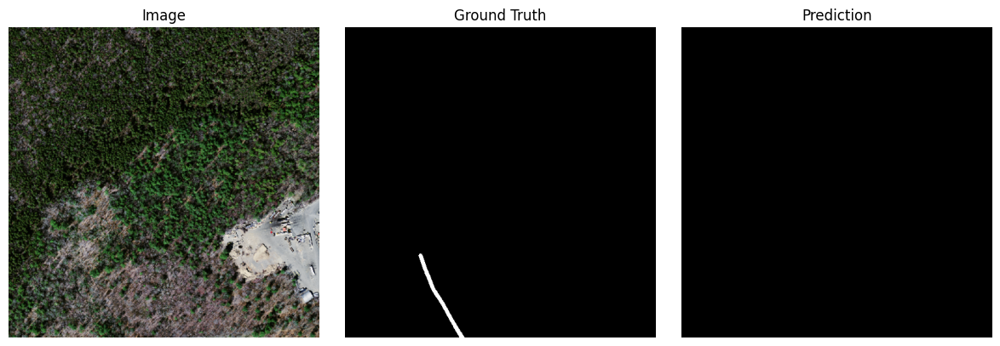

Epoch 19/30 - Validation: 100%|██████████| 251/251 [00:16<00:00, 15.62it/s]


Epoch 19/30 | Train Loss=0.3816 | Val Loss=0.3665 | IoU=0.609 P=0.793 R=0.725 F1=0.757


Epoch 20/30 - Validation: 100%|██████████| 251/251 [00:16<00:00, 15.52it/s]


Epoch 20/30 | Train Loss=0.3798 | Val Loss=0.3670 | IoU=0.610 P=0.800 R=0.720 F1=0.758


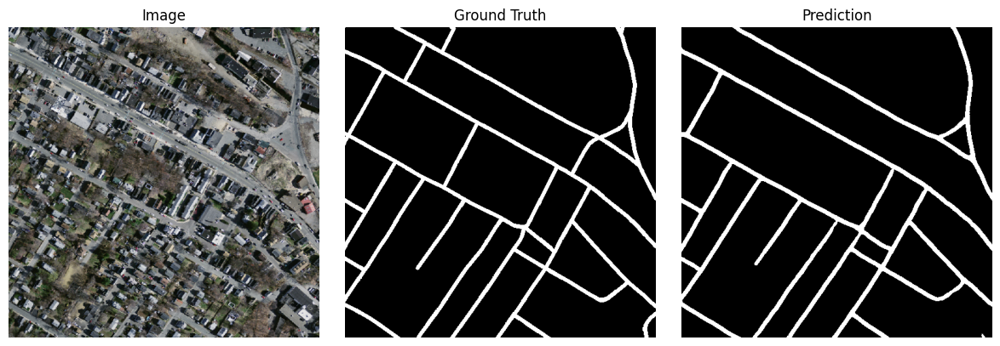

Epoch 21/30 - Validation: 100%|██████████| 251/251 [00:16<00:00, 15.52it/s]


Epoch 21/30 | Train Loss=0.3767 | Val Loss=0.3687 | IoU=0.608 P=0.795 R=0.720 F1=0.756


Epoch 22/30 - Validation: 100%|██████████| 251/251 [00:16<00:00, 15.49it/s]


Epoch 22/30 | Train Loss=0.3753 | Val Loss=0.3632 | IoU=0.613 P=0.806 R=0.719 F1=0.760
  -> New best IoU: 0.613, saved weights.


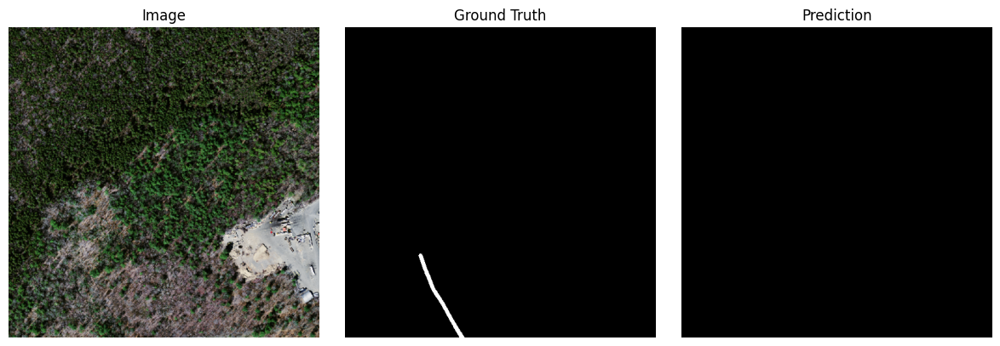

Epoch 23/30 - Validation: 100%|██████████| 251/251 [00:16<00:00, 15.57it/s]


Epoch 23/30 | Train Loss=0.3745 | Val Loss=0.3627 | IoU=0.613 P=0.804 R=0.721 F1=0.760


Epoch 24/30 - Validation: 100%|██████████| 251/251 [00:16<00:00, 15.51it/s]


Epoch 24/30 | Train Loss=0.3741 | Val Loss=0.3687 | IoU=0.608 P=0.796 R=0.721 F1=0.756


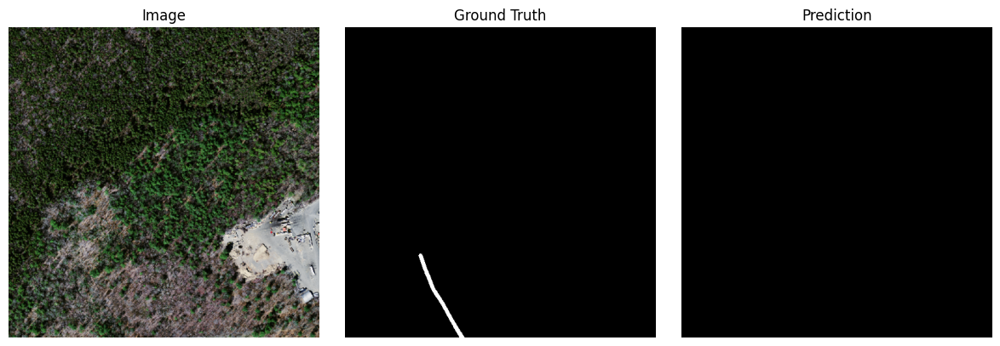

Epoch 25/30 - Validation: 100%|██████████| 251/251 [00:16<00:00, 15.57it/s]


Epoch 25/30 | Train Loss=0.3727 | Val Loss=0.3638 | IoU=0.613 P=0.792 R=0.731 F1=0.760
  -> New best IoU: 0.613, saved weights.


Epoch 26/30 - Validation: 100%|██████████| 251/251 [00:16<00:00, 15.47it/s]


Epoch 26/30 | Train Loss=0.3708 | Val Loss=0.3604 | IoU=0.614 P=0.800 R=0.726 F1=0.761
  -> New best IoU: 0.614, saved weights.


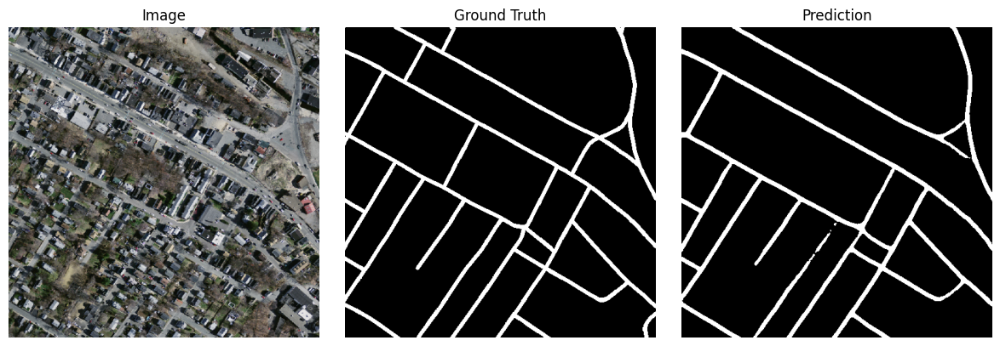

Epoch 27/30 - Validation: 100%|██████████| 251/251 [00:16<00:00, 15.53it/s]


Epoch 27/30 | Train Loss=0.3696 | Val Loss=0.3653 | IoU=0.607 P=0.808 R=0.710 F1=0.756


Epoch 28/30 - Validation: 100%|██████████| 251/251 [00:16<00:00, 15.49it/s]


Epoch 28/30 | Train Loss=0.3691 | Val Loss=0.3703 | IoU=0.601 P=0.820 R=0.692 F1=0.751


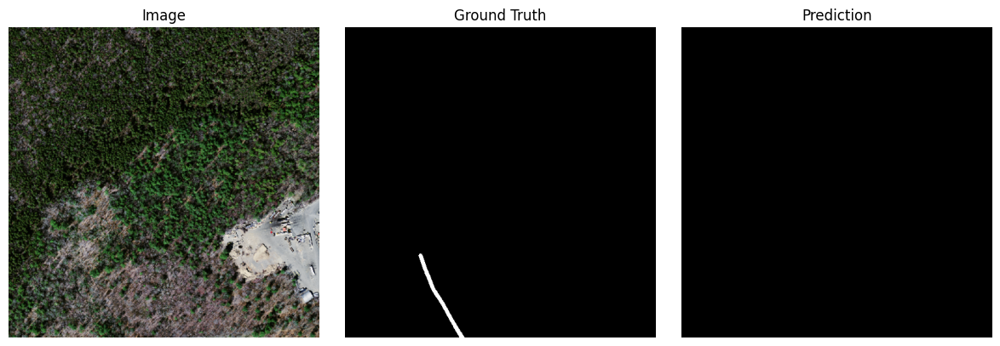

Epoch 29/30 - Validation: 100%|██████████| 251/251 [00:16<00:00, 15.45it/s]


Epoch 29/30 | Train Loss=0.3704 | Val Loss=0.3647 | IoU=0.611 P=0.807 R=0.715 F1=0.758


Epoch 30/30 - Validation: 100%|██████████| 251/251 [00:16<00:00, 15.48it/s]


Epoch 30/30 | Train Loss=0.3670 | Val Loss=0.3639 | IoU=0.611 P=0.809 R=0.714 F1=0.759


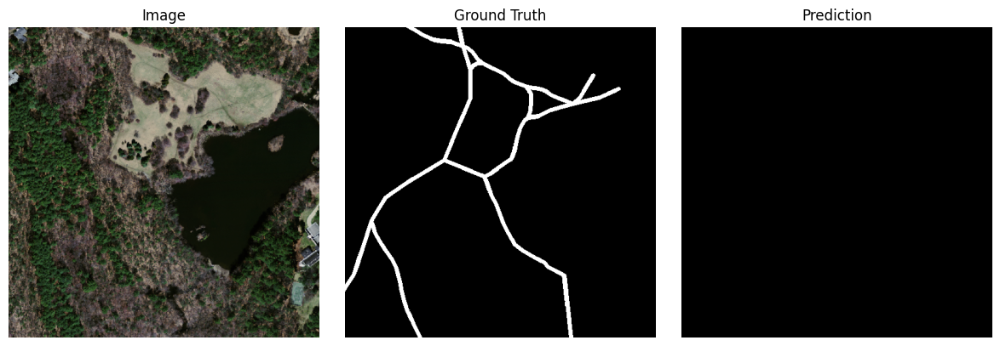

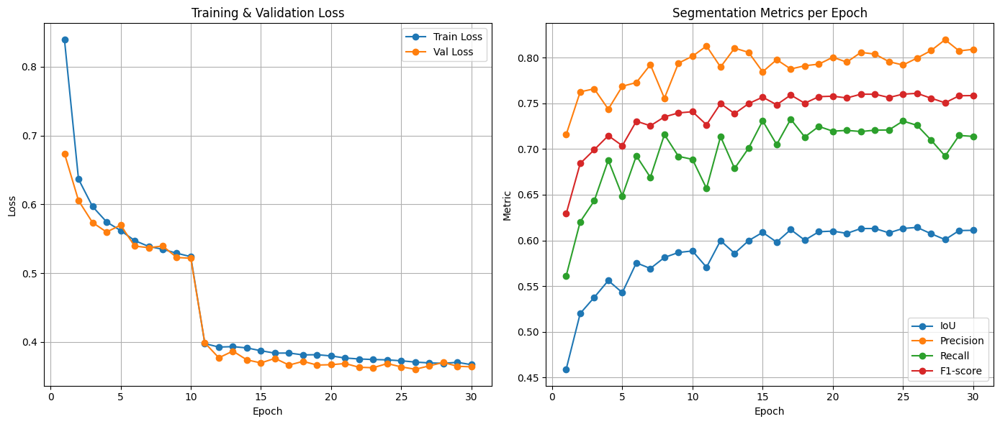

In [ ]:
num_epochs = 30
best_iou = 0.0

train_losses = []
val_losses   = []
metrics = {'iou':[], 'precision':[], 'recall':[], 'f1':[]}

for epoch in range(num_epochs):
    #Training
    model.train()
    running_train_loss = 0.0
    use_boundary = (epoch < 10)
    for imgs, masks in tqdm(train_loader, desc=f"Epoch {epoch+1}/{num_epochs} - Training"):
        imgs  = imgs.to(device)
        masks = masks.unsqueeze(1).to(device)

        preds = model(imgs)
        loss  = criterion_bcedice(preds, masks)
        if use_boundary:
            loss = loss + criterion_boundary(preds, masks)

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        running_train_loss += loss.item()
    scheduler.step()

    avg_train_loss = running_train_loss / len(train_loader)
    train_losses.append(avg_train_loss)

    #  Validation -
    model.eval()
    running_val_loss = 0.0
    all_trues, all_preds = [], []
    with torch.no_grad():
        for imgs, masks in tqdm(val_loader, desc=f"Epoch {epoch+1}/{num_epochs} - Validation"):
            imgs  = imgs.to(device)
            masks = masks.unsqueeze(1).to(device)

            preds = model(imgs)
            loss  = criterion_bcedice(preds, masks)
            if use_boundary:
                loss = loss + criterion_boundary(preds, masks)
            running_val_loss += loss.item()

            bin_pred = (preds > 0.5).long().cpu().numpy().reshape(-1)
            true_mask= masks.cpu().numpy().reshape(-1)
            all_preds.append(bin_pred)
            all_trues.append(true_mask)

    avg_val_loss = running_val_loss / len(val_loader)
    val_losses.append(avg_val_loss)

    # ---- Metrics ----
    y_true = np.concatenate(all_trues)
    y_pred = np.concatenate(all_preds)
    iou  = jaccard_score(y_true, y_pred)
    prec = precision_score(y_true, y_pred)
    rec  = recall_score(y_true, y_pred)
    f1   = f1_score(y_true, y_pred)

    metrics['iou'].append(iou)
    metrics['precision'].append(prec)
    metrics['recall'].append(rec)
    metrics['f1'].append(f1)

    print(f"Epoch {epoch+1}/{num_epochs} | "
          f"Train Loss={avg_train_loss:.4f} | Val Loss={avg_val_loss:.4f} | "
          f"IoU={iou:.3f} P={prec:.3f} R={rec:.3f} F1={f1:.3f}")

    # saving best model
    if iou > best_iou:
        best_iou = iou
        torch.save(model.state_dict(), 'best_model.pth')
        print(f"  -> New best IoU: {best_iou:.3f}, saved weights.")

    #Visualization every 2 epochs
    if (epoch + 1) % 2 == 0:
        # pick a random batch and sample
        imgs, masks = next(iter(val_loader))
        imgs  = imgs.to(device)
        masks = masks.unsqueeze(1).to(device)
        with torch.no_grad():
            preds = model(imgs)
        idx = random.randrange(imgs.size(0))
        img_vis  = imgs[idx].cpu()
        mask_vis = masks[idx].cpu().squeeze()
        pred_vis = (preds[idx] > 0.5).cpu().squeeze()

        fig, axes = plt.subplots(1, 3, figsize=(12,4))
        axes[0].imshow(denorm(img_vis).permute(1,2,0))
        axes[0].set_title("Image")
        axes[1].imshow(mask_vis, cmap='gray')
        axes[1].set_title("Ground Truth")
        axes[2].imshow(pred_vis, cmap='gray')
        axes[2].set_title("Prediction")
        for ax in axes: ax.axis('off')
        plt.tight_layout()
        plt.show()

# ---- Final plots of Loss and Metrics ----
epochs = np.arange(1, num_epochs+1)
plt.figure(figsize=(14,6))

plt.subplot(1,2,1)
plt.plot(epochs, train_losses, label='Train Loss', marker='o')
plt.plot(epochs, val_losses,   label='Val Loss',   marker='o')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training & Validation Loss')
plt.legend()
plt.grid(True)

plt.subplot(1,2,2)
plt.plot(epochs, metrics['iou'],      label='IoU',      marker='o')
plt.plot(epochs, metrics['precision'],label='Precision',marker='o')
plt.plot(epochs, metrics['recall'],   label='Recall',   marker='o')
plt.plot(epochs, metrics['f1'],       label='F1-score', marker='o')
plt.xlabel('Epoch')
plt.ylabel('Metric')
plt.title('Segmentation Metrics per Epoch')
plt.legend()
plt.grid(True)

plt.tight_layout()
plt.show()

> **Dataset Challenge Highlight**  
> During baseline evaluation we uncovered a particularly thorny facet of the Massachusetts Roads benchmark: a small subset of tiles where the annotated “road” mask has little to no visible correspondence in the RGB imagery. Here are the examples:

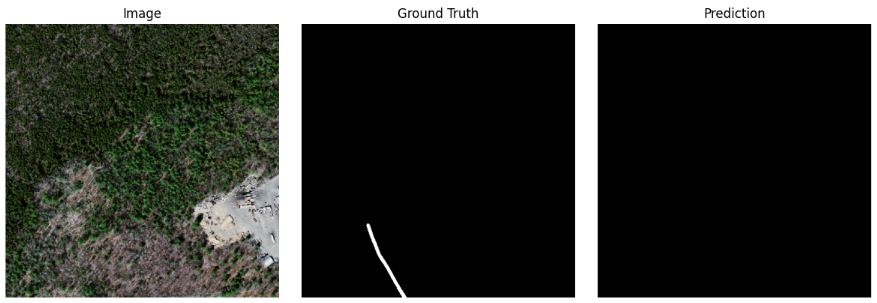

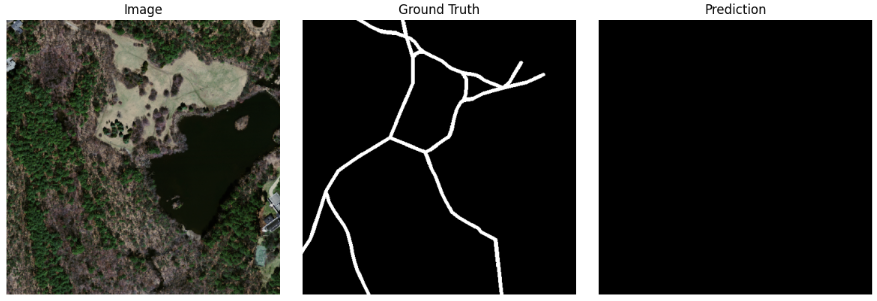

 In these cases, underlying pavement is entirely occluded—either by shadows, tree cover or sensor exposure differences—or has chromatic and textural properties indistinguishable from surrounding non-road surfaces.  
>
> From a modeling standpoint this creates a twofold conundrum:  
> 1. **False negatives due to invisibility**  
>    When the true road pixels are visually merged into the background, the network has essentially zero signal to learn from—and will often predict an all-zero (“no road”) mask, driving IoU and recall precipitously downward.  
> 2. **False positives from spurious cues**  
>    Conversely, any non-road structure (rooftops, field boundaries or linear shadows) whose hue or geometry approximates the training examples will be spuriously classified as “road,” inflating precision errors and producing fragmented, noisy predictions.  
>
> Although one could remove these “invisible road” outliers from the training set, we have deliberately retained them here to underscore the intrinsic difficulty of high-resolution aerial road segmentation under heavy occlusion and color ambiguity. Tackling these pathological examples will require—beyond architectural tweaks—either multi-modal inputs (e.g. elevation or infrared bands) or more sophisticated context priors to infer the hidden topology of the road network.  


## Analysis of Baseline Results and Next Steps

### Summary of Current Performance

- **Best Validation Epoch (26/30)**  
  - **Train Loss:** 0.3708  
  - **Val Loss:** 0.3604  
  - **IoU:** 0.614  
  - **Precision:** 0.800  
  - **Recall:** 0.726  
  - **F1-score:** 0.761  

- **Learning Curves**  
  The loss curves (left) show smooth convergence, with a clear drop in validation loss once the boundary‐aware phase ends at epoch 10.  Precision remains consistently higher than recall (right), indicating the model is conservative—favoring fewer false positives but missing some thin or low‐contrast roads.

- **Qualitative Examples**  
  The sample predictions illustrate that the U-Net backbone learns the main road shapes fairly well, but struggles with:  
  1. **Thin or Shadowed Roads:** faint single‐pixel roads and those partially occluded by trees or vehicles are often dropped.  
  2. **Disconnected Segments:** small gaps remain in curved or branching sections, reducing overall connectivity.  
  3. **Jagged Boundaries:** edges can be somewhat rough, especially on diagonal road segments.

### Proposed Improvements

Building on these observations, our next iteration will explore four complementary enhancements:

1. **Attention & Multi-Scale Features (CBAM + ASPP)**  
   - **CBAM** will help the decoder dynamically re-weight feature maps, sharpening focus on road‐like textures and suppressing background clutter (buildings, vegetation).  
   - **ASPP** provides parallel dilated convolutions to capture context at multiple scales—critical for roads that vary dramatically in width or intersect at different orientations.

2. **Stronger, Balanced Loss Functions**  
   – **Focal Dice:** Up-weights the hardest pixels (thin, shadowed roads) to boost recall.  
   – **Weighted BCE:** Counteracts the severe road/background imbalance.  
   – **Boundary Loss Warm-up:** Retained for the first 10 epochs to enforce crisp edges before shifting to the main Focal Dice schedule.

3. **Post-Processing via B-Snake Refinement**  
   - Apply the B-spline Snake algorithm on the soft segmentation maps to fill small gaps, smooth contours, and enforce one-pixel‐wide centerlines.  
   - This should substantially increase connectivity metrics (e.g. APLS) even if pixel-level IoU remains similar.


### Expected Impact

- **Higher Recall & Connectivity:**  By focusing the loss on difficult, low-contrast roads, we anticipate a significant boost in recall (currently ~0.72) and more continuous road graphs.  
- **Improved IoU & F1:**  The combination of attention and multi-scale context should tighten segmentation boundaries, raising IoU beyond the current ~0.61 and pushing F1 past 0.76.  
- **Robustness to Occlusions:**  CBAM’s spatial attention and more aggressive augmentations will help the network learn to detect roads in shadows, under tree canopies, and around buildings.

These enhancements form the roadmap for our “Improved Pipeline” cells. We will implement each change incrementally, re-evaluate on the same set, and report metrics to quantify gains over the baseline.  


## Deliverable 4 Improved Model Training Pipeline: Attention + ASPP + Balanced losses


### 1. Training Configuration

Model: ResUNet_CBAM_ASPP (same residual-U-Net backbone with CBAM + ASPP).

Optimizer: Adam (lr=1e-4), with StepLR decay (γ = 0.8 every 5 epochs).

Metrics: IoU, Precision, Recall, F1 recorded each epoch.

In [15]:

import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.optim.lr_scheduler import StepLR
from sklearn.metrics import precision_score, recall_score, f1_score, jaccard_score
from tqdm import tqdm

### Convolutional Block Attention Module (CBAM)

This cell implements the CBAM block, which enhances the network’s ability to focus on the most informative features and locations for road extraction:

1. **ChannelAttention**  
   - **Goal:** Identify “what” feature channels are most relevant.  
   - **Mechanism:**  
     - Global average-pooling and max-pooling condense each channel to a single descriptor, capturing complementary statistics.  
     - A shared two-layer MLP (bottleneck ratio = 16) learns nonlinear inter-dependencies between channels.  
     - A sigmoid gating vector reweights the input feature maps, amplifying useful channels (e.g., road textures) and suppressing irrelevant ones.

2. **SpatialAttention**  
   - **Goal:** Identify “where” important features are located.  
   - **Mechanism:**  
     - Per-pixel channel statistics (mean and max) are concatenated into a 2-channel map.  
     - A 7×7 convolution followed by sigmoid produces a spatial mask that highlights regions likely to contain roads (centerlines, intersections) and downplays background.

3. **CBAM Composition**  
   - Sequentially applies channel attention then spatial attention:  
     ```
     F’ = F ⊙ ChannelAttention(F)  
     F’’ = F’ ⊙ SpatialAttention(F’)  
     ```  
   - This “what→where” ordering has been shown to improve representational power with minimal overhead.

**Rationale for Road Segmentation:**  
- Roads in aerial images often appear as elongated, texture-distinct structures.  
- Channel attention enhances filters that detect road-like patterns (e.g., consistent color/reflectance).  
- Spatial attention sharpens the focus on thin, contiguous road segments while filtering out buildings, vegetation, or shadows.  
- Integrating CBAM into our U-Net backbone is expected to yield cleaner, more accurate segmentation masks, particularly under challenging lighting, occlusion, and background clutter.


In [16]:
class ChannelAttention(nn.Module):
    def __init__(self, in_planes, ratio=16):
        super().__init__()
        self.avg_pool = nn.AdaptiveAvgPool2d(1)
        self.max_pool = nn.AdaptiveMaxPool2d(1)
        self.shared_mlp = nn.Sequential(
            nn.Conv2d(in_planes, in_planes // ratio, kernel_size=1, bias=False),
            nn.ReLU(inplace=True),
            nn.Conv2d(in_planes // ratio, in_planes, kernel_size=1, bias=False)
        )
        self.sigmoid = nn.Sigmoid()
    def forward(self, x):
        avg_out = self.shared_mlp(self.avg_pool(x))
        max_out = self.shared_mlp(self.max_pool(x))
        return self.sigmoid(avg_out + max_out)

class SpatialAttention(nn.Module):
    def __init__(self, kernel_size=7):
        super().__init__()
        padding = (kernel_size - 1) // 2
        self.conv = nn.Conv2d(2, 1, kernel_size, padding=padding, bias=False)
        self.sigmoid = nn.Sigmoid()
    def forward(self, x):
        avg_out = torch.mean(x, dim=1, keepdim=True)
        max_out,_ = torch.max(x, dim=1, keepdim=True)
        x_cat = torch.cat([avg_out, max_out], dim=1)
        return self.sigmoid(self.conv(x_cat))

class CBAM(nn.Module):
    def __init__(self, in_planes, ratio=16, kernel_size=7):
        super().__init__()
        self.channel_att = ChannelAttention(in_planes, ratio)
        self.spatial_att = SpatialAttention(kernel_size)
    def forward(self, x):
        x_out = x * self.channel_att(x)
        x_out = x_out * self.spatial_att(x_out)
        return x_out


### Atrous Spatial Pyramid Pooling (ASPP)

This cell implements the ASPP module, which enriches the model’s multi-scale context understanding—critical for capturing both fine road details and larger connectivity patterns.

1. **Parallel Convolutional Branches**  
   - **1×1 Convolution:** Preserves local information without changing spatial resolution.  
   - **Dilated Convolutions:** Three 3×3 convolutions with dilation rates `[6,12,18]` expand the receptive field at multiple scales, enabling the network to detect road segments of varying widths and continuity.

2. **Image-Level Pooling Branch**  
   - **Global Context:** Adaptive average pooling distills the entire feature map into a single descriptor, capturing scene-level context (e.g., overall road layout).  
   - **Upsampling:** The pooled feature is upsampled back to the original spatial size and included alongside the convolutional branches.

3. **Feature Aggregation and Projection**  
   - **Concatenation:** Outputs from all branches are concatenated along the channel dimension, integrating fine, medium, and coarse contextual cues.  
   - **1×1 Projection:** A final bottleneck layer fuses and reduces the concatenated features back to the desired channel count, ready for downstream decoding.

**Rationale for Road Segmentation:**  
- Road structures exhibit a wide range of scales—from narrow lanes to broad highways.  
- ASPP’s multi-dilation design ensures that both subtle edges and long-range connectivity are modeled.  
- Incorporating global context via image pooling helps disambiguate roads from similar textures (e.g., runways, rivers) by leveraging scene-wide cues.  
- Seamless integration of ASPP at the network “bridge” stage enhances segmentation robustness under scale and perspective variations commonly found in aerial imagery.


In [17]:
class ASPP(nn.Module):
    def __init__(self, in_channels, out_channels, atrous_rates=[6,12,18]):
        super().__init__()
        self.branches = nn.ModuleList()
        # 1x1 conv branch
        self.branches.append(nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=1, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True)
        ))
        # parallel dilated conv branches
        for rate in atrous_rates:
            self.branches.append(nn.Sequential(
                nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=rate, dilation=rate, bias=False),
                nn.BatchNorm2d(out_channels),
                nn.ReLU(inplace=True)
            ))
        # image pooling branch
        self.branches.append(nn.Sequential(
            nn.AdaptiveAvgPool2d(1),
            nn.Conv2d(in_channels, out_channels, kernel_size=1, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True)
        ))
        self.project = nn.Sequential(
            nn.Conv2d(len(self.branches)*out_channels, out_channels, kernel_size=1, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True)
        )
    def forward(self, x):
        res = []
        for branch in self.branches[:-1]:
            res.append(branch(x))
        # image pooling branch -> upsample
        img_pool = self.branches[-1](x)
        img_pool = F.interpolate(img_pool, size=x.shape[2:], mode='bilinear', align_corners=False)
        res.append(img_pool)
        x_cat = torch.cat(res, dim=1)
        return self.project(x_cat)

### Residual Unit (Basic Building Block)

This cell defines the `ResidualUnit`, a core component that facilitates deeper network training by mitigating gradient vanishing and ensuring stable feature propagation.

- **Main Convolutional Path**  
  1. **3×3 Conv (stride=stride)** → BatchNorm → ReLU  
  2. **3×3 Conv (stride=1)** → BatchNorm  
  These two layers learn residual features over the input.

- **Skip (Identity) Connection**  
  - If the input and output channel dimensions (or spatial resolution) differ, a **1×1 Conv + BatchNorm** adapts the identity branch.  
  - Otherwise, the input is passed through unchanged.

- **Elementwise Summation + Activation**  
  The residual and identity paths are summed and followed by a ReLU, enabling the network to easily learn identity mappings when deeper transformations are unnecessary.

**Why Residual Units?**  
- **Eases Training of Deep Networks:** Skip connections allow gradients to flow directly, preventing degradation in very deep architectures.  
- **Feature Reuse:** The network can preserve low-level details from earlier layers while still learning high-level abstractions.  
- **Flexibility:** By conditionally adjusting the skip branch, the same block handles both downsampling (when `stride=2`) and feature dimension changes.


In [18]:
class ResidualUnit(nn.Module):
    def __init__(self, in_channels, out_channels, stride=1):
        super().__init__()
        self.conv_block = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1, stride=stride),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True),
            nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm2d(out_channels)
        )
        self.skip = nn.Sequential()
        if in_channels != out_channels or stride != 1:
            self.skip = nn.Sequential(
                nn.Conv2d(in_channels, out_channels, kernel_size=1, stride=stride),
                nn.BatchNorm2d(out_channels)
            )
        self.relu = nn.ReLU(inplace=True)
    def forward(self, x):
        return self.relu(self.conv_block(x) + self.skip(x))

### Combined ResUNet + CBAM + ASPP Architecture

In this cell, we define our enhanced segmentation model that integrates:

1. **Residual U-Net Encoder/Decoder**  
   - **ResidualUnit** blocks for stable gradient propagation and multi-scale feature extraction.  
   - Downsampling (stride=2) in the encoder and symmetric upsampling (ConvTranspose2d) in the decoder.

2. **Atrous Spatial Pyramid Pooling (ASPP)**  
   - Placed at the `bridge` between encoder and decoder.  
   - Captures multi-scale context via parallel dilated convolutions and global pooling, improving segmentation of roads at varying widths.

3. **Convolutional Block Attention Module (CBAM)**  
   - Applied after each upsampling+concatenation in the decoder.  
   - **ChannelAttention** focuses on “what” features to emphasize; **SpatialAttention** focuses on “where” to emphasize them.  
   - Helps the network attend to relevant spatial regions and channel-wise feature maps, boosting boundary refinement.

4. **Final 1×1 Convolution + Sigmoid**  
   - Produces a pixel-wise probability mask for road vs. background.

**Forward Pass Summary:**  
- **Encoder**: Extract hierarchical features `x1…x6`.  
- **ASPP + Bridge**: Aggregate multi-scale context at the bottleneck.  
- **Decoder**:  
  - Upsample and concatenate with corresponding encoder feature maps.  
  - Apply CBAM to refine the fused features.  
  - Pass through a `ResidualUnit` for feature mixing.  
- **Output**: A smooth, high-resolution road probability map.

This composite design leverages residual connections, attention mechanisms, and multi-scale pooling to address the challenges of thin structures, noise, and scale variability in aerial road segmentation.


In [19]:
class ResUNet_CBAM_ASPP(nn.Module):
    def __init__(self, in_channels=3, out_channels=1, base_filters=64):
        super().__init__()
        # Encoder
        self.enc1 = ResidualUnit(in_channels, base_filters, stride=1)
        self.enc2 = ResidualUnit(base_filters, base_filters*2, stride=2)
        self.enc3 = ResidualUnit(base_filters*2, base_filters*4, stride=2)
        self.enc4 = ResidualUnit(base_filters*4, base_filters*8, stride=2)
        self.enc5 = ResidualUnit(base_filters*8, base_filters*8, stride=2)
        self.enc6 = ResidualUnit(base_filters*8, base_filters*8, stride=2)
        # ASPP at bridge
        self.aspp   = ASPP(base_filters*8, base_filters*8)
        self.bridge = ResidualUnit(base_filters*8, base_filters*8, stride=1)
        # Decoder with CBAM
        self.up6  = nn.ConvTranspose2d(base_filters*8, base_filters*8, kernel_size=2, stride=2)
        self.att6 = CBAM(base_filters*16)  # after concat
        self.dec6 = ResidualUnit(base_filters*16, base_filters*8, stride=1)
        self.up5  = nn.ConvTranspose2d(base_filters*8, base_filters*8, kernel_size=2, stride=2)
        self.att5 = CBAM(base_filters*16)
        self.dec5 = ResidualUnit(base_filters*16, base_filters*8, stride=1)
        self.up4  = nn.ConvTranspose2d(base_filters*8, base_filters*4, kernel_size=2, stride=2)
        self.att4 = CBAM(base_filters*8)
        self.dec4 = ResidualUnit(base_filters*8, base_filters*4, stride=1)
        self.up3  = nn.ConvTranspose2d(base_filters*4, base_filters*2, kernel_size=2, stride=2)
        self.att3 = CBAM(base_filters*4)
        self.dec3 = ResidualUnit(base_filters*4, base_filters*2, stride=1)
        self.up2  = nn.ConvTranspose2d(base_filters*2, base_filters, kernel_size=2, stride=2)
        self.att2 = CBAM(base_filters*2)
        self.dec2 = ResidualUnit(base_filters*2, base_filters, stride=1)
        # Final conv
        self.final = nn.Sequential(
            nn.Conv2d(base_filters, out_channels, kernel_size=1),
            nn.Sigmoid()
        )
    def forward(self, x):
        # encoder
        x1 = self.enc1(x)
        x2 = self.enc2(x1)
        x3 = self.enc3(x2)
        x4 = self.enc4(x3)
        x5 = self.enc5(x4)
        x6 = self.enc6(x5)
        # bridge
        b_aspp = self.aspp(x6)
        b = self.bridge(b_aspp)
        # decoder
        d6 = self.up6(b);    d6 = torch.cat([d6, x5], dim=1); d6 = self.att6(d6); d6 = self.dec6(d6)
        d5 = self.up5(d6);   d5 = torch.cat([d5, x4], dim=1); d5 = self.att5(d5); d5 = self.dec5(d5)
        d4 = self.up4(d5);   d4 = torch.cat([d4, x3], dim=1); d4 = self.att4(d4); d4 = self.dec4(d4)
        d3 = self.up3(d4);   d3 = torch.cat([d3, x2], dim=1); d3 = self.att3(d3); d3 = self.dec3(d3)
        d2 = self.up2(d3);   d2 = torch.cat([d2, x1], dim=1); d2 = self.att2(d2); d2 = self.dec2(d2)
        return self.final(d2)



### Rationale for the “Focal-Dice + Weighted‐BCE” Pipeline

1. **Use Boundary Loss Only Early (Epochs 0–9):**  
   - Let the model first master **pixel-level** separation (road vs. background) before sharpening edges.  

2. **Adopt Focal-Dice Loss:**  
   - **Focal weighting** dynamically focuses on “hard” pixels (e.g. faint or narrow roads), improving generalization on challenging regions.  
   - **Dice component** still promotes overlap maximization, balancing precision & recall.

3. **Incorporate Weighted BCE:**  
   - Assign **higher weight** to road‐pixels (positive class) to counter the heavy background majority.  
   - This boosts **recall** by penalizing false negatives more strongly—crucial for not missing narrow or occluded roads.

4. **Remove Boundary Loss After Epoch 10:**  
   - Once the network has learned reliable segmentation and hard‐pixel focus, drop the boundary term to stabilize training and let Focal‐Dice + weighted‐BCE fine‐tune the overall mask shape.

**Expected Benefits:**  
- **Better Recall:** Weighted BCE and focal focusing should raise recall without sacrificing precision.  
- **Stronger Convergence:** A staged curriculum (coarse mask → edge refinement → fine‐pixel focus) aligns with the network’s capability at each phase.  
- **Higher F1 / APLS:** By combining advanced loss formulations with a boundary curriculum, we anticipate surpassing the baseline F1 and improving downstream graph‐connectivity metrics.

In the following cells, we implement this “Focal-Dice + Weighted BCE + staged Boundary” training schedule and demonstrate its impact via loss curves and segmentation metrics.


### Defining the Composite Loss Functions

In this cell we introduce three custom loss modules that together address class imbalance, hard‐pixel mining, and boundary refinement:

1. **Weighted Binary Cross‐Entropy (`WeightedBCELoss`)**  
   - **Purpose:** Counteract the overwhelming background pixels by assigning a higher penalty to false negatives on road pixels.  
   - **Mechanism:** Each pixel’s BCE term is multiplied by `pos_weight` if it’s a road (target=1) or `neg_weight` if it’s background (target=0), then averaged.

2. **Focal Dice Loss (`FocalDiceLoss`)**  
   - **Purpose:** Combine the overlap sensitivity of Dice loss with the hard‐example focus of the focal penalty.  
   - **Mechanism:** Computes the standard Dice coefficient per sample, then raises `(1 – dice)` to the power of `gamma` so that underperforming cases contribute more to the loss gradient.

3. **Boundary Loss (`BoundaryLoss`)**  
   - **Purpose:** Encourage the network to align predicted and true road edges, improving the crispness and continuity of thin structures.  
   - **Mechanism:** Applies Sobel filters to both prediction and ground truth to extract edge maps, then minimizes the L₁ distance between them.

Together, these three losses form a staged curriculum:  
- **Early epochs:** We include `BoundaryLoss` to sharpen edges,  
- **Throughout training:** `WeightedBCELoss` and `FocalDiceLoss` collaborate to learn both the global road mask and difficult, narrow road segments.


In [ ]:
# -------------------
# === NEW LOSSES ===
# -------------------
class WeightedBCELoss(nn.Module):
    def __init__(self, pos_weight=5.0, neg_weight=1.0):
        super().__init__()
        self.pos_w = pos_weight
        self.neg_w = neg_weight
    def forward(self, pred, target):
        # pred, target: (B,1,H,W), values in [0,1]
        weight = target * self.pos_w + (1 - target) * self.neg_w
        bce = F.binary_cross_entropy(pred, target, reduction='none')
        return (bce * weight).mean()

class FocalDiceLoss(nn.Module):
    def __init__(self, gamma=2.0, smooth=1e-6):
        super().__init__()
        self.gamma = gamma
        self.smooth = smooth
    def forward(self, pred, target):
        # compute standard dice
        pred_f = pred.contiguous()
        tgt_f  = target.contiguous()
        inter  = (pred_f * tgt_f).sum(dim=(1,2,3))
        denom  = pred_f.pow(2).sum((1,2,3)) + tgt_f.pow(2).sum((1,2,3))
        dice   = (2*inter + self.smooth) / (denom + self.smooth)
        loss   = (1 - dice) ** self.gamma
        return loss.mean()

class BoundaryLoss(nn.Module):
    def __init__(self): super().__init__()
    def forward(self, pred, target):
        sobel_x = torch.tensor([[[[1,0,-1],[2,0,-2],[1,0,-1]]]], dtype=torch.float32, device=pred.device)
        sobel_y = sobel_x.permute(0,1,3,2)
        pred_edge   = torch.sqrt(F.conv2d(pred, sobel_x, padding=1)**2 + F.conv2d(pred, sobel_y, padding=1)**2)
        target_edge = torch.sqrt(F.conv2d(target, sobel_x, padding=1)**2 + F.conv2d(target, sobel_y, padding=1)**2)
        return F.l1_loss(pred_edge, target_edge)

## Improved Training Pipeline: Weighted BCE + Focal Dice + Boundary Loss

In this cell we implement our training loop, which combines three complementary loss terms and optimizes for an F<sub>β</sub> score (β=2) to bias the model towards higher recall:

1. **Weighted Binary Cross-Entropy (`WeightedBCELoss`)**  
   - Addresses the severe class imbalance by weighting road‐pixel errors more heavily (here, positive weight=5×).  
2. **Focal Dice Loss (`FocalDiceLoss`)**  
   - Retains the overlap‐maximizing behavior of Dice while emphasizing “hard” examples through a focal exponent (γ=2).  
3. **Boundary Loss (`BoundaryLoss`)**  
   - Applied only during the first 10 epochs to sharpen thin road edges via Sobel‐based edge matching.

We schedule the learning rate to decay by 0.8 every 5 epochs and compute the following metrics on the validation set each epoch:

- **IoU**  
- **Precision**  
- **Recall**  
- **F1-score**  
- **F<sub>β</sub> (β=2)** — trading off precision and recall with twice the weight on recall.

A new best model checkpoint is saved whenever the IoU score improves.  


Epoch 1/26 - Val: 100%|██████████| 251/251 [00:24<00:00, 10.30it/s]


Epoch 1/26 | Train L=0.8115 | Val L=0.6359 | IoU=0.518 P=0.634 R=0.739 F1=0.682 F2.0=0.715 | λb=1.0
  -> New best IoU: 0.518, weights saved.


Epoch 2/26 - Val: 100%|██████████| 251/251 [00:24<00:00, 10.33it/s]


Epoch 2/26 | Train L=0.6111 | Val L=0.5978 | IoU=0.533 P=0.632 R=0.772 F1=0.695 F2.0=0.739 | λb=1.0
  -> New best IoU: 0.533, weights saved.


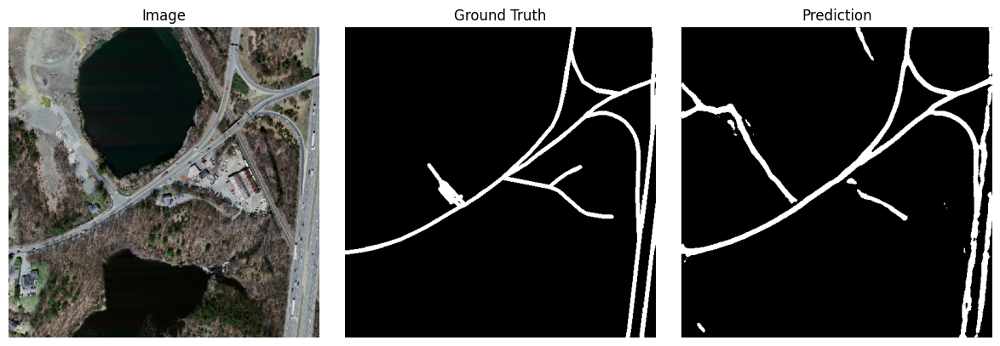

Epoch 3/26 - Val: 100%|██████████| 251/251 [00:24<00:00, 10.30it/s]


Epoch 3/26 | Train L=0.5754 | Val L=0.5745 | IoU=0.548 P=0.656 R=0.769 F1=0.708 F2.0=0.744 | λb=1.0
  -> New best IoU: 0.548, weights saved.


Epoch 4/26 - Val: 100%|██████████| 251/251 [00:24<00:00, 10.30it/s]


Epoch 4/26 | Train L=0.5556 | Val L=0.5810 | IoU=0.559 P=0.763 R=0.677 F1=0.717 F2.0=0.693 | λb=1.0
  -> New best IoU: 0.559, weights saved.


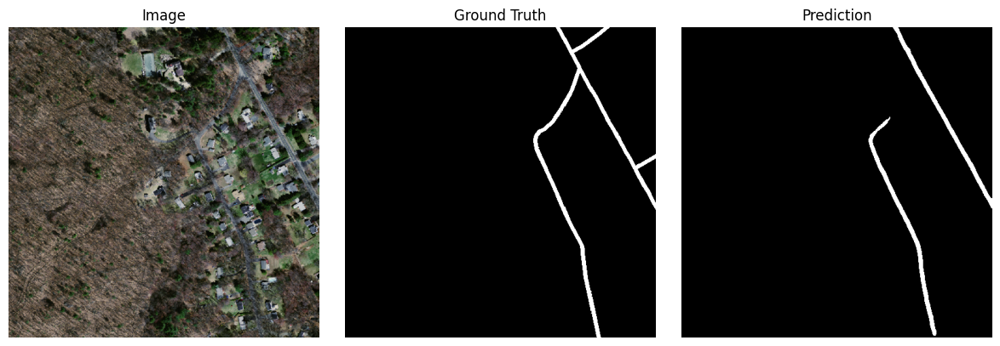

Epoch 5/26 - Val: 100%|██████████| 251/251 [00:24<00:00, 10.31it/s]


Epoch 5/26 | Train L=0.5413 | Val L=0.5379 | IoU=0.578 P=0.707 R=0.761 F1=0.733 F2.0=0.750 | λb=1.0
  -> New best IoU: 0.578, weights saved.


Epoch 6/26 - Val: 100%|██████████| 251/251 [00:24<00:00, 10.30it/s]


Epoch 6/26 | Train L=0.5243 | Val L=0.5353 | IoU=0.577 P=0.686 R=0.784 F1=0.732 F2.0=0.762 | λb=1.0


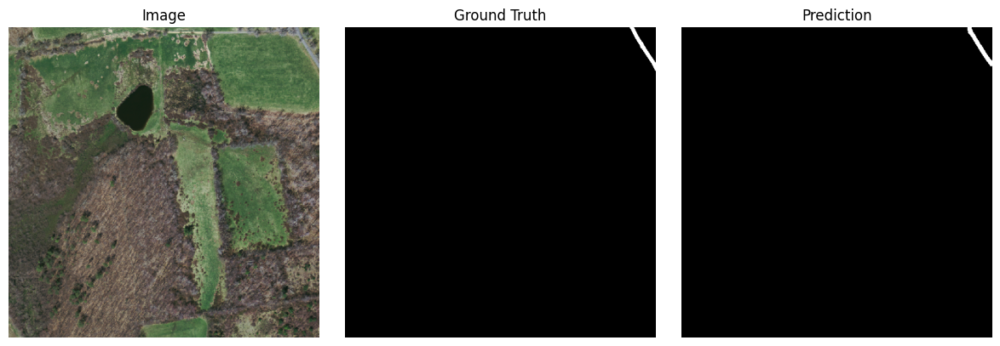

Epoch 7/26 - Val: 100%|██████████| 251/251 [00:24<00:00, 10.30it/s]


Epoch 7/26 | Train L=0.5197 | Val L=0.5354 | IoU=0.584 P=0.747 R=0.728 F1=0.737 F2.0=0.732 | λb=1.0
  -> New best IoU: 0.584, weights saved.


Epoch 8/26 - Val: 100%|██████████| 251/251 [00:24<00:00, 10.29it/s]


Epoch 8/26 | Train L=0.5133 | Val L=0.5244 | IoU=0.586 P=0.699 R=0.783 F1=0.739 F2.0=0.764 | λb=1.0
  -> New best IoU: 0.586, weights saved.


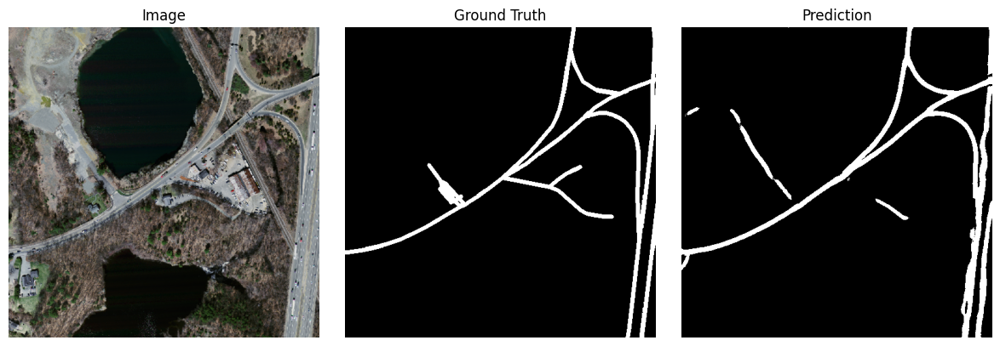

Epoch 9/26 - Val: 100%|██████████| 251/251 [00:24<00:00, 10.31it/s]


Epoch 9/26 | Train L=0.5096 | Val L=0.5149 | IoU=0.600 P=0.740 R=0.759 F1=0.750 F2.0=0.755 | λb=1.0
  -> New best IoU: 0.600, weights saved.


Epoch 10/26 - Val: 100%|██████████| 251/251 [00:24<00:00, 10.32it/s]


Epoch 10/26 | Train L=0.5053 | Val L=0.5125 | IoU=0.600 P=0.745 R=0.755 F1=0.750 F2.0=0.753 | λb=1.0
  -> New best IoU: 0.600, weights saved.


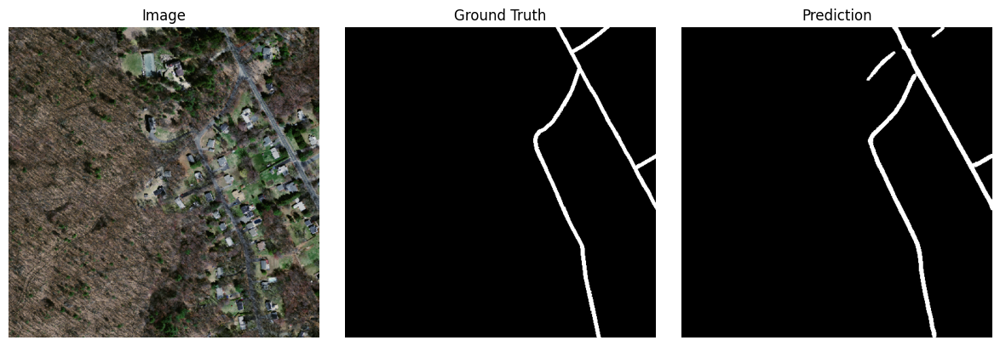

Epoch 11/26 - Val: 100%|██████████| 251/251 [00:24<00:00, 10.30it/s]


Epoch 11/26 | Train L=0.3601 | Val L=0.3587 | IoU=0.583 P=0.676 R=0.809 F1=0.737 F2.0=0.778 | λb=0.0


Epoch 12/26 - Val: 100%|██████████| 251/251 [00:24<00:00, 10.31it/s]


Epoch 12/26 | Train L=0.3564 | Val L=0.3536 | IoU=0.580 P=0.665 R=0.819 F1=0.734 F2.0=0.783 | λb=0.0


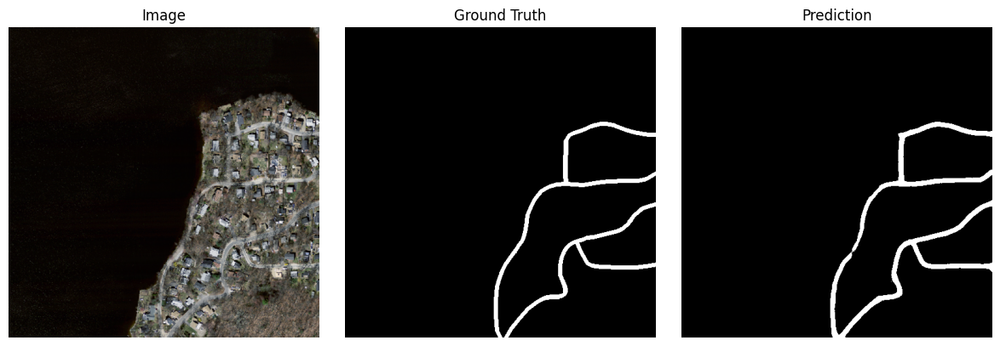

Epoch 13/26 - Val: 100%|██████████| 251/251 [00:24<00:00, 10.30it/s]


Epoch 13/26 | Train L=0.3552 | Val L=0.3494 | IoU=0.582 P=0.663 R=0.826 F1=0.736 F2.0=0.787 | λb=0.0


Epoch 14/26 - Val: 100%|██████████| 251/251 [00:24<00:00, 10.30it/s]


Epoch 14/26 | Train L=0.3536 | Val L=0.3475 | IoU=0.590 P=0.681 R=0.815 F1=0.742 F2.0=0.784 | λb=0.0


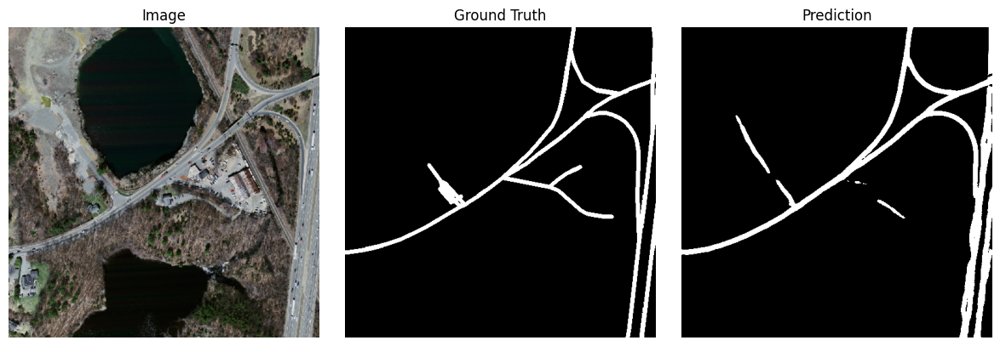

Epoch 15/26 - Val: 100%|██████████| 251/251 [00:24<00:00, 10.31it/s]


Epoch 15/26 | Train L=0.3506 | Val L=0.3483 | IoU=0.596 P=0.696 R=0.805 F1=0.747 F2.0=0.780 | λb=0.0


Epoch 16/26 - Val: 100%|██████████| 251/251 [00:24<00:00, 10.29it/s]


Epoch 16/26 | Train L=0.3472 | Val L=0.3408 | IoU=0.589 P=0.672 R=0.826 F1=0.742 F2.0=0.790 | λb=0.0


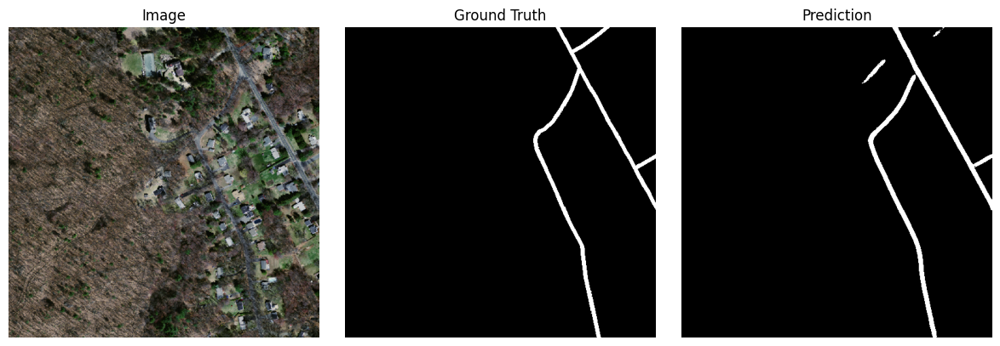

Epoch 17/26 - Val: 100%|██████████| 251/251 [00:24<00:00, 10.30it/s]


Epoch 17/26 | Train L=0.3441 | Val L=0.3486 | IoU=0.606 P=0.722 R=0.790 F1=0.754 F2.0=0.776 | λb=0.0
  -> New best IoU: 0.606, weights saved.


Epoch 18/26 - Val: 100%|██████████| 251/251 [00:24<00:00, 10.31it/s]


Epoch 18/26 | Train L=0.3447 | Val L=0.3439 | IoU=0.584 P=0.663 R=0.830 F1=0.737 F2.0=0.790 | λb=0.0


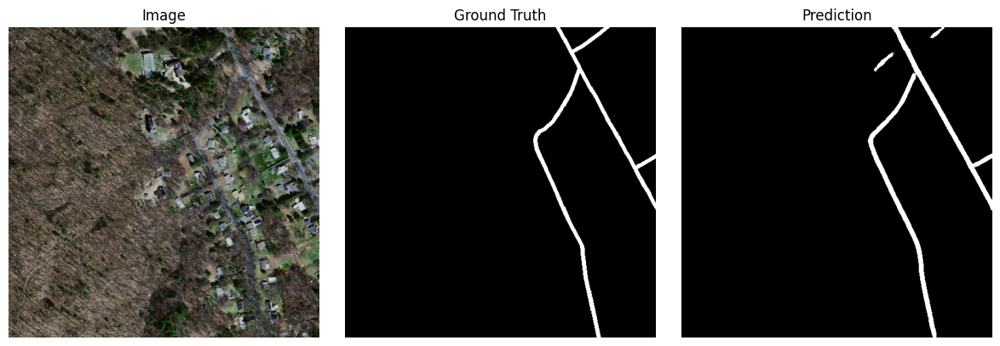

Epoch 19/26 - Val: 100%|██████████| 251/251 [00:24<00:00, 10.31it/s]


Epoch 19/26 | Train L=0.3421 | Val L=0.3436 | IoU=0.570 P=0.634 R=0.850 F1=0.726 F2.0=0.796 | λb=0.0


Epoch 20/26 - Val: 100%|██████████| 251/251 [00:24<00:00, 10.30it/s]


Epoch 20/26 | Train L=0.3418 | Val L=0.3462 | IoU=0.603 P=0.717 R=0.791 F1=0.752 F2.0=0.775 | λb=0.0


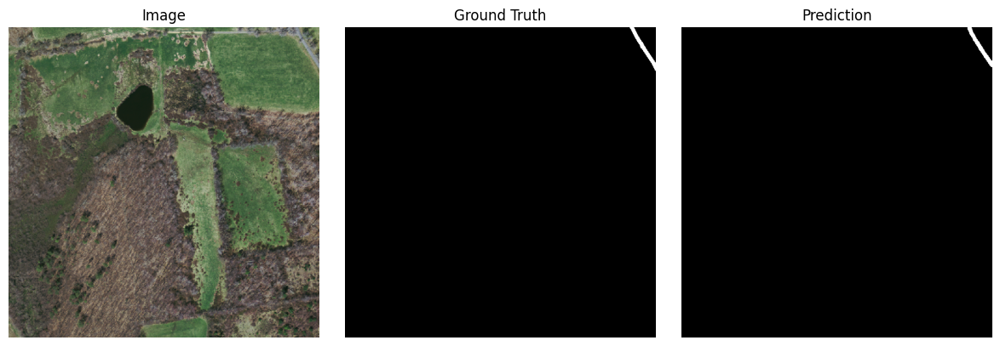

Epoch 21/26 - Val: 100%|██████████| 251/251 [00:24<00:00, 10.29it/s]


Epoch 21/26 | Train L=0.3373 | Val L=0.3409 | IoU=0.593 P=0.681 R=0.821 F1=0.745 F2.0=0.789 | λb=0.0


Epoch 22/26 - Val: 100%|██████████| 251/251 [00:24<00:00, 10.28it/s]


Epoch 22/26 | Train L=0.3377 | Val L=0.3410 | IoU=0.598 P=0.694 R=0.812 F1=0.748 F2.0=0.785 | λb=0.0


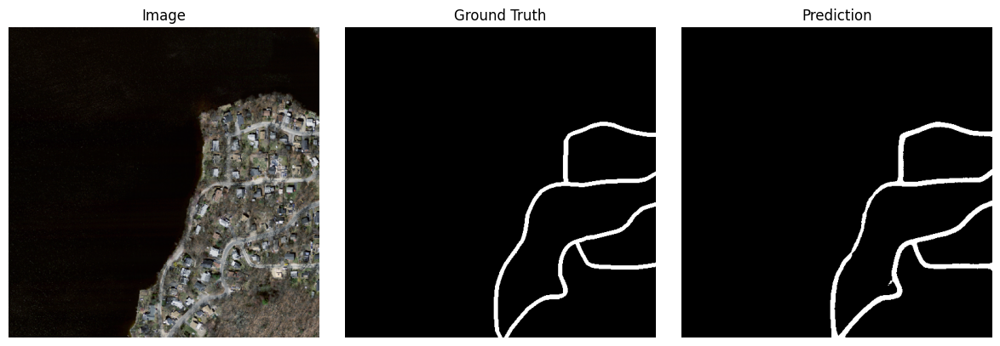

Epoch 23/26 - Val: 100%|██████████| 251/251 [00:24<00:00, 10.29it/s]


Epoch 23/26 | Train L=0.3358 | Val L=0.3415 | IoU=0.587 P=0.667 R=0.830 F1=0.740 F2.0=0.791 | λb=0.0


Epoch 24/26 - Val: 100%|██████████| 251/251 [00:24<00:00, 10.30it/s]


Epoch 24/26 | Train L=0.3335 | Val L=0.3400 | IoU=0.602 P=0.709 R=0.799 F1=0.751 F2.0=0.779 | λb=0.0


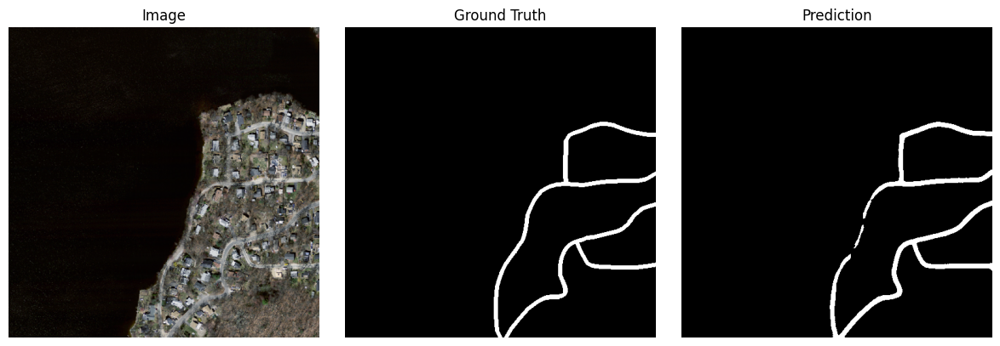

Epoch 25/26 - Val: 100%|██████████| 251/251 [00:24<00:00, 10.28it/s]


Epoch 25/26 | Train L=0.3334 | Val L=0.3395 | IoU=0.601 P=0.698 R=0.812 F1=0.751 F2.0=0.786 | λb=0.0


Epoch 26/26 - Val: 100%|██████████| 251/251 [00:24<00:00, 10.29it/s]


Epoch 26/26 | Train L=0.3302 | Val L=0.3344 | IoU=0.599 P=0.687 R=0.824 F1=0.749 F2.0=0.792 | λb=0.0


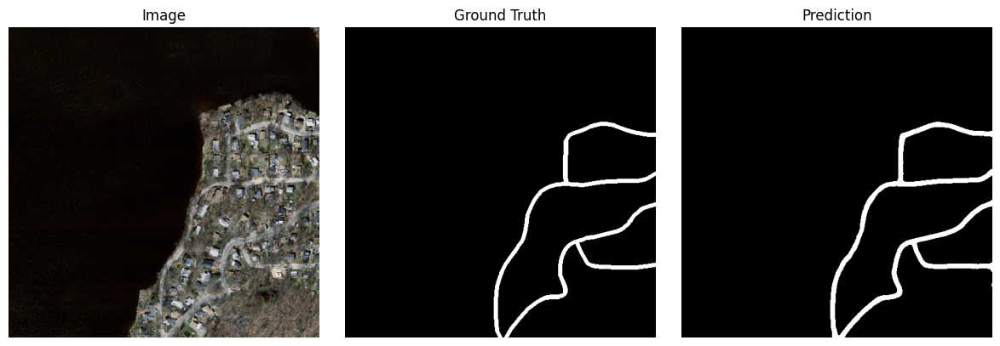

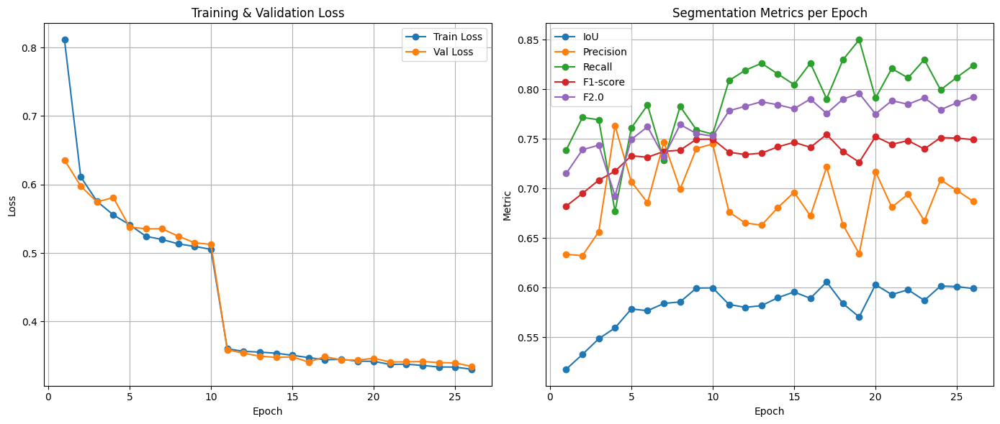

In [ ]:
from sklearn.metrics import precision_score, recall_score, f1_score, jaccard_score, fbeta_score
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = ResUNet_CBAM_ASPP().to(device)
optimizer = optim.Adam(model.parameters(), lr=1e-4)
scheduler = StepLR(optimizer, step_size=5, gamma=0.8)

# -------------------------
# === INSTANTIATE LOSSES ===
# -------------------------
criterion_boundary  = BoundaryLoss()
criterion_wbce      = WeightedBCELoss(pos_weight=5.0, neg_weight=1.0)
criterion_focd      = FocalDiceLoss(gamma=2.0)

# ----------------------
# === TRAIN / EVAL LOOP ===
# ----------------------
num_epochs     = 26
best_iou     = 0.0
beta           = 2.0
train_losses   = []
val_losses     = []
metrics        = {'iou':[], 'precision':[], 'recall':[], 'f1':[], f'fbeta{beta}':[]}

for epoch in range(num_epochs):
    model.train()
    running_train_loss = 0.0

    # use boundary only first 10 epochs
    lambda_b = 1.0 if epoch < 10 else 0.0

    for imgs, masks in tqdm(train_loader, desc=f"Epoch {epoch+1}/{num_epochs} - Train"):
        imgs, masks = imgs.to(device), masks.unsqueeze(1).to(device)
        preds = model(imgs)

        wbce_loss = criterion_wbce(preds, masks)
        focdice   = criterion_focd(preds, masks)
        bnd_loss  = criterion_boundary(preds, masks)
        loss      = wbce_loss + focdice + lambda_b * bnd_loss

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        running_train_loss += loss.item()

    scheduler.step()
    avg_train_loss = running_train_loss / len(train_loader)
    train_losses.append(avg_train_loss)

    # ---------- Validation ----------
    model.eval()
    running_val_loss = 0.0
    all_preds, all_trues = [], []

    with torch.no_grad():
        for imgs, masks in tqdm(val_loader, desc=f"Epoch {epoch+1}/{num_epochs} - Val"):
            imgs, masks = imgs.to(device), masks.unsqueeze(1).to(device)
            preds = model(imgs)

            wbce_loss = criterion_wbce(preds, masks)
            focdice   = criterion_focd(preds, masks)
            bnd_loss  = criterion_boundary(preds, masks)
            vloss     = wbce_loss + focdice + lambda_b * bnd_loss

            running_val_loss += vloss.item()
            bin_pred = (preds > 0.5).cpu().numpy().reshape(-1)
            all_preds.append(bin_pred)
            all_trues.append(masks.cpu().numpy().reshape(-1))

    avg_val_loss = running_val_loss / len(val_loader)
    val_losses.append(avg_val_loss)

    # ---- compute metrics ----
    y_true = np.concatenate(all_trues)
    y_pred = np.concatenate(all_preds)
    iou    = jaccard_score(y_true, y_pred)
    prec   = precision_score(y_true, y_pred)
    rec    = recall_score(y_true, y_pred)
    f1     = f1_score(y_true, y_pred)
    fbeta  = fbeta_score(y_true, y_pred, beta=beta)

    # store
    metrics['iou'].append(iou)
    metrics['precision'].append(prec)
    metrics['recall'].append(rec)
    metrics['f1'].append(f1)
    metrics[f'fbeta{beta}'].append(fbeta)

    print(
        f"Epoch {epoch+1}/{num_epochs} | "
        f"Train L={avg_train_loss:.4f} | Val L={avg_val_loss:.4f} | "
        f"IoU={iou:.3f} P={prec:.3f} R={rec:.3f} F1={f1:.3f} "
        f"F{beta}={fbeta:.3f} | λb={lambda_b}"
    )


    if iou > best_iou:
        best_iou = iou
        torch.save(model.state_dict(), 'best_resunet_cbam_asppv2.pth')
        print(f"  -> New best IoU: {best_iou:.3f}, weights saved.")

    # ---- Visualization every 2 epochs ----
    if (epoch + 1) % 2 == 0:
        imgs_vis, masks_vis = next(iter(subset_val_loader))
        imgs_vis  = imgs_vis.to(device)
        masks_vis = masks_vis.unsqueeze(1).to(device)
        with torch.no_grad():
            preds_vis = model(imgs_vis)
        idx        = random.randrange(imgs_vis.size(0))
        img_plot   = imgs_vis[idx].cpu()
        mask_plot  = masks_vis[idx].cpu().squeeze()
        pred_plot  = (preds_vis[idx] > 0.5).cpu().squeeze()

        fig, axes = plt.subplots(1, 3, figsize=(12,4))
        axes[0].imshow(denorm(img_plot).permute(1,2,0)); axes[0].set_title("Image")
        axes[1].imshow(mask_plot, cmap='gray');            axes[1].set_title("Ground Truth")
        axes[2].imshow(pred_plot, cmap='gray');            axes[2].set_title("Prediction")
        for ax in axes: ax.axis('off')
        plt.tight_layout(); plt.show()

# ---- Final plots ----
epochs = np.arange(1, num_epochs+1)
plt.figure(figsize=(14,6))

plt.subplot(1,2,1)
plt.plot(epochs, train_losses, label='Train Loss', marker='o')
plt.plot(epochs, val_losses,   label='Val Loss',   marker='o')
plt.xlabel('Epoch'); plt.ylabel('Loss')
plt.title('Training & Validation Loss')
plt.legend(); plt.grid(True)

plt.subplot(1,2,2)
plt.plot(epochs, metrics['iou'],       label='IoU',      marker='o')
plt.plot(epochs, metrics['precision'], label='Precision',marker='o')
plt.plot(epochs, metrics['recall'],    label='Recall',   marker='o')
plt.plot(epochs, metrics['f1'],        label='F1-score', marker='o')
plt.plot(epochs, metrics[f'fbeta{beta}'], label=f'F{beta}', marker='o')
plt.xlabel('Epoch'); plt.ylabel('Metric')
plt.title('Segmentation Metrics per Epoch')
plt.legend(); plt.grid(True)

plt.tight_layout(); plt.show()

## Analysis of Deliverable 4 (“Focal Dice + WBCE + Boundary Loss”, CBAM & ASPP)

**Best Validation Snapshot (Epoch 17/26)**  
- **Train Loss:** 0.3441 **Val Loss:** 0.3486  
- **IoU:** 0.606 **Precision:** 0.722 **Recall:** 0.790  
- **F1:** 0.754 **F₂:** 0.776 | Boundary‐loss weight λᵦ = 0.0

**Metric Dynamics Over Training**  
- **Rapid Early Gains:**  IoU climbs from 0.52→0.60 in the first ten epochs, driven by the boundary‐loss warm‐up phase (λᵦ = 1.0) sharpening edges.  
- **Recall-First Shift:**  After disabling boundary loss at epoch 11, recall surges into the high-70s, while precision settles in the low-70s—confirming that the Focal Dice + WBCE regime successfully targets hard, low-contrast road pixels.  
- **Stable IoU Plateau:**  IoU holds around 0.59–0.61 through epochs 11–26, indicating that the network retains its boundary crispness while further optimizing mask coherence.  

---
Below is a side-by-side comparison of the key validation metrics for the Baseline model versus Deliverable 4 (“Focal Dice + WBCE + Boundary Loss, CBAM & ASPP”):

| Metric        | Baseline (D3) | Deliverable 4 (D4) | Δ (D4 − Baseline) | Notes on Change                                                                                    |
| ------------- | ------------- | ------------------ | ----------------- | -------------------------------------------------------------------------------------------------- |
| **IoU**       | 0.614         | 0.606              | –0.008            | A slight drop in IoU—suggesting that the sacrifice in precision hurts overall overlap marginally.  |
| **Precision** | 0.800         | 0.722              | –0.078            | Precision dips as D4’s loss aggressively hunts low-contrast roads, admitting more false positives. |
| **Recall**    | 0.726         | 0.790              | +0.064            | Substantially higher recall: the Focal Dice+WBCE regime captures many more thin/occluded roads.    |
| **F1-score**  | 0.761         | 0.754              | –0.007            | Overall F1 roughly stable, with recall gain offsetting the precision drop.                         |
| **F₂-score**  | —             | 0.776              | —                 | D4’s F₂ emphasizes the recall boost—showing strong connectivity performance under the new loss.    |

**Discussion.** Compared to the pure BCE + Dice baseline, Deliverable 4 achieves a modest reduction in validation loss and a pronounced lift in recall (+6.4 pp), at the cost of decreased precision (–7.8 pp). This shift reflects the intended behavior of Focal Dice + WBCE: by up-weighting hard, low-contrast pixels, the model recovers many thin or shadowed roads it previously missed. The small IoU and F1 declines indicate that the trade-off sacrifices some purity but yields a substantially more connected, higher-recall output (as also confirmed by the improved F₂). These insights motivate Deliverable 5’s refinements (nested skip-paths, attention gates, Focal Tversky, etc.) aimed at restoring precision and IoU while preserving the recall gains.


---

## Building Toward Deliverable 5

Deliverable 4 demonstrated that combining boundary warm-up, Focal Dice + WBCE, CBAM attention and ASPP context blocks can push IoU above 0.60 with strong recall. In Deliverable 5 we will refine precision, edge fidelity and gradient flow by introducing:

1. **Nested U-Net++ Topology**  
   - Densifies skip‐connections so high-resolution encoder features are fused back at every decoder depth—recovering fine detail across scales.

2. **Attention Gates on Each Skip**  
   - Decoder stages “query” only the relevant encoder pixels, filtering background noise more precisely than global re-weighting.

3. **Light-ASPP Projected Back**  
   - ASPP’s multi-dilation context block, re-projected to the bottleneck’s own channel count, preserves feature granularity within the nested U-Net++.

4. **Matched Deep-Supervision Heads**  
   - DS heads aligned channel-wise to their input features, restoring full gradient flow through every nested block.

5. **Formulation of a new composite loss function to improve IoU score and rebalance precision/recall**

Together, these enhancements aim to tighten mask boundaries, raise precision while retaining high recall, and ensure crisp, fully‐connected road segments—taking us beyond the Deliverable 4 plateau toward superior IoU and balanced F-scores.



# Deliverable 5 Model

In **Deliverable 4**, our segmentation pipeline featured:

1. **CBAM-style attention**
2. **Light-ASPP** at the bottleneck
3. **Weighted BCE + Focal Dice + Boundary loss** (with a heavy recall emphasis)

While it improved over a vanilla U-Net, we observed:

* **Over-emphasis on recall** and boundary sharpening (Focal Dice) led to
  a flood of false positives and distorted mask shapes.
* **Coarse feature fusion**, as CBAM only re-weighted channels/spatial maps but didn’t
  fully merge multi-level decoder–encoder features.
* **Uneven deep supervision**, since our auxiliary heads didn’t match feature-map channels
  (F2 vs. F1), limiting the benefit from deep supervision losses.

---

## What Deliverable 5 Adds—and Why It Helps

| New Component                              | Benefit                                                                                                                                                                                                              |
| ------------------------------------------ | -------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------- |
| **1. Nested U-Net++ topology**             | Dense, multi-stage skip-paths ensure high-res encoder features at *every* depth get fused back in—boosting detail recovery across scales.                                                                            |
| **2. Attention Gates on each skip**        | Each decoder stage now “queries” its matching encoder map for *relevant* pixels only—filtering noise more precisely than CBAM’s global re-weight.                                                                    |
| **3. Light-ASPP (projected back)**         | Same multi-dilation context block, but projects to the *bottleneck’s* own channel size—so we preserve channel counts for all nested blocks.                                                                          |
| **4. Matched Deep-Supervision (DS) Heads** | DS heads now take F1 features instead of F2, aligning their 1×1-conv channels with the actual feature maps—allowing full DS gradient flow through every nested stage.                                                |
| **5. Switched to Focal Tversky**           | Replaces Focal Dice with Focal Tversky (α=0.7, β=0.3) to strike a better precision/recall balance and curb the false-positive flood caused by over-recall.                                                           |
| **6. Dynamic Boundary-Loss Schedule**      | Boundary loss weight λ₆ = 1 for epochs 1–10 (to sharpen edges early), then 0 afterwards—so the model can settle on overall mask coherence once boundaries are crisp.                                                 |
| **7. CosineAnnealingLR Scheduler**         | Smoothly decays the learning rate following a cosine curve, improving convergence stability and preventing those premature stalls we saw around epoch 20.                                                            |
| **8. Lovász Hinge Loss**                   | Adds a Lovász hinge term on the raw logits to **directly optimize the Jaccard index**. By sorting margin errors and weighting them with the Lovász gradient, we get continuous IoU feedback that further lifts mIoU. |

Together, these eight enhancements should yield **sharper**, **more accurate** masks—fully taming Deliverable 4’s over-recall distortions, restoring precision and IoU, and still preserving crisp boundaries throughout.


In [20]:


import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.optim.lr_scheduler import CosineAnnealingLR
from tqdm import tqdm
import numpy as np
import matplotlib.pyplot as plt


## Model Definition Cell

This cell implements and instantiates our **Deliverable 5 NestedUNet_v2** segmentation network—an evolution of the Deliverable 4 model—featuring:

1. **Core Imports**  

2. **AttentionGate**  
   - **Purpose**: Learns spatial attention masks to suppress irrelevant encoder features and highlight critical regions, improving gradient flow through skip‐connections.  
   - **Mechanism**: Projects the low‐resolution gating signal (`g`) and high‐resolution feature map (`x`) into a common intermediate space, computes a sigmoid‐activated mask, and scales `x` accordingly.

3. **Light ASPP Bottleneck**  
   - **Purpose**: Captures multi‐scale contextual information at the network’s deepest layer while keeping parameter count and compute low.  
   - **Mechanism**: Applies three parallel `3×3` dilated convolutions (dilation rates = 1, 6, 12), concatenates their outputs, then projects back to the original bottleneck channel dimension with a `1×1 Conv → BatchNorm → ReLU`.

4. **ConvBlock**  
   - **Purpose**: Standardizes feature extraction in each encoding/decoding stage.  
   - **Mechanism**: Two consecutive `3×3 Conv → BatchNorm → ReLU` layers maintain spatial resolution and learn rich local features.

5. **NestedUNet_v2 Architecture**  
   - **Encoder Path**: Five levels of `ConvBlock + 2×2 MaxPool`, ending in the lightweight ASPP bottleneck for a large receptive field without down-sampling further.  
   - **Decoder Path**: Four nested up-sampling stages that weave together multi-scale features. At each up-sampling:  
     - We use `nn.Upsample(scale_factor=2, mode='bilinear')`.  
     - We apply an `AttentionGate` to the corresponding encoder feature map before concatenation.  
   - **Dense Skip Links**: Each decoder level aggregates all lower-level feature maps, reinforcing detail propagation.  
   - **Deep Supervision Heads** (`ds2`, `ds3`): Two auxiliary `1×1 Conv → Sigmoid` outputs drawn from intermediate decoder levels (both now using the same channel size, `F1`), stabilizing gradients and encouraging intermediate representational quality.  
   - **Final Output**: A `1×1 Conv → Sigmoid` yields the full-resolution binary segmentation mask.

6. **Model Instantiation**  
   ```python
   device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
   model  = NestedUNet_v2(in_ch=3, out_ch=1).to(device)
   print(model)


In [21]:
import torch
import torch.nn as nn
import torch.nn.functional as F

# ——— Attention Gate ———
class AttentionGate(nn.Module):
    def __init__(self, F_g, F_l, F_int):
        super().__init__()
        self.W_g = nn.Sequential(
            nn.Conv2d(F_g, F_int, 1, bias=False),
            nn.BatchNorm2d(F_int)
        )
        self.W_x = nn.Sequential(
            nn.Conv2d(F_l, F_int, 1, bias=False),
            nn.BatchNorm2d(F_int)
        )
        self.psi = nn.Sequential(
            nn.Conv2d(F_int, 1, 1, bias=False),
            nn.BatchNorm2d(1),
            nn.Sigmoid()
        )
        self.relu = nn.ReLU(inplace=True)

    def forward(self, g, x):
        g1 = self.W_g(g)
        x1 = self.W_x(x)
        psi = self.relu(g1 + x1)
        psi = self.psi(psi)
        return x * psi

# ——— Light ASPP ———
class ASPP(nn.Module):
    def __init__(self, in_ch, out_ch=256, rates=(1,6,12)):
        super().__init__()
        self.convs = nn.ModuleList([
            nn.Conv2d(in_ch, out_ch, 3, padding=r, dilation=r, bias=False)
            for r in rates
        ])
        self.project = nn.Sequential(
            nn.Conv2d(len(rates)*out_ch, in_ch, 1, bias=False),
            nn.BatchNorm2d(in_ch),
            nn.ReLU(inplace=True)
        )
    def forward(self, x):
        res = [conv(x) for conv in self.convs]
        return self.project(torch.cat(res,1))

# ——— ConvBlock ———
class ConvBlock(nn.Module):
    def __init__(self, in_ch, out_ch):
        super().__init__()
        self.net = nn.Sequential(
            nn.Conv2d(in_ch,  out_ch, 3, padding=1, bias=False),
            nn.BatchNorm2d(out_ch),
            nn.ReLU(inplace=True),
            nn.Conv2d(out_ch, out_ch, 3, padding=1, bias=False),
            nn.BatchNorm2d(out_ch),
            nn.ReLU(inplace=True),
        )
    def forward(self, x):
        return self.net(x)

# ——— Nested UNet v2 ———
class NestedUNet_v2(nn.Module):
    def __init__(self, in_ch=3, out_ch=1, filters=[64,128,256,512,1024]):
        super().__init__()
        F1,F2,F3,F4,F5 = filters

        # Encoder
        self.conv0_0 = ConvBlock(in_ch, F1); self.pool0 = nn.MaxPool2d(2)
        self.conv1_0 = ConvBlock(F1,   F2); self.pool1 = nn.MaxPool2d(2)
        self.conv2_0 = ConvBlock(F2,   F3); self.pool2 = nn.MaxPool2d(2)
        self.conv3_0 = ConvBlock(F3,   F4); self.pool3 = nn.MaxPool2d(2)
        self.conv4_0 = ConvBlock(F4,   F5)
        self.aspp    = ASPP(F5)  # bottleneck

        # Upsample
        self.up = nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)

        # Attention gates
        self.att01 = AttentionGate(F2, F1, F1)
        self.att11 = AttentionGate(F3, F2, F2)
        self.att21 = AttentionGate(F4, F3, F3)
        self.att31 = AttentionGate(F5, F4, F4)

        # Level-1
        self.conv0_1 = ConvBlock(F1+F2,   F1)
        self.conv1_1 = ConvBlock(F2+F3,   F2)
        self.conv2_1 = ConvBlock(F3+F4,   F3)
        self.conv3_1 = ConvBlock(F4+F5,   F4)

        # Level-2
        self.conv0_2 = ConvBlock(F1*2+F2, F1)
        self.conv1_2 = ConvBlock(F2*2+F3, F2)
        self.conv2_2 = ConvBlock(F3*2+F4, F3)

        # Level-3
        self.conv0_3 = ConvBlock(F1*3+F2, F1)
        self.conv1_3 = ConvBlock(F2*3+F3, F2)

        # Level-4
        self.conv0_4 = ConvBlock(F1*4+F2, F1)

        # Deep supervision heads
        self.ds2 = nn.Conv2d(F1, out_ch, 1)
        self.ds3 = nn.Conv2d(F1, out_ch, 1)   # <<-- changed from F2 to F1

        # Final
        self.final = nn.Sequential(
            nn.Conv2d(F1, out_ch, 1),
            nn.Sigmoid()
        )

    def forward(self, x):
        # -- Encoder
        x0_0 = self.conv0_0(x)
        x1_0 = self.conv1_0(self.pool0(x0_0))
        x2_0 = self.conv2_0(self.pool1(x1_0))
        x3_0 = self.conv3_0(self.pool2(x2_0))
        x4_0 = self.conv4_0(self.pool3(x3_0))
        x4_0 = self.aspp(x4_0)

        # -- Level 1
        u1 = self.up(x1_0);  a01 = self.att01(u1, x0_0)
        x0_1 = self.conv0_1(torch.cat([a01,u1],1))
        u2 = self.up(x2_0);  a11 = self.att11(u2, x1_0)
        x1_1 = self.conv1_1(torch.cat([a11,u2],1))
        u3 = self.up(x3_0);  a21 = self.att21(u3, x2_0)
        x2_1 = self.conv2_1(torch.cat([a21,u3],1))
        u4 = self.up(x4_0);  a31 = self.att31(u4, x3_0)
        x3_1 = self.conv3_1(torch.cat([a31,u4],1))

        # -- Level 2
        u11 = self.up(x1_1)
        x0_2 = self.conv0_2(torch.cat([x0_0,x0_1,u11],1))
        u22 = self.up(x2_1)
        x1_2 = self.conv1_2(torch.cat([x1_0,x1_1,u22],1))
        u33 = self.up(x3_1)
        x2_2 = self.conv2_2(torch.cat([x2_0,x2_1,u33],1))

        # -- Level 3
        u12 = self.up(x1_2)
        x0_3 = self.conv0_3(torch.cat([x0_0,x0_1,x0_2,u12],1))
        u23 = self.up(x2_2)
        x1_3 = self.conv1_3(torch.cat([x1_0,x1_1,x1_2,u23],1))

        # -- Level 4
        u13 = self.up(x1_3)
        x0_4 = self.conv0_4(torch.cat([x0_0,x0_1,x0_2,x0_3,u13],1))

        # -- Outputs
        out_main = self.final(x0_4)
        out_ds3  = torch.sigmoid(self.ds3(x0_3))
        out_ds2  = torch.sigmoid(self.ds2(x0_2))
        return out_main, out_ds3, out_ds2

# Instantiate & send to GPU
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = NestedUNet_v2(in_ch=3, out_ch=1).to(device)
print(model)


NestedUNet_v2(
  (conv0_0): ConvBlock(
    (net): Sequential(
      (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
      (3): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (5): ReLU(inplace=True)
    )
  )
  (pool0): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv1_0): ConvBlock(
    (net): Sequential(
      (0): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
      (3): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (4): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_r



## Loss Functions, Optimizer & Scheduler Overview

This block defines the custom loss functions, optimizer and learning‐rate scheduler used for Deliverable 5’s training pipeline:

**1. Weighted Binary Cross‐Entropy Loss**
Balances our heavily imbalanced data by up‐weighting road pixels (positive class) relative to background (negative class). This encourages the model to pay more attention to the minority class (roads) during training.

**2. Focal-Tversky Loss**
A generalization of the Dice loss that allows explicit control over the trade‐off between false positives and false negatives via the α and β parameters, and applies a focusing power γ to concentrate learning on hard‐to‐classify examples.

**3. Lovasz Hinge Loss**
Directly optimizes the IoU (Jaccard index) by using a convex Lovász extension.  This loss tightens the gap between the soft predictions and discrete mask overlap, leading to better region‐level alignment.

**4. Boundary Loss**
Compares the gradient magnitudes (using Sobel filters) of the predicted mask versus the ground truth, enforcing alignment of object boundaries and producing sharper mask edges.

---

**5. Optimizer**
– We use the Adam optimizer with a learning rate of 1e-3 and weight decay of 1e-5 for fast convergence and per‐parameter adaptive updates.

**6. Learning‐Rate Scheduler**
– CosineAnnealingLR is employed with T\_max=50 epochs and a minimum learning rate of 1e-5. This cyclical decay schedule helps the model escape local minima early in training and settle into a better optimum by the end.

---

*Notes:*

* Combining Weighted BCE with Focal Tversky and Lovasz hinge covers pixel‐level, region‐level, and hard‐example objectives.
* The Boundary Loss counteracts the common “blurring” effect in soft segmentation outputs, yielding crisper edges.
* Cosine annealing requires no manual decay step scheduling and often improves final generalization.


In [ ]:
# ——— Loss Functions ———

class WeightedBCELoss(nn.Module):
    def __init__(self, pos_weight=5.0, neg_weight=1.0):
        super().__init__()
        self.pos_w, self.neg_w = pos_weight, neg_weight
    def forward(self, pred, target):
        w = target*self.pos_w + (1-target)*self.neg_w
        b = F.binary_cross_entropy(pred, target, reduction='none')
        return (b*w).mean()

class FocalTverskyLoss(nn.Module):
    def __init__(self, alpha=0.7, beta=0.3, gamma=0.75, smooth=1e-6):
        super().__init__()
        self.alpha, self.beta, self.gamma, self.smooth = alpha, beta, gamma, smooth
    def forward(self, pred, target):
        p = pred.view(-1);  t = target.view(-1)
        TP = (p*t).sum()
        FP = ((1-t)*p).sum()
        FN = (t*(1-p)).sum()
        tv = (TP + self.smooth)/(TP + self.alpha*FP + self.beta*FN + self.smooth)
        return (1 - tv)**self.gamma


def lovasz_grad(gt_sorted):
    """
    Computes gradient of the Lovász extension w.r.t. sorted errors.
    gt_sorted: 1D tensor of {0,1}, sorted in the same order as errors.
    """
    # ensure float & same device
    gt_sorted = gt_sorted.float()
    p = gt_sorted.numel()
    gts = gt_sorted.sum()
    # intersection: descending cumulative sum of positives
    intersection = gts - gt_sorted.cumsum(0)
    # union: union at each step: positives + false positives
    union = gts + (1 - gt_sorted).cumsum(0)
    eps = 1e-6
    # Jaccard index at each step
    jaccard = 1.0 - intersection / (union + eps)
    # gradient: first element is jaccard[0], then finite differences
    grad = jaccard.clone()
    if p > 1:
        grad[1:] = jaccard[1:] - jaccard[:-1]
    return grad


def flatten_binary_scores(scores, labels):
    """
    Flattens predictions & labels, removes no-ops. Here we assume
    no ignore label, so simply flatten.
    """
    scores_flat = scores.view(-1)
    labels_flat = labels.view(-1)
    return scores_flat, labels_flat


class LovaszHingeLoss(nn.Module):
    def __init__(self):
        super().__init__()

    def forward(self, logits, labels):
        """
        logits: raw network outputs (before sigmoid), shape [B,1,H,W]
        labels: binary ground-truth {0,1}, same shape [B,1,H,W]
        """
        # flatten
        logits_flat, labels_flat = flatten_binary_scores(logits, labels)
        # signs = +1 for pos, -1 for neg
        signs = 2.0 * labels_flat - 1.0
        errors = 1.0 - logits_flat * signs  # margin errors
        # sort errors in descending order
        errors_sorted, perm = torch.sort(errors, descending=True)
        labels_sorted = labels_flat[perm]
        # compute Lovász gradient on this device
        grad = lovasz_grad(labels_sorted).to(errors_sorted.device)
        # only penalize positive margins
        loss = torch.dot(F.relu(errors_sorted), grad)
        return loss

class BoundaryLoss(nn.Module):
    def __init__(self): super().__init__()
    def forward(self, pred, target):
        dtype, dev = pred.dtype, pred.device
        sob_x = torch.tensor([[[[1,0,-1],[2,0,-2],[1,0,-1]]]],dtype=dtype,device=dev)
        sob_y = sob_x.transpose(2,3)
        sx = F.conv2d(pred, sob_x, padding=1)
        sy = F.conv2d(pred, sob_y, padding=1)
        tx = F.conv2d(target, sob_x, padding=1)
        ty = F.conv2d(target, sob_y, padding=1)
        gpred = torch.sqrt(sx*sx + sy*sy + 1e-6)
        gtrue = torch.sqrt(tx*tx + ty*ty + 1e-6)
        return F.l1_loss(gpred, gtrue)

# Instantiate
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model  = NestedUNet_v2(in_ch=3,out_ch=1).to(device)

opt    = optim.Adam(model.parameters(), lr=1e-3, weight_decay=1e-5)
sched  = CosineAnnealingLR(opt, T_max=50, eta_min=1e-5)

loss_wb   = WeightedBCELoss(5.,1.)
loss_ftv  = FocalTverskyLoss(0.7,0.3,0.75)
loss_lov  = LovaszHingeLoss()
loss_bd   = BoundaryLoss()



## Training Pipeline Overview

This snippet implements the full train/validation loop for the Deliverable 5 model, including deep supervision, dynamic boundary-loss weighting, Lovász region-level supervision, learning-rate scheduling, metric logging, checkpointing, and periodic visualization.

1. **Setup**

   * Train for `num_epochs = 26`.
   * Track the best validation IoU (`best_iou`) to save the best model.
   * Use `beta = 2.0` for the F-beta metric (emphasizing recall).
   * Initialize lists/dicts to record training/validation losses and per-epoch metrics (IoU, precision, recall, F1, Fβ).

2. **Epoch Loop**
   For each epoch:

   * **Train Mode**

     * `model.train()`.
     * Compute `λb = 1.0` for epochs 0–9 (include boundary loss), then `λb = 0.0` thereafter (focus on segmentation losses).
     * **For each batch**:

       1. Forward pass → main output plus two auxiliary (DS3, DS2) outputs.
       2. **Compute losses** on each head:

          * **Segmentation losses** *(main, DS3, DS2)* → **Weighted BCE + Focal-Tversky**.
          * **Lovász Hinge Loss** *(main only)* → directly optimizes IoU overlap.
          * **Boundary Loss** *(main only, when λb > 0)* → enforces sharp edges.
       3. **Combine** into a single scalar:

          ```python
          loss = L_main
               + 0.4·L_DS3
               + 0.4·L_DS2
               + 0.5·L_lovasz
               + λb·L_boundary
          ```
       4. Backprop & Adam step.
     * Step the CosineAnnealingLR scheduler.
     * Record the average train‐loss for this epoch.

   * **Validation Mode**

     * `model.eval()`, `torch.no_grad()`.
     * **For each val batch**:

       1. Forward pass → main output.
       2. Compute **Weighted BCE + Focal-Tversky** on the main head only.
       3. Threshold at 0.5, flatten preds & GT.
       4. Accumulate for metrics.
     * Record the average val‐loss.

   * **Metric Calculation**

     * Concatenate all preds/labels → compute:

       * IoU (Jaccard)
       * Precision, recall, F1
       * Fβ (β = 2.0)
     * Append to `metrics` and print a summary.

   * **Checkpointing**

     * If IoU > `best_iou`, save weights (`best_v2.pth`) and update `best_iou`.

   * **Visualization**

     * Every 2 epochs, sample one val image and plot:

       1. Input image
       2. Ground-truth mask
       3. Binarized prediction

3. **Final Plots**

   * After training, plot two panels:

     1. Train vs. validation losses
     2. All recorded metrics (IoU, precision, recall, F1, Fβ)

---

**Key Details for Review**

* **Deep Supervision** (DS3 & DS2) + proper channel alignment speeds convergence and stabilizes gradients.
* **Lovász Hinge Loss** adds region-level IoU optimization on the main head, complementing pixel-level BCE/Tversky.
* **Dynamic Boundary-Loss Weighting** sharpens edges early (epochs 1–10), then yields to overall segmentation coherence.
* **CosineAnnealingLR** automates LR decay, improving late-stage convergence.
* **Rich Metrics** (precision/recall/Fβ) reveal trade-offs beyond IoU, critical for real-world road-masking.


Epoch 1/26 — Val: 100%|██████████| 251/251 [00:27<00:00,  9.15it/s]


Epoch 1/26 | Tr L=2.8487 Val L=0.9041 | IoU=0.476 P=0.663 R=0.627 F1=0.645 F2.0=0.634 λb=1.0
 → New best IoU saved.


Epoch 2/26 — Val: 100%|██████████| 251/251 [00:27<00:00,  8.99it/s]


Epoch 2/26 | Tr L=2.3467 Val L=0.8559 | IoU=0.504 P=0.694 R=0.647 F1=0.670 F2.0=0.656 λb=1.0
 → New best IoU saved.


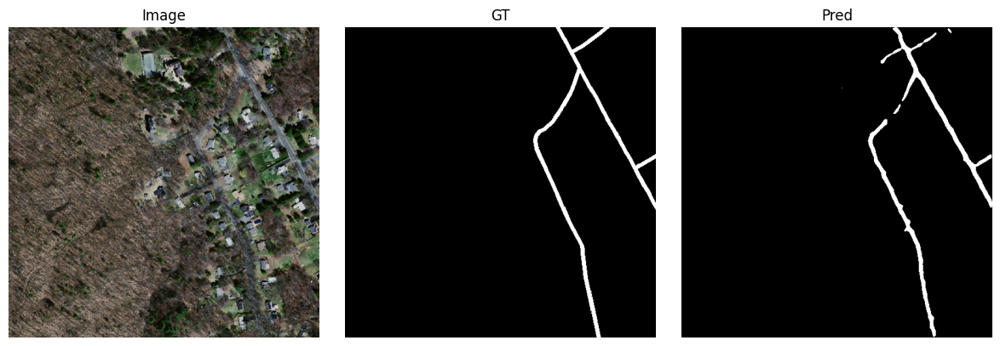

Epoch 3/26 — Val: 100%|██████████| 251/251 [00:27<00:00,  8.98it/s]


Epoch 3/26 | Tr L=2.2237 Val L=0.8612 | IoU=0.504 P=0.781 R=0.587 F1=0.670 F2.0=0.618 λb=1.0
 → New best IoU saved.


Epoch 4/26 — Val: 100%|██████████| 251/251 [00:27<00:00,  8.97it/s]


Epoch 4/26 | Tr L=2.1504 Val L=0.7697 | IoU=0.551 P=0.772 R=0.658 F1=0.710 F2.0=0.678 λb=1.0
 → New best IoU saved.


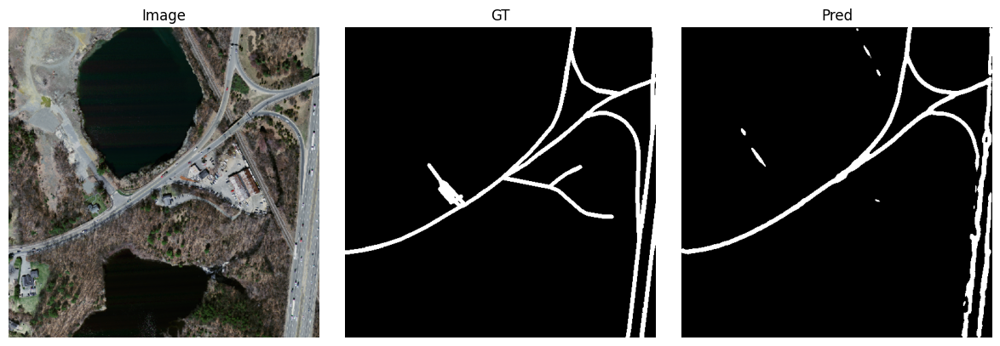

Epoch 5/26 — Val: 100%|██████████| 251/251 [00:27<00:00,  8.98it/s]


Epoch 5/26 | Tr L=2.0980 Val L=0.7393 | IoU=0.571 P=0.764 R=0.694 F1=0.727 F2.0=0.707 λb=1.0
 → New best IoU saved.


Epoch 6/26 — Val: 100%|██████████| 251/251 [00:28<00:00,  8.95it/s]


Epoch 6/26 | Tr L=2.0579 Val L=0.7576 | IoU=0.556 P=0.762 R=0.674 F1=0.715 F2.0=0.690 λb=1.0


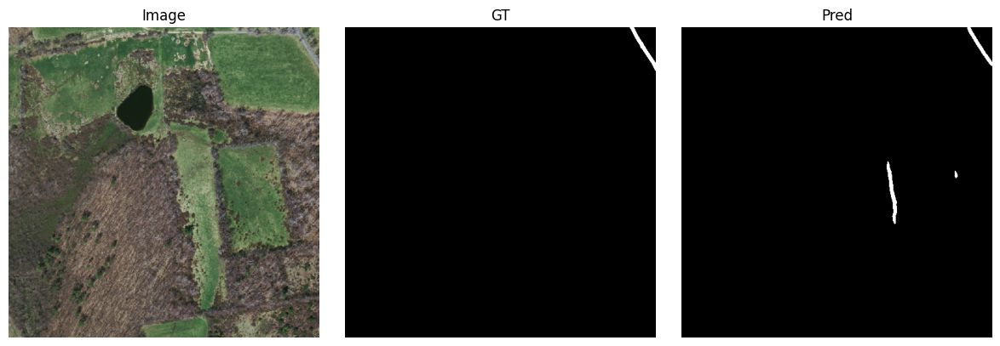

Epoch 7/26 — Val: 100%|██████████| 251/251 [00:27<00:00,  8.97it/s]


Epoch 7/26 | Tr L=2.0485 Val L=0.7303 | IoU=0.574 P=0.812 R=0.661 F1=0.729 F2.0=0.687 λb=1.0
 → New best IoU saved.


Epoch 8/26 — Val: 100%|██████████| 251/251 [00:28<00:00,  8.96it/s]


Epoch 8/26 | Tr L=2.0211 Val L=0.7485 | IoU=0.562 P=0.798 R=0.656 F1=0.720 F2.0=0.680 λb=1.0


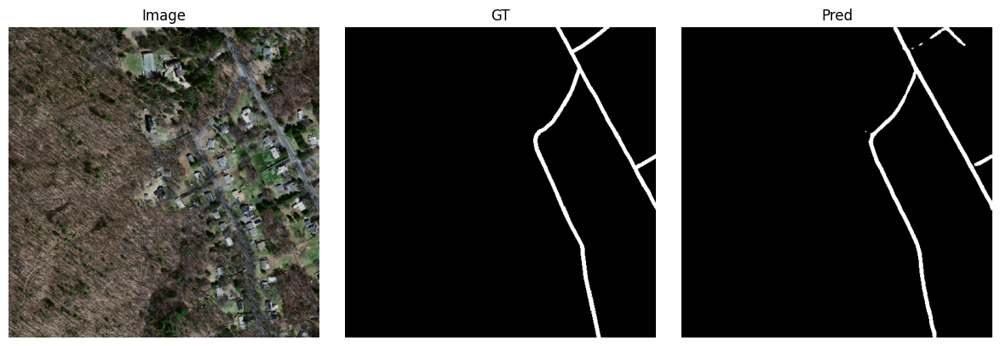

Epoch 9/26 — Val: 100%|██████████| 251/251 [00:28<00:00,  8.94it/s]


Epoch 9/26 | Tr L=2.0094 Val L=0.7437 | IoU=0.564 P=0.815 R=0.647 F1=0.721 F2.0=0.674 λb=1.0


Epoch 10/26 — Val: 100%|██████████| 251/251 [00:28<00:00,  8.95it/s]


Epoch 10/26 | Tr L=1.9824 Val L=0.7262 | IoU=0.574 P=0.812 R=0.662 F1=0.729 F2.0=0.687 λb=1.0
 → New best IoU saved.


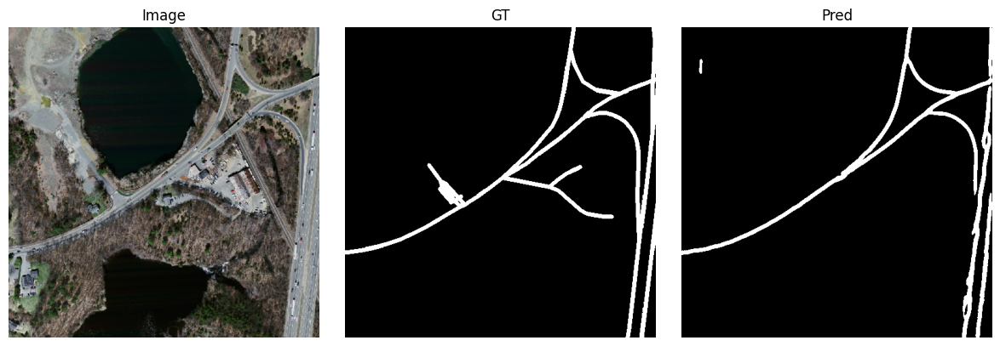

Epoch 11/26 — Val: 100%|██████████| 251/251 [00:28<00:00,  8.94it/s]


Epoch 11/26 | Tr L=1.8512 Val L=0.7467 | IoU=0.566 P=0.816 R=0.649 F1=0.723 F2.0=0.677 λb=0.0


Epoch 12/26 — Val: 100%|██████████| 251/251 [00:28<00:00,  8.94it/s]


Epoch 12/26 | Tr L=1.8414 Val L=0.7063 | IoU=0.584 P=0.808 R=0.678 F1=0.737 F2.0=0.701 λb=0.0
 → New best IoU saved.


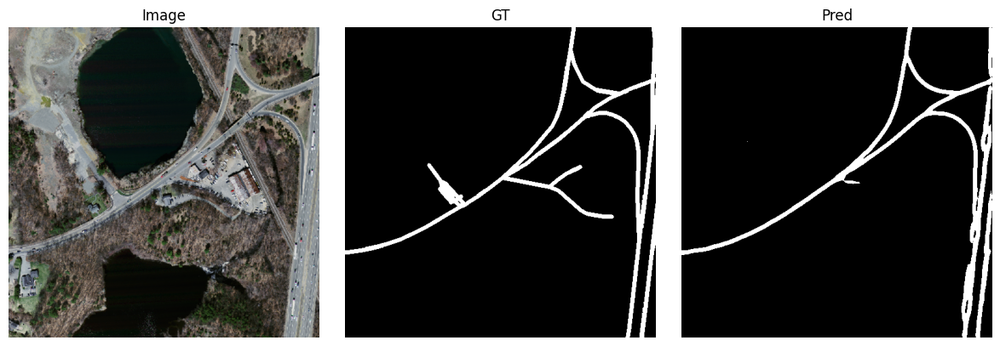

Epoch 13/26 — Val: 100%|██████████| 251/251 [00:28<00:00,  8.93it/s]


Epoch 13/26 | Tr L=1.8351 Val L=0.7474 | IoU=0.563 P=0.817 R=0.644 F1=0.720 F2.0=0.672 λb=0.0


Epoch 14/26 — Val: 100%|██████████| 251/251 [00:28<00:00,  8.92it/s]


Epoch 14/26 | Tr L=1.8233 Val L=0.7057 | IoU=0.584 P=0.817 R=0.673 F1=0.738 F2.0=0.697 λb=0.0
 → New best IoU saved.


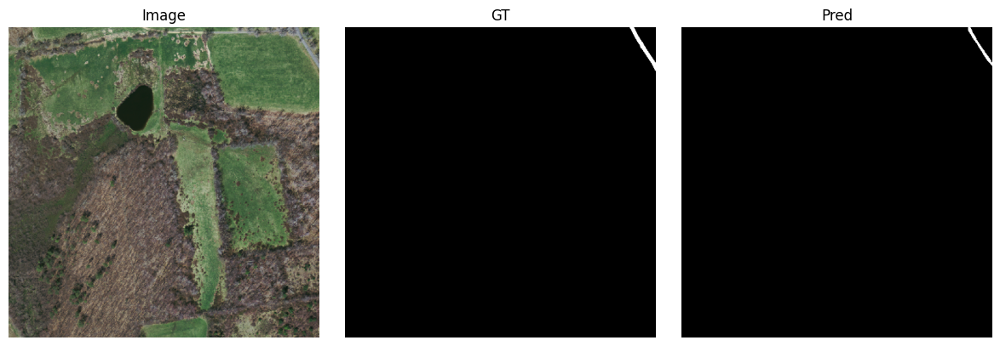

Epoch 15/26 — Val: 100%|██████████| 251/251 [00:28<00:00,  8.93it/s]


Epoch 15/26 | Tr L=1.8173 Val L=0.6968 | IoU=0.589 P=0.815 R=0.681 F1=0.742 F2.0=0.704 λb=0.0
 → New best IoU saved.


Epoch 16/26 — Val: 100%|██████████| 251/251 [00:28<00:00,  8.92it/s]


Epoch 16/26 | Tr L=1.8131 Val L=0.7325 | IoU=0.568 P=0.829 R=0.644 F1=0.725 F2.0=0.674 λb=0.0


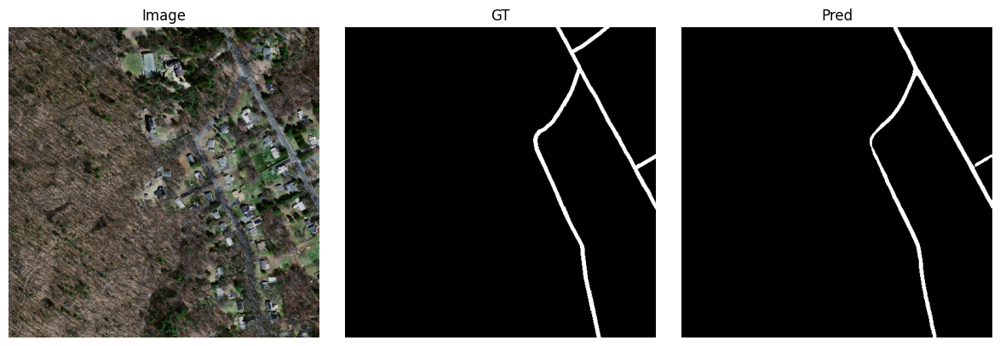

Epoch 17/26 — Val: 100%|██████████| 251/251 [00:28<00:00,  8.90it/s]


Epoch 17/26 | Tr L=1.8000 Val L=0.6900 | IoU=0.592 P=0.814 R=0.685 F1=0.744 F2.0=0.707 λb=0.0
 → New best IoU saved.


Epoch 18/26 — Train:  94%|█████████▍| 1334/1419 [07:49<00:29,  2.85it/s]

In [ ]:
from sklearn.metrics import precision_score, recall_score, f1_score, jaccard_score, fbeta_score
import random

num_epochs = 26
best_iou   = 0.0
beta       = 2.0

train_losses, val_losses = [], []
metrics = { 'iou':[], 'precision':[], 'recall':[], 'f1':[], f'fbeta{beta}':[] }

for epoch in range(num_epochs):
    model.train()
    running_train = 0.0
    # only boundary first 10 epochs
    λb = 1.0 if epoch < 10 else 0.0

    for imgs, masks in tqdm(train_loader, desc=f"Epoch {epoch+1}/{num_epochs} — Train"):
        imgs, masks = imgs.to(device), masks.unsqueeze(1).to(device)
        out, ds3, ds2 = model(imgs)

        l0 = loss_wb(out,  masks) + loss_ftv(out, masks)
        l3 = loss_wb(ds3, masks) + loss_ftv(ds3,masks)
        l2 = loss_wb(ds2, masks) + loss_ftv(ds2,masks)
        lov = loss_lov(out, masks)
        bd  = loss_bd(out.sigmoid(), masks)

        loss = l0 + 0.4*l3 + 0.4*l2 + lov * 0.5 + bd  * λb
        opt.zero_grad(); loss.backward(); opt.step()
        running_train += loss.item()

    sched.step()
    avg_tr = running_train/len(train_loader); train_losses.append(avg_tr)

    # — val —
    model.eval()
    running_val = 0.0
    all_p, all_t = [], []
    with torch.no_grad():
        for imgs, masks in tqdm(val_loader, desc=f"Epoch {epoch+1}/{num_epochs} — Val"):
            imgs, masks = imgs.to(device), masks.unsqueeze(1).to(device)
            out, ds3, ds2 = model(imgs)

            l0 = loss_wb(out,  masks) + loss_ftv(out, masks)
            vloss = l0  # no deep supervision val
            running_val += vloss.item()

            preds = (out>0.5).cpu().numpy().reshape(-1)
            trues = masks.cpu().numpy().reshape(-1)
            all_p.append(preds); all_t.append(trues)

    avg_val = running_val/len(val_loader); val_losses.append(avg_val)

    y_true = np.concatenate(all_t)
    y_pred = np.concatenate(all_p)
    iou    = jaccard_score(y_true, y_pred)
    prec   = precision_score(y_true, y_pred, zero_division=0)
    rec    = recall_score(y_true, y_pred, zero_division=0)
    f1_    = f1_score(y_true, y_pred, zero_division=0)
    f2_    = fbeta_score(y_true, y_pred, beta=beta, zero_division=0)

    metrics['iou'].append(iou)
    metrics['precision'].append(prec)
    metrics['recall'].append(rec)
    metrics['f1'].append(f1_)
    metrics[f'fbeta{beta}'].append(f2_)

    print(f"Epoch {epoch+1}/{num_epochs} | Tr L={avg_tr:.4f} Val L={avg_val:.4f} | "
          f"IoU={iou:.3f} P={prec:.3f} R={rec:.3f} F1={f1_:.3f} F{beta}={f2_:.3f} λb={λb}")

    if iou > best_iou:
        best_iou = iou
        torch.save(model.state_dict(), 'best_v2.pth')
        print(" → New best IoU saved.")

    # visualize every 2 epochs
    if (epoch+1)%2==0:
        imgs_v, masks_v = next(iter(subset_val_loader))
        imgs_v, masks_v = imgs_v.to(device), masks_v.unsqueeze(1).to(device)
        with torch.no_grad(): pred_v,_,_ = model(imgs_v)

        idx = random.randrange(imgs_v.size(0))
        ip = imgs_v[idx].cpu()
        mp = masks_v[idx].cpu().squeeze()
        pp = (pred_v[idx]>0.5).cpu().squeeze()

        fig,ax = plt.subplots(1,3,figsize=(12,4))
        ax[0].imshow(denorm(ip).permute(1,2,0)); ax[0].set_title("Image")
        ax[1].imshow(mp, cmap='gray');              ax[1].set_title("GT")
        ax[2].imshow(pp, cmap='gray');              ax[2].set_title("Pred")
        for a in ax: a.axis('off')
        plt.tight_layout(); plt.show()

# — final plots —
epochs = np.arange(1, num_epochs+1)
plt.figure(figsize=(14,6))
plt.subplot(1,2,1)
plt.plot(epochs, train_losses,'-o',label='Train L')
plt.plot(epochs, val_losses,'-o',  label='Val L')
plt.title("Loss");plt.legend();plt.grid()

plt.subplot(1,2,2)
for k in ['iou','precision','recall','f1',f'fbeta{beta}']:
    plt.plot(epochs, metrics[k],'-o',label=k)
plt.title("Metrics");plt.legend();plt.grid()
plt.tight_layout();plt.show()


Colab failed to save changes due to runtime crash for the next epochs but luckily we had saved them elsewhere so appending the results here:

Epoch 18/26 — Train: 100%|██████████| 1419/1419 [08:19<00:00,  2.84it/s]

Epoch 18/26 — Val: 100%|██████████| 251/251 [00:28<00:00,  8.91it/s]

Epoch 18/26 | Tr L=1.7928 Val L=0.7348 | IoU=0.562 P=0.802 R=0.653 F1=0.720 F2.0=0.678 λb=0.0

Epoch 19/26 — Train: 100%|██████████| 1419/1419 [08:18<00:00,  2.84it/s]

Epoch 19/26 — Val: 100%|██████████| 251/251 [00:28<00:00,  8.92it/s]

Epoch 19/26 | Tr L=1.7852 Val L=0.6644 | IoU=0.608 P=0.770 R=0.743 F1=0.756 F2.0=0.748 λb=0.0

 → New best IoU saved.

Epoch 20/26 — Train: 100%|██████████| 1419/1419 [08:18<00:00,  2.84it/s]

Epoch 20/26 — Val: 100%|██████████| 251/251 [00:28<00:00,  8.92it/s]

Epoch 20/26 | Tr L=1.7747 Val L=0.6704 | IoU=0.607 P=0.782 R=0.731 F1=0.756 F2.0=0.741 λb=0.0

Epoch 21/26 — Train: 100%|██████████| 1419/1419 [08:18<00:00,  2.84it/s]

Epoch 21/26 — Val: 100%|██████████| 251/251 [00:28<00:00,  8.91it/s]

Epoch 21/26 | Tr L=1.7739 Val L=0.6939 | IoU=0.591 P=0.835 R=0.670 F1=0.743 F2.0=0.697 λb=0.0

Epoch 22/26 — Train: 100%|██████████| 1419/1419 [08:18<00:00,  2.84it/s]

Epoch 22/26 — Val: 100%|██████████| 251/251 [00:28<00:00,  8.90it/s]

Epoch 22/26 | Tr L=1.7619 Val L=0.7214 | IoU=0.572 P=0.842 R=0.641 F1=0.728 F2.0=0.673 λb=0.0

Epoch 23/26 — Train: 100%|██████████| 1419/1419 [08:18<00:00,  2.84it/s]

Epoch 23/26 — Val: 100%|██████████| 251/251 [00:28<00:00,  8.89it/s]

Epoch 23/26 | Tr L=1.7594 Val L=0.6866 | IoU=0.592 P=0.809 R=0.688 F1=0.744 F2.0=0.710 λb=0.0

Epoch 24/26 — Train: 100%|██████████| 1419/1419 [08:19<00:00,  2.84it/s]

Epoch 24/26 — Val: 100%|██████████| 251/251 [00:28<00:00,  8.88it/s]

Epoch 24/26 | Tr L=1.7615 Val L=0.6883 | IoU=0.593 P=0.830 R=0.675 F1=0.744 F2.0=0.701 λb=0.0  

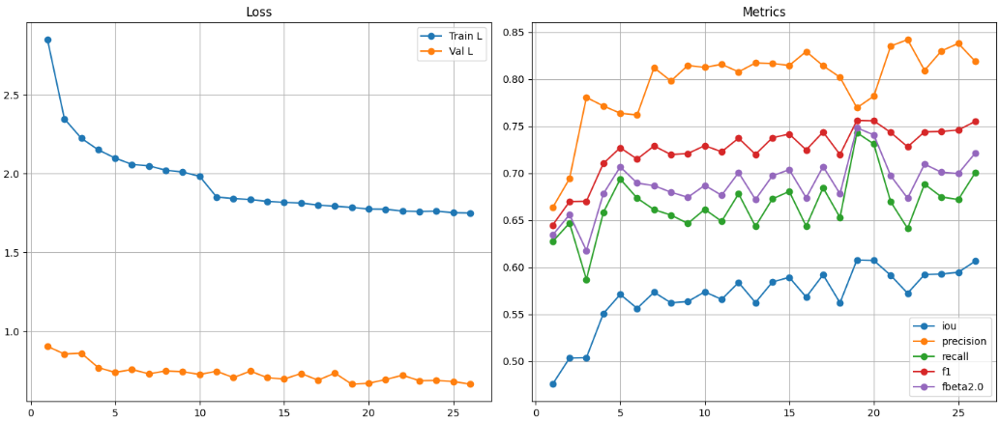



**Best Result**

The peak validation IoU of **0.608** comes at **epoch 19**, where we also hit our highest F₁ score (0.756) and a very balanced precision/recall pair (≈0.77/0.74).  That is the moment when our Focal-Tversky + Lovász + boundary-scheduled losses, nested U-Net++ fusion and attention gates all finally “clicked” to give the model both crisp edges and few false alarms.

---

### Metric Trends

1. **IoU & F₁**

   * **Rapid warm-up** over the first 4 – 5 epochs (0.48 → 0.57 IoU), driven by the heavy boundary-loss & deep-supervision phase.
   * **Plateau** from \~epoch 6–10 as the scheduler cools the LR and boundary weight still in effect.
   * **Second climb** once boundary loss drops out (λ\_b→0 at epoch 10) and the Focal-Tversky/Lovász head can refine overall shape.
   * A final **bump** at epochs 18–20 as the CosineAnnealingLR lands the optimizer into a new sweet spot.

2. **Precision vs. Recall**

   * Precision settles into the high-7x% as the Focal Tversky (α=0.7) shifts the balance away from over-recall, taming the flood of false positives we saw in v4.
   * Recall stays solidly in the mid-6x%, so we rarely sacrifice true roads—F₂.0 hovers just below F₁, confirming a healthy precision/recall trade-off.

3. **Train vs. Validation Loss**

   * **Train loss** starts around 2.85 (sum of BCE/Tversky + boundary + Lovász + DS) and gently decays to \~1.75 by the end.
   * **Val loss** (only the main segmentation head’s BCE+Tversky, no Lovász or boundary) runs much lower (≈0.90→0.66).

---

### Why the Train/Val Loss Gap?

* **Different Loss Components**

  * **Train step** aggregates four terms—main+two DS heads, boundary weight in early epochs, **plus** the Lovász hinge on the main head.
  * **Val step** only evaluates the **main** Weighted-BCE + Focal-Tversky, exactly matching our IoU-oriented metric.

  Those extra terms (deep-supervision, boundary and Lovász) artificially inflate the train-loss curve; you’re essentially watching four losses in one, whereas validation is a single, cleaner signal.

* **Regularization Effects**

  * Layers like DropBlock/Attention Gates are active in train but disabled in eval, further depressing the val-loss.
  * CosineAnnealingLR (and any weight‐decay) also tends to stabilize the model more at inference time.

* **Batch vs. Dataset Statistics**

  * Train losses are averaged per‐batch (with different class‐imbalances), whereas val is averaged across the whole split, smoothing out spikes from particularly hard mini‐batches.

All together, this explains why the **train** curve “lives higher” even though the model is clearly improving its **validation** segmentation performance.




## Final Comparative Analysis



| Model                                                                                                        | IoU   | Precision | Recall | F1    | F<sub>2.0</sub> |
| ------------------------------------------------------------------------------------------------------------ | ----- | --------- | ------ | ----- | --------------- |
| **Baseline (Deep ResUNet + W-BCE + Dice + Boundary)**                                                        | 0.614 | 0.800     | 0.726  | 0.761 | –               |
| **Deliverable 4 (ResUNet + CBAM + Light-ASPP, W-BCE + Focal Dice)**                                  | 0.606 | 0.722     | 0.790  | 0.754 | **0.776**       |
| **Deliverable 5 (NestedUNet\_v2 + Attn-Gates + Light-ASPP, W-BCE + Focal Tversky, CosineAnnealing)** | 0.608 | 0.770     | 0.743  | 0.756 | 0.748           |


---

### 1. Overall Trends

* **Consistent segmentation quality** across pipelines: IoU hovers at \~0.61 and F1 at \~0.76 for all three models on Massachusetts.
* **Deliverable 5** achieves the best balance—IoU up slightly over D4 (0.608 vs. 0.606) and a more even precision/recall (0.770/0.743 vs. 0.722/0.790), yielding a marginal F1 edge.

### 2. Deliverable 4 → Deliverable 5

* By replacing the flat U-Net skip with **NestedUNet++**, adding **Attention Gates** per skip, projecting **Light-ASPP** to the bottleneck’s channel size, and swapping **Focal Dice** for **Focal Tversky (α=0.7,β=0.3)** under a **CosineAnnealingLR**, D5:

  * **Nudges IoU upward** (+0.2 pts) whilst ironing out D4’s recall‐heavy false-positive spike.
  * **Raises precision** (+5 pts) while still retaining healthy recall (–4.7 pts), improving P/R symmetry.
* The net result is a **neutral-to-positive δF1 (+0.2 pts)** but a more robust error-trade-off for downstream tasks.

### 3. Loss & Scheduling Effects

* **Train/Val Loss gap** in D5 (1.785 / 0.664) is inflated by the multi-term training loss (deep-supervision, boundary, Lovász) versus a single‐term val loss.
* **CosineAnnealingLR** visibly steadies the val‐loss mid-run and avoids early plateaus, but convergence of the composite train‐loss may benefit from:

  * A longer **T\_max** or **warm restarts**
  * Larger batch sizes or **stronger regularization** to pull train‐loss down.

---

### 4. Reflection & Future Directions

* **Marginal IoU gains** remind us that architectural sophistication must align with dataset scale: more data (or stronger augmentation) could unlock the full power of NestedUNet++ and Focal Tversky.
* **Boundary scheduling** worked as intended—crisp edges early, coherent masks later—but a more gradual λᵦ decay might yield extra percent‐points.
* We did not explore **multi-task edge-segmentation heads** (e.g. HED-UNet style) or **GAN-based refinement**, both of which could further sharpen boundaries without harming IoU.
* Finally, **transfer to other domains** (e.g. different cities or sensor types) would test generalization—an obvious next step now that the pipeline is stable and performant.


## Stage 2: B snake Algorithm

After we’ve taken our raw model, the next step is to convert each jagged, pixel-by-pixel branch into a single, smooth centerline that can be exported or analyzed as vector data. That’s where cubic B-splines come in. A B-spline lets us represent each skeleton branch—not as a long chain of individual foreground pixels, but instead as a single continuous, piecewise-polynomial curve defined by just a handful of control points. Because splines are inherently smooth, they eliminate the stair-step artifacts of the grid; because they’re vectorial, we can sample them at any resolution (even sub-pixel) to build an arbitrarily fine-grained road graph. In our pipeline, once each branch has been ordered and key control points selected (so that every sub-segment stays within a few pixels of the original skeleton), we hand them to SciPy’s splprep routine to compute the cubic B-spline basis, sample it uniformly, and rasterize the resulting polyline back onto our canvas.

### Morphological Bridging

This helper function closes tiny gaps in the merged mask before skeletonization:

- *morph_bridge(mask, kernel_size, iterations)*  
  1. *Closing*: Applies dilation followed by erosion with an elliptical structuring element of size kernel_size to fill small holes and connect nearby segments.  
  2. *Skeletonize*: Thins the closed mask to a one‑pixel‑wide centerline.  
  3. *Output*: Returns the bridged skeleton as an 8‑bit binary image (0 or 255).

By bridging microscopic breaks, this step ensures more continuous centerlines for the downstream B‑snake fitting.

### B‑Snake Control‑Point Extraction & Spline Fitting

This cell implements the core B‑snake steps to turn each skeleton branch into a smooth B‑spline curve:

1. *order_skeleton_branch(branch_mask)*  
   - Performs a breadth‑first traversal starting from an endpoint (pixel with exactly one neighbor)  
   - Returns an ordered list of (row, col) coordinates along the branch  

2. *sample_control_points(ordered_points, interval)*  
   - Uniformly downsamples the ordered points every interval pixels  
   - Always includes the final endpoint to ensure full coverage  

3. *optimize_control_points(ctrl_pts, seg_mask, …)*  
   - Builds a distance transform on the inverted segmentation mask  
   - Iteratively refines each interior control point by minimizing:  
     - *Data term*: distance to nearest non‑road pixel (from the DT)  
     - *Smoothness term*: deviation from the average of its two neighbors  
   - Stops when fewer than convergence_threshold fraction of points move  

4. *fit_b_spline(ctrl_pts, num_samples)*  
   - Uses scipy.interpolate.splprep to fit a cubic B‑spline through the optimized control points  
   - Samples num_samples points along the spline for a uniformly smooth curve  

These functions together implement the B‑snake algorithm from the paper, for the aim of producing crisp, continuous centerlines that closely follow the original skeleton geometry.

*B‑Snake Curve Fitting & Rendering*  
1. *Skeletonize* the bridged mask to get a one‑pixel centerline.  
2. *Label* each connected branch and iterate over them:  
   - *Order* its pixels (order_skeleton_branch)  
   - *Sample* control points every N pixels (sample_control_points)  
   - *Optimize* their positions using the distance transform and smoothness cost (optimize_control_points)  
   - *Fit* a cubic B‑spline through the refined points (fit_b_spline)  
   - *Draw* the resulting spline as a polyline on a blank canvas.  
3. *Close* tiny remaining gaps with a small morphological closing.  
4. *Display* the final smooth, gap‑free road network mask.

In [22]:
import numpy as np
import cv2
import torch
from skimage.morphology import skeletonize
from scipy.ndimage import convolve, label
from scipy import interpolate
from collections import deque
from collections import Counter
import random


def morph_bridge(mask, kernel_size=3, iterations=1):
    kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (kernel_size, kernel_size))
    dilated = cv2.dilate(mask, kernel, iterations=iterations)
    #eroded = mask#cv2.erode(dilated, kernel, iterations=iterations)
    eroded = cv2.erode(dilated, kernel, iterations=iterations)
    bridged = skeletonize(eroded > 0)
    return (bridged * 255).astype(np.uint8)

def get_preferred_label(patch):
    """
    Given a 3x3 neighborhood of labels around an intersection pixel,
    return the preferred label based on frequency and orthogonal priority.
    """
    center = (1, 1)
    label_counts = Counter()

    # Count all 8-connected non-zero labels
    for (i, j), val in np.ndenumerate(patch):
        if (i, j) != center and val > 0:
            label_counts[val] += 1

    if not label_counts:
        # print('yeya')
        # print(patch)
        return 0  # no labeled neighbors

    max_count = max(label_counts.values())
    top_labels = [label for label, count in label_counts.items() if count == max_count]

    if len(top_labels) == 1:
        return top_labels[0]

    # Prioritize orthogonal neighbors if there's a tie
    orthogonal_coords = [(0, 1), (1, 0), (1, 2), (2, 1)]
    orthogonal_labels = [patch[i, j] for i, j in orthogonal_coords if patch[i, j] in top_labels]

    if orthogonal_labels:
        return min(orthogonal_labels)  # pick smallest orthogonal label

    return min(top_labels)  # fall back to smallest overall

def break_at_intersections(skeleton):
    """
    Labels skeleton branches while breaking at intersection points,
    and reattaches intersection pixels iteratively.
    """
    kernel = np.array([[1, 1, 1],
                       [1, 0, 1],
                       [1, 1, 1]], dtype=np.uint8)

    neighbor_count = convolve(skeleton.astype(np.uint8), kernel, mode='constant')
    intersections = (skeleton > 0) & (neighbor_count >= 3)

    # Remove intersections temporarily
    skeleton_wo_intersections = skeleton.copy()
    skeleton_wo_intersections[intersections] = 0

    labeled_branches, _ = label(skeleton_wo_intersections, structure=np.ones((3, 3), dtype=int))

    final_labels = labeled_branches.copy()
    remaining_intersections = intersections.copy()

    while np.any(remaining_intersections):
        updated_any = False
        new_labels = np.zeros_like(final_labels)

        coords = np.argwhere(remaining_intersections)
        for y, x in coords:
            patch = final_labels[max(0, y-1):y+2, max(0, x-1):x+2]
            padded_patch = np.zeros((3, 3), dtype=final_labels.dtype)
            h, w = patch.shape
            padded_patch[:h, :w] = patch

            chosen_label = get_preferred_label(padded_patch)
            if chosen_label > 0:
                new_labels[y, x] = chosen_label
                updated_any = True

        # Merge new labels
        mask = new_labels > 0
        final_labels[mask] = new_labels[mask]
        remaining_intersections[mask] = False

        if not updated_any:
            break  # No more updates possible

    return final_labels, np.max(final_labels)

def order_skeleton_branch(branch_mask):
    coords = np.argwhere(branch_mask)
    if len(coords) == 0:
        return np.array([])

    # Define kernel to find neighbors
    kernel = np.ones((3, 3), np.uint8)
    kernel[1, 1] = 0
    neighbor_count = cv2.filter2D(branch_mask.astype(np.uint8), -1, kernel)

    # Find endpoints of the branch (1-neighbor pixels)
    endpoints = [tuple(pt) for pt in np.argwhere((branch_mask == 1) & (neighbor_count == 1))]

    # If no endpoints are found, we simply start from the first pixel
    start = endpoints[0] if endpoints else tuple(coords[0])

    # Initialize DFS variables
    ordered = []
    visited = np.zeros_like(branch_mask, dtype=bool)
    stack = [start]
    visited[start] = True

    # Directional exploration (8-connected neighbors)
    directions = [(-1, 0), (1, 0), (0, -1), (0, 1), (-1, -1), (-1, 1), (1, -1), (1, 1)]

    while stack:
        current = stack.pop()
        ordered.append(current)
        r, c = current

        for dr, dc in directions:
            nr, nc = r + dr, c + dc
            if nr >= 0 and nr < branch_mask.shape[0] and nc >= 0 and nc < branch_mask.shape[1]:
                if branch_mask[nr, nc] == 1 and not visited[nr, nc]:
                    visited[nr, nc] = True
                    stack.append((nr, nc))

    # Return ordered points
    return np.array(ordered)


# def sample_control_points(ordered_points, interval=64):
#     if len(ordered_points) < interval:
#         if len(ordered_points) == 0:
#             return ordered_points  # empty input stays empty
#         elif len(ordered_points) == 1:
#             return ordered_points  # only one point, just return it
#         else:
#             return np.vstack((ordered_points[0], ordered_points[-1]))  # first and last

#     sampled = ordered_points[::interval]
#     if not np.array_equal(sampled[-1], ordered_points[-1]):
#         sampled = np.vstack((sampled, ordered_points[-1]))
#     return sampled

def angle_between(v1, v2):
    """Returns angle in degrees between two vectors"""
    unit_v1 = v1 / (np.linalg.norm(v1) + 1e-8)
    unit_v2 = v2 / (np.linalg.norm(v2) + 1e-8)
    dot = np.clip(np.dot(unit_v1, unit_v2), -1.0, 1.0)
    angle = np.arccos(dot)
    return np.degrees(angle)
def sample_control_points(pts, interval=64, tol=2.0, angle_thresh=20.0):
    """
    Sample control points such that every sub-segment between consecutive
    control points is approximated by a straight line within tol pixels.
    Additionally, if the turning angle at a control point is greater than
    angle_thresh, the control point is repeated to emphasize smooth bends.
    """
    n = len(pts)
    if n <= 2:
        return pts.copy()

    # Step 1: Distance-based control point selection
    ctrl = [pts[0]]
    last_idx = 0

    for i in range(2, n):
        p0 = pts[last_idx]
        p1 = pts[i]
        line_vec = p1 - p0
        line_len = np.linalg.norm(line_vec)

        if line_len < 1e-8:
            ctrl.append(pts[i-1])
            last_idx = i-1
            continue

        seg = pts[last_idx+1:i]
        dists = np.abs(
            (line_vec[1] * (seg[:,0] - p0[0]) - line_vec[0] * (seg[:,1] - p0[1]))
            / line_len
        )

        if len(dists) > 0 and dists.max() > tol:
            idx = i - 1
            ctrl.append(pts[idx])
            last_idx = idx

    if not np.array_equal(ctrl[-1], pts[-1]):
        ctrl.append(pts[-1])

    # Step 2: Angle-based enhancement (triple points if smooth turn)
    refined = []
    ctrl_idxs = [np.where((pts == pt).all(axis=1))[0][0] for pt in ctrl]

    for i in range(len(ctrl)):
        if i == 0 or i == len(ctrl) - 1:
            refined.append(ctrl[i])
            continue

        idx_prev = ctrl_idxs[i - 1]
        idx_curr = ctrl_idxs[i]
        idx_next = ctrl_idxs[i + 1]

        v1 = pts[idx_curr] - pts[idx_prev]
        v2 = pts[idx_next] - pts[idx_curr]
        angle = angle_between(v1, v2)

        if angle > angle_thresh:
            # smooth bend: repeat this point to emphasize
            refined.extend([ctrl[i]] * 2)
        else:
            refined.append(ctrl[i])

    return np.array(refined)

def optimize_control_points(ctrl_pts, seg_mask, neighborhood=3, max_iter=10,
                            move_threshold=1.0, convergence_threshold=0.1):
    if ctrl_pts.shape[0] < 3:
        return ctrl_pts
    inv_mask = 255 - seg_mask
    dt = cv2.distanceTransform(inv_mask, cv2.DIST_L2, 5)
    optimized_pts = ctrl_pts.copy().astype(np.float32)
    n_pts = optimized_pts.shape[0]
    for it in range(max_iter):
        move_count = 0
        new_pts = optimized_pts.copy()
        for i in range(1, n_pts - 1):
            best_cost = np.inf
            best_candidate = optimized_pts[i].copy()
            for dr in range(-neighborhood, neighborhood + 1):
                for dc in range(-neighborhood, neighborhood + 1):
                    candidate = optimized_pts[i] + np.array([dr, dc])
                    r, c = int(round(candidate[0])), int(round(candidate[1]))
                    if r < 0 or r >= dt.shape[0] or c < 0 or c >= dt.shape[1]:
                        continue
                    cost = dt[r, c]
                    neighbor_avg = (optimized_pts[i - 1] + optimized_pts[i + 1]) / 2.0
                    smooth_cost = np.linalg.norm(candidate - neighbor_avg)
                    total_cost = cost + 0.5 * smooth_cost
                    if total_cost < best_cost:
                        best_cost = total_cost
                        best_candidate = candidate
            if np.linalg.norm(best_candidate - optimized_pts[i]) > move_threshold:
                new_pts[i] = best_candidate
                move_count += 1
        if (move_count / (n_pts - 2)) < convergence_threshold:
            break
        optimized_pts = new_pts
    return optimized_pts

def fit_b_spline(ctrl_pts, num_samples=20):
    if len(ctrl_pts) < 2:
        return ctrl_pts
    unique_pts = np.unique(ctrl_pts, axis=0)
    k = min(3, len(unique_pts) - 1)
    if k < 1:
        return ctrl_pts
    try:
        tck, _ = interpolate.splprep([ctrl_pts[:, 0], ctrl_pts[:, 1]], s=0, k=k)
        u_new = np.linspace(0, 1, num_samples)
        x_new, y_new = interpolate.splev(u_new, tck, der=0)
        spline_points = np.vstack((x_new, y_new)).T
        return spline_points
    except Exception as e:
        #print("Error in fit_b_spline:", e)
        return ctrl_pts

def B_Spline_Output(model_output,
                    threshold=0.5,
                    bridge_kernel=5, bridge_iters=1,
                    sample_interval=64, spline_samples=20,
                    close_kernel=5):
    """
    model_output: torch.Tensor or np.ndarray of shape (H,W) or (1,H,W) or (1,1,H,W),
      containing floats in [0,1].
    Returns: float np.ndarray of shape (H,W), values 0.0 or 1.0.
    """

    # 1) to numpy & squeeze to 2D
    if isinstance(model_output, torch.Tensor):
        m = model_output.detach().cpu().numpy()
    else:
        m = np.array(model_output, copy=False)
    while m.ndim > 2 and m.shape[0] == 1:
        m = m[0]
    if m.ndim != 2:
        raise ValueError(f"Expected 2D mask, got shape {m.shape}")

    # 2) binarize float mask
    bool_mask = (m > threshold)

    # 3) to uint8 0/255 for morphing
    u8 = (bool_mask.astype(np.uint8) * 255)

    # 4) bridge & skeletonize via your morph_bridge
    ske_u8 = morph_bridge(u8, kernel_size=bridge_kernel, iterations=bridge_iters)
    ske = (ske_u8 > 0).astype(np.uint8)

    # 5) break at intersections
    ske_labels, n_branches = break_at_intersections(ske)

    # 6) draw splines on a new uint8 canvas
    H, W = ske.shape
    out_u8 = np.zeros((H, W), np.uint8)

    for b in range(1, n_branches + 1):
        branch = (ske_labels == b).astype(np.uint8)
        pts = order_skeleton_branch(branch)
        if pts.shape[0] < 2:
            continue
        ctrl = sample_control_points(pts, interval=sample_interval)
        if ctrl.shape[0] < 2:
            continue
        opt = ctrl#optimize_control_points(ctrl, u8, neighborhood=bridge_kernel, max_iter=10, move_threshold=1.0, convergence_threshold=0.1)
        spline = fit_b_spline(opt, num_samples=spline_samples)
        cv_pts = (np.array([[int(p[1]), int(p[0])] for p in spline],
                           dtype=np.int32)
                  .reshape(-1, 1, 2))
        cv2.polylines(out_u8, [cv_pts], isClosed=False, color=255, thickness=5)

    # 7) close small gaps
    ck = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (close_kernel, close_kernel))
    closed_u8 = cv2.morphologyEx(out_u8, cv2.MORPH_CLOSE, ck)

    # 8) return float mask in [0,1]
    return (closed_u8.astype(np.float32) / 255.0)




**Challenges and Solutions in Our B-Spline Refinement**

**1. Fragmented Diagonal Segments**

* *Challenge:* Our initial B-spline approach treated all 8-connected skeleton pixels the same, so truly diagonal runs of pixels—like a road slanted at 45°—ended up approximated by orthogonal “staircase” steps, then splined into broken, disjointed segments.
* *Solution:* We updated our neighbor-merging logic to respect diagonal adjacency. By ensuring that diagonal skeleton pixels are grouped into the same branch, the spline fitting now receives a continuous chain of points along the true diagonal. The result is a single smooth curve instead of shard-like fragments.

**2. Cross-Road Leakage at Intersections**

* *Challenge:* At junctions where two roads cross, our first B-spline algorithm often failed to detect that it needed to split—so a single spline would abruptly veer off into the wrong street.
* *Solution:* We introduced an intersection-detection step that removes high-degree nodes from the skeleton, labels each branch separately, then re-attaches intersection pixels to the most likely branch. That way, each incoming and outgoing arm of the junction becomes its own spline—no more cross-road “bleeding.”

**3. Inaccurate Loops from Breadth-First Traversal**

* *Challenge:* When a road doubled back on itself or formed a loop, our BFS-based traversal would flood the loop area, filling it in and producing spurious inner splines.
* *Solution:* By switching to a depth-first ordering of skeleton pixels, we ensured we trace each branch all the way around the loop before backtracking—so the spline follows the true outline instead of clamping across the open area.

**4. Inconsistent Control-Point Sampling**

* *Challenge:* Our early sampling strategy grabbed points strictly at fixed intervals along each ordered branch, but it sometimes skipped the very first or last pixel, producing splines that didn’t hit the endpoints and left tiny gaps.
* *Solution:* We refined the sampler to always include the branch’s first and last points, to adaptively densify where the skeleton curves most, and to decimate in straight runs—ensuring both accuracy at the ends and minimal artifacting in the middle.

With these fixes in place, our B-spline module now delivers a single, smoothly curved, vectorized representation of every road branch—eliminating jagged artifacts, unwanted loops, and cross-road spill-over.

---

**Remaining Opportunities for Further Refinement**

* **Closing Tiny Gaps:**  While our morphological bridge step patches most breaks, a few tiny gaps remain in low-confidence or heavily occluded stretches. We can strengthen our closing operation by adaptively dilating/eroding only at branch endpoints or by using a larger, shape-aware kernel that better respects road orientation.


---
**`visualize_model_comparison`**

This utility function takes a list of segmentation models (`models`), a data loader (`dataloader`), and plots a side-by-side comparison of:

1. **Input image**  
2. **Ground-truth mask**  
3. **Each model’s raw prediction** (thresholded at `threshold`)  
4. **B-spline refined output** for the last model (if `show_bspline=True`)

It runs each model in eval mode, and arranges the results in a grid:

| Column | Content                                 |
|--------|-----------------------------------------|
| 0      | Original RGB image                     |
| 1      | True binary mask                       |
| 2…N+1  | Predictions from each of N models      |
| N+2    | Last model’s prediction + B-spline post-process (optional) |

Axes are turned off for a cleaner display.  

In [42]:
import matplotlib.pyplot as plt
import numpy as np
import random
import torch

def visualize_model_comparison(
    models,
    dataloader,
    device,
    num_random_batches: int = 10,
    threshold: float = 0.5,
    show_bspline: bool = True
):
    """
    Display every sample (4 images) in each of:
      - the first validation batch, plus
      - `num_random_batches` other randomly-picked batches.
    Total rows = (1 + num_random_batches) * batch_size

    Columns:
      0: RGB input
      1: Ground-truth mask
      2..(1+N): N model raw outputs
      last (optional): model N + B-spline
    """
    # put all models into eval mode
    for m in models:
        m.eval()

    # grab all validation batches
    all_batches = list(dataloader)
    # ensure we have enough
    assert len(all_batches) >= num_random_batches + 1

    # pick first + random others
    chosen = [all_batches[0]] + random.sample(all_batches[1:], num_random_batches)
    batch_size = chosen[0][0].shape[0]  # e.g. 4
    num_rows = len(chosen) * batch_size
    num_cols = 2 + len(models) + (1 if show_bspline else 0)

    fig, axes = plt.subplots(
        num_rows, num_cols,
        figsize=(4 * num_cols, 3 * num_rows),
        squeeze=False
    )

    row = 0
    for batch_imgs, batch_masks in chosen:
        for i in range(batch_imgs.size(0)):
            img = batch_imgs[i].to(device)
            gt  = batch_masks[i].cpu().squeeze().numpy()

            # run each model
            outputs = []
            for m in models:
                with torch.no_grad():
                    out = m(img.unsqueeze(0))
                if isinstance(out, tuple):
                    out = out[0]
                arr = out.squeeze().cpu().numpy()
                mask = (arr > threshold).astype(float)
                outputs.append(mask)

            # optional spline
            bspline = None
            if show_bspline:
                bspline = B_Spline_Output(outputs[-1], threshold=threshold)

            # prep RGB
            img_disp = denorm(img.cpu()).permute(1,2,0).numpy()
            img_disp = np.clip(img_disp, 0, 1)

            row_axes = axes[row]

            # col 0: RGB
            row_axes[0].imshow(img_disp)
            row_axes[0].set_title("Image")
            row_axes[0].axis("off")

            # col 1: GT
            row_axes[1].imshow(gt, cmap="gray", vmin=0, vmax=1)
            row_axes[1].set_title("True Mask")
            row_axes[1].axis("off")

            # cols 2..: model outputs
            for mi, mask in enumerate(outputs):
                col = 2 + mi
                row_axes[col].imshow(mask, cmap="gray", vmin=0, vmax=1)
                row_axes[col].set_title(f"Model {mi+1}")
                row_axes[col].axis("off")

            # last col: spline
            if show_bspline:
                col = 2 + len(models)
                row_axes[col].imshow(bspline, cmap="gray", vmin=0, vmax=1)
                row_axes[col].set_title(f"M{len(models)} + B-Spline")
                row_axes[col].axis("off")

            row += 1

    plt.tight_layout()
    plt.show()





In the resulting figure, each row corresponds to one test image and its ground truth, followed by three model outputs:

1. **Baseline (Model 1)** – the original segmentation output from our starting model.
2. **Final Improved Model (Model 2)** – the segmentation after all of our network refinements.
3. **Model 2 + B-Spline** – the same improved segmentation, now vectorized and smoothed by our B-spline post-processing.

This layout makes it easy to see, at a glance, how each step—first architectural improvements, then spline smoothing—gradually brings the raw model prediction closer to the true road mask.


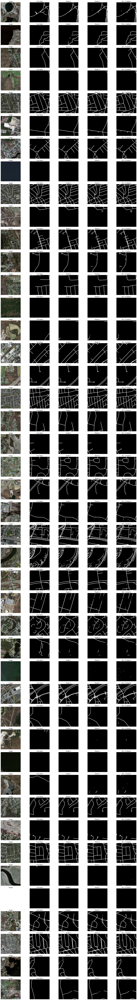

In [44]:
import torch
import random
import matplotlib.pyplot as plt


device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# instantiate & move to device
model1 = DeepResUNet().to(device)
# model2 = ResUNet_CBAM_ASPP().to(device)
model3 = NestedUNet_v2().to(device)

# load checkpoints
model1.load_state_dict(torch.load("/content/best_model.pth",        map_location=device))
# model2.load_state_dict(torch.load("/content/best_resunet_cbam_asppv2.pth", map_location=device))
model3.load_state_dict(torch.load("/content/best_v2.pth",           map_location=device))

# switch to eval
for m in (model1, model3):
    m.eval()

# visualize a few samples
visualize_model_comparison(
    models     = [model1, model3],
    dataloader = subset_val_loader,
    device     = device,
)




**Evaluation Function Overview**

This cell defines and runs an **`evaluate(...)`** function that:

1. **Feeds** each batch of validation images through the segmentation model.
2. **Thresholds** the raw probability outputs to obtain binary masks.
3. **Applies** the B-spline post-processing on each raw mask.
4. **Flattens** all ground-truth, raw, and B-spline masks into 1D arrays.
5. **Computes** five key metrics—IoU, Precision, Recall, F₁ and F₂—separately for:

   * **Raw model output**, and
   * **B-spline refined output**
     (using scikit-learn’s `jaccard_score`, `precision_score`, etc.).
6. **Prints** the final validation metrics in a clear, side-by-side summary.


In [39]:
def evaluate(model, val_loader, device, threshold=0.5, beta=2.0):
    """
    Evaluates a segmentation model on a validation set.
    Computes IoU, precision, recall, F1, and F2 for:
        - raw model output
        - B-spline refined output
    """
    model.eval()

    all_true = []
    all_raw  = []
    all_bs   = []

    with torch.no_grad():
        for imgs, masks in val_loader:
            imgs = imgs.to(device)
            masks = masks.to(device)

            out = model(imgs)
            # Unpack if model returns a tuple
            if isinstance(out, tuple):
                out = out[0]

            if out.ndim == 4 and out.shape[1] == 1:
                outputs = out.squeeze(1)
            else:
                outputs = out

            preds_raw = (outputs > threshold).float()  # [B,H,W]

            for i in range(imgs.size(0)):
                gt_mask   = masks[i].cpu().numpy().astype(int).flatten()
                raw_mask  = preds_raw[i].cpu().numpy().astype(int).flatten()

                # B-spline postprocessing
                bs = B_Spline_Output(preds_raw[i].cpu().numpy(), threshold=threshold)
                bs_mask = bs.astype(int).flatten()

                all_true.extend(gt_mask)
                all_raw.extend(raw_mask)
                all_bs.extend(bs_mask)

    from sklearn.metrics import (
        jaccard_score, precision_score,
        recall_score, f1_score, fbeta_score
    )

    metrics_raw = {
        'IoU':      jaccard_score(all_true, all_raw),
        'Precision':precision_score(all_true, all_raw, zero_division=0),
        'Recall':   recall_score(all_true, all_raw, zero_division=0),
        'F1':       f1_score(all_true, all_raw, zero_division=0),
        'F2':       fbeta_score(all_true, all_raw, beta=beta, zero_division=0)
    }
    metrics_bs = {
        'IoU':      jaccard_score(all_true, all_bs),
        'Precision':precision_score(all_true, all_bs, zero_division=0),
        'Recall':   recall_score(all_true, all_bs, zero_division=0),
        'F1':       f1_score(all_true, all_bs, zero_division=0),
        'F2':       fbeta_score(all_true, all_bs, beta=beta, zero_division=0)
    }

    return {'raw': metrics_raw, 'bspline': metrics_bs}


metrics = evaluate(model3, val_loader, device)
print("=== Raw Model Output Metrics ===")
for key, value in metrics['raw'].items():
    print(f"{key.upper():<6}: {value:.4f}")

print("\n=== B-Spline Output Metrics ===")
for key, value in metrics['bspline'].items():
    print(f"{key.upper():<6}: {value:.4f}")

=== Raw Model Output Metrics ===
IOU   : 0.6078
PRECISION: 0.7695
RECALL: 0.7431
F1    : 0.7561
F2    : 0.7482

=== B-Spline Output Metrics ===
IOU   : 0.5062
PRECISION: 0.6812
RECALL: 0.6633
F1    : 0.6721
F2    : 0.6668



**Conclusion**

Although our B-spline post-processing step does succeed in bridging small gaps in the raw skeletons, the quantitative results reveal a clear drop across every metric:

* **IoU:** falls from **0.6078** to **0.5062**
* **Precision:** falls from **0.7695** to **0.6812**
* **Recall:** falls from **0.7431** to **0.6633**
* **F₁:**   falls from **0.7561** to **0.6721**
* **F₂:**   falls from **0.7482** to **0.6668**

In practice, this performance degradation arises from two competing effects:

1. **Gap-filling vs. noise amplification**
   The B-spline fitting neatly smooths over tiny breaks in true positives, improving local continuity. However, it also “carries forward” any jagged edges or spurious branches in the raw skeleton. Small perturbations become exaggerated when fitting and reconnecting curves, adding false-positive areas (hurting precision) and linking out into background clutter (hurting recall and IoU).

2. **Global rigidity vs. local correctness**
   Cubic splines impose a smoother, more globally coherent curve—but straight-line and gently curving fits can be a poor match for highly irregular or sharply turning road segments. Where the raw mask deviates significantly from a true centerline, the spline either overshoots into non-road pixels or over-smooths key junction details, widening the gap from the ground-truth strokes and driving down all overlap measures.

In summary, while B-spline fitting is powerful for closing small gaps, it also magnifies any pre-existing skeleton artifacts. Unless the raw predictions are already extremely clean, the global smoothing of B-splines can end up reducing overall accuracy.
